In [1]:
# This is the import cell
import sys
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.lines import Line2D
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from mpl_toolkits.axes_grid1.inset_locator import (inset_axes, InsetPosition,
                                                  mark_inset)
import matplotlib.ticker as ticker
from collections import OrderedDict
from scipy import stats
from PIL import Image
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import pylab as plot
first = True
pd.set_option('display.max_columns', None)
pd.set_option("display.max_rows", 10)



# Here are my rc parameters for matplotlibf
fsize = 20
mpl.rc('font', serif='Helvetica Neue')
#mpl.rc('font', serif='Times New Roman')
mpl.rcParams.update({'font.size': fsize})
mpl.rcParams['figure.figsize'] = 3.2, 2.8
mpl.rcParams['figure.dpi'] = 500
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
mpl.rcParams['lines.linewidth'] = 1.5
mpl.rcParams['axes.linewidth'] = 1.5
# Set x tick params
mpl.rcParams['xtick.major.size'] = 4.5
mpl.rcParams['xtick.major.width'] = 1.5
mpl.rcParams['xtick.minor.size'] = 3.
mpl.rcParams['xtick.minor.width'] = 1.25
# Set y tick params
mpl.rcParams['ytick.major.size'] = 4.5
mpl.rcParams['ytick.major.width'] = 1.5
mpl.rcParams['ytick.minor.size'] = 3.
mpl.rcParams['ytick.minor.width'] = 1.25
mpl.rcParams['legend.fontsize']= 20.
mpl.rcParams['mathtext.fontset'] = 'stix'
mpl.rcParams["font.family"] = "Times New Roman"
# Load LaTeX and amsmath
# mpl.rc('text', usetex=True)
# mpl.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]

In [2]:
# Get the current path
if first:
    parent = os.getcwd()
print(parent)
# Grab file names from data folder
dens = os.listdir('../../../../../../../../Volumes/EXTERNAL2/leakage_txt_final')

try:
    dens.remove('.DS_Store')
except:
    print(".DS_Store not in directory")


/Users/nicklauersdorf/klotsa/ABPs/post_proc/Jupyter
.DS_Store not in directory


In [3]:
# Some functions to get the relevant data from the filenames
def checkFile(fname, string):
    for i in range(len(fname)):
        if fname[i] == string[0]:
#             print"{} matches {}".format(fname[i], string[0])
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
#                     print"{} matches {}".format(fname[i+j], string[j])
                    if j == (len(string) - 1):
#                         print"Final match!"
                        return True
                else:
                    break
    return False
    
def txtValue(fname, string):
    out = ""
    index = 0
    for i in range(len(fname)):
        if fname[i] == string[0]:
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
                    if j == (len(string) - 1):
                        # Last index of search string
                        index = i + j
                else:
                    break
                        
    # First index of value
    index += 1
    mybool = True
    while mybool:
        if fname[index].isdigit():
            out = out + fname[index]
            index += 1
        elif fname[index] == ".":    
            if fname[index+1].isdigit():
                out = out + fname[index]
                index += 1
            else:
                mybool = False
        else:
            mybool = False
    return float(out)

# Sorting functions
def multiSort(arr1, arr2, arr3, arr4):
    """Sort an array the slow (but certain) way, returns original indices in sorted order"""
    # Doing this for PeR, PeS, xS in this case
    cpy1 = np.copy(arr1)
    cpy2 = np.copy(arr2)
    cpy3 = np.copy(arr3)
    cpy4 = np.copy(arr4)
    ind = np.arange(0, len(arr1))
    for i in range(len(cpy1)):
        for j in range(len(cpy1)):
            # Sort by first variable
            if cpy1[i] > cpy1[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            # If first variable is equal, resort to second variable
            elif cpy1[i] == cpy1[j] and cpy2[i] > cpy2[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] > cpy3[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] == cpy3[j] and cpy4[i] > cpy4[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
    return ind

def indSort(arr1, arr2):
    """Take sorted index array, use to sort array"""
    # arr1 is array to sort
    # arr2 is index array
    cpy = np.copy(arr1)
    for i in range(len(arr1)):
        arr1[i] = cpy[arr2[i]]

In [6]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in dens:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(dens, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_dens = []
os.chdir(parent)
os.chdir('../../../../../../../../Volumes/EXTERNAL2/leakage_txt_final')
for i in dens:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_dens.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_dens[0])

,tst,clust_size,Ngas_to_clust,Nsgas_to_clust,Nfgas_to_clust,Nclust_to_gas,Nsclust_to_gas,Nfclust_to_gas,Ngas_to_bulk,Nsgas_to_bulk,Nfgas_to_bulk,Nbulk_to_gas,Nsbulk_to_gas,Nfbulk_to_gas,Ngas_to_int,Nsgas_to_int,Nfgas_to_int,Nint_to_gas,Nsint_to_gas,Nfint_to_gas,Nbulk_to_int,Nsbulk_to_int,Nfbulk_to_int,Nint_to_bulk,Nsint_to_bulk,Nfint_to_bulk,Nbulk_to_gas2,Nsbulk_to_gas2,Nfbulk_to_gas2,Ngas2_to_bulk,Nsgas2_to_bulk,Nfgas2_to_bulk
0,0.0,40318,1898,1515,383,1538,3,1535,0,0,0,0,0,0,936,483,453,1781,25,1756,2031,1020,1011,465,242,223,0,0,0,0,0,0
1,0.3,39958,2444,1472,972,2246,21,2225,0,0,0,0,0,0,1381,393,988,2524,117,2407,3903,1965,1938,54,34,20,0,0,0,0,0,0
2,0.6,40120,3587,2065,1522,2338,20,2318,0,0,0,0,0,0,2337,851,1486,2537,92,2445,7876,3944,3932,0,0,0,0,0,0,0,0,0
3,0.9,39069,4681,2653,2028,2334,21,2313,0,0,0,0,0,0,3407,1446,1961,2419,58,2361,8235,4113,4122,0,0,0,0,0,0,0,0,0
4,1.2,37971,5759,3266,2493,2387,20,2367,0,0,0,0,0,0,4413,2064,2349,2705,208,2497,6894,3423,3471,2,0,2,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1994,598.2,21436,22830,15055,7775,4177,1210,2967,7347,4832,2515,1315,401,914,15893,10573,5320,2546,711,1835,4181,1326,2855,3767,1051,2716,1315,401,914,7347,4832,2515
1995,598.5,21665,22163,14718,7445,4318,1294,3024,7312,4845,2467,1417,417,1000,15854,10536,5318,2441,702,1739,4497,1395,3102,3703,1009,2694,1417,417,1000,7312,4845,2467
1996,598.8,22473,22260,14905,7355,4328,1267,3061,7071,4730,2341,1153,344,809,15360,10316,5044,2881,848,2033,3716,1132,2584,4280,1249,3031,1153,344,809,7071,4730,2341
1997,599.1,22386,21936,14673,7263,4416,1291,3125,7292,4849,2443,1202,348,854,15631,10485,5146,2788,809,1979,3886,1162,2724,3986,1111,2875,1202,348,854,7292,4849,2443


In [7]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params = pd.DataFrame(columns=headers)
for i in range(0, len(all_dens)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params = params.append(df, ignore_index = True)
display(params)

,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,0,400,50.0,1.0,60.0,0.000001
1,0,0,450,50.0,1.0,60.0,0.000001
2,0,0,100,50.0,1.0,60.0,0.000001
3,0,0,150,50.0,1.0,60.0,0.000001
4,0,0,300,50.0,1.0,60.0,0.000001
...,...,...,...,...,...,...,...
111,0,400,500,50.0,1.0,60.0,0.000001
112,0,400,400,50.0,1.0,60.0,0.000001
113,0,450,450,50.0,1.0,60.0,0.000001
114,0,450,500,50.0,1.0,60.0,0.000001


In [8]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_dens)):
    # Ger rid of NaN in favor of 0
    all_dens[i].fillna(0, inplace=True)

headers=list(all_dens[0])
display(all_dens[0])
print(all_dens[0][headers[1]][0])
print(all_dens[0][headers[2]][0])

,tst,clust_size,Ngas_to_clust,Nsgas_to_clust,Nfgas_to_clust,Nclust_to_gas,Nsclust_to_gas,Nfclust_to_gas,Ngas_to_bulk,Nsgas_to_bulk,Nfgas_to_bulk,Nbulk_to_gas,Nsbulk_to_gas,Nfbulk_to_gas,Ngas_to_int,Nsgas_to_int,Nfgas_to_int,Nint_to_gas,Nsint_to_gas,Nfint_to_gas,Nbulk_to_int,Nsbulk_to_int,Nfbulk_to_int,Nint_to_bulk,Nsint_to_bulk,Nfint_to_bulk,Nbulk_to_gas2,Nsbulk_to_gas2,Nfbulk_to_gas2,Ngas2_to_bulk,Nsgas2_to_bulk,Nfgas2_to_bulk
0,0.0,40318,1898,1515,383,1538,3,1535,0,0,0,0,0,0,936,483,453,1781,25,1756,2031,1020,1011,465,242,223,0,0,0,0,0,0
1,0.3,39958,2444,1472,972,2246,21,2225,0,0,0,0,0,0,1381,393,988,2524,117,2407,3903,1965,1938,54,34,20,0,0,0,0,0,0
2,0.6,40120,3587,2065,1522,2338,20,2318,0,0,0,0,0,0,2337,851,1486,2537,92,2445,7876,3944,3932,0,0,0,0,0,0,0,0,0
3,0.9,39069,4681,2653,2028,2334,21,2313,0,0,0,0,0,0,3407,1446,1961,2419,58,2361,8235,4113,4122,0,0,0,0,0,0,0,0,0
4,1.2,37971,5759,3266,2493,2387,20,2367,0,0,0,0,0,0,4413,2064,2349,2705,208,2497,6894,3423,3471,2,0,2,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1994,598.2,21436,22830,15055,7775,4177,1210,2967,7347,4832,2515,1315,401,914,15893,10573,5320,2546,711,1835,4181,1326,2855,3767,1051,2716,1315,401,914,7347,4832,2515
1995,598.5,21665,22163,14718,7445,4318,1294,3024,7312,4845,2467,1417,417,1000,15854,10536,5318,2441,702,1739,4497,1395,3102,3703,1009,2694,1417,417,1000,7312,4845,2467
1996,598.8,22473,22260,14905,7355,4328,1267,3061,7071,4730,2341,1153,344,809,15360,10316,5044,2881,848,2033,3716,1132,2584,4280,1249,3031,1153,344,809,7071,4730,2341
1997,599.1,22386,21936,14673,7263,4416,1291,3125,7292,4849,2443,1202,348,854,15631,10485,5146,2788,809,1979,3886,1162,2724,3986,1111,2875,1202,348,854,7292,4849,2443


40318
1898


In [9]:
# All data is loaded, now compute analytical aspects
r_cut = (2.**(1./6.))

# Get lattice spacing for particle size
def ljForce(r, eps, sigma=1.):
    div = (sigma/r)
    dU = (24. * eps / sigma) * ((2*(div**13)) - (div)**7)
    return dU

# # Lennard-Jones pressure
# def ljPress(r, eps, sigma=1.):
#     phiCP = np.pi / (2. * np.sqrt(3.))
#     div = (sigma/r)
#     dU = (24. * eps / r) * ((2.*(div**12.)) - (div)**6.)
#     # This is just pressure divided by the area of a particle
# #     return (12. * dU / (np.pi * r))
#     return (12. * dU / (np.pi * r * phiCP))

def ljPress(r, pe, eps, sigma=1.):
    phiCP = np.pi / (2. * np.sqrt(3.))
    # This is off by a factor of 1.2...
    ljF = avgCollisionForce(pe)
    return (2. *np.sqrt(3) * ljF / r)
    
def avgCollisionForce(pe, power=1.):
    '''Computed from the integral of possible angles'''
    peCritical = 40.
    if pe < peCritical:
        pe = 0
    else:
        pe -= peCritical
    magnitude = 6.
    # A vector sum of the six nearest neighbors
    magnitude = np.sqrt(28)
#     return (magnitude * (pe**power)) / (np.pi)
#     return (pe * (1. + (8./(np.pi**2.))))
    coeff = 1.92#2.03#3.5#2.03
    #coeff= 0.4053
    return (pe * coeff)

def fStar(pe, epsilon, sigma=1.):
    out = (avgCollisionForce(pe) * sigma) / (24.*epsilon)
    return out
    
def conForRClust(pe, eps):
    out = []
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while ljForce(r, eps) < avgCollisionForce(pe):
            r -= j
        r += j
    out = r
    return out

def nonDimFLJ(r, sigma=1.):
    div = (sigma/r)
    dU = ((2*(div**13)) - (div)**7)
    return dU

def latForFStar(fstar):
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while nonDimFLJ(r) < fstar:
            r -= j
        r += j
    out = r
    return out
    
def latToPhi(latIn):
    '''Read in lattice spacing, output phi'''
    phiCP = np.pi / (2. * np.sqrt(3.))
    return phiCP / (latIn**2)

# From area fraction, get lattice spacing
def phiToLat(phiIn):
    '''Read in phi, output the lattice spacing'''
    phiCP = np.pi / (2. * np.sqrt(3.))
    latCP = 1.
    return np.sqrt(phiCP / phiIn)
    
def compPhiG(pe, a, kap=4.5, sig=1.):
    num = 3. * (np.pi**2) * kap * sig
    den = 4. * pe * a
    return num / den
    
def clustFrac(phi, phiG, a, sig=1.):
    phiL = latToPhi(a)
    ApL = np.pi * (sig**2) / 4.
    Ap = np.pi * (sig**2) / 4.
    num = (phiL*phiG) - (phiL*phi)
    den = (phi*phiG) - (phi*phiL)
    ans = num / den
    return ans

def radCurve(area):
    # From area of circle get curvature
    return np.sqrt(area/np.pi)

def radCirc(circ):
    return circ / (2. * np.pi)

In [10]:



def compPeNet(xf, pes, pef):
    "Given each species activity (pes and pef) and particle fraction (xf), compute net activity (peNet)"
    peNet = (pes * (1.-xf)) + (pef * xf)
    return peNet
def avgCollisionForce(peNet):
    '''Computed from the integral of possible angles'''
    # A vector sum of the six nearest neighbors
    magnitude = np.sqrt(28)
    return (magnitude * peNet) / (np.pi)  
def ljForce(r, eps, sigma=1.):
    '''Compute the Lennard-Jones force'''
    div = (sigma/r)
    dU = (24. * eps / r) * ((2*(div**12)) - (div)**6)
    return dU

# Lennard-Jones pressure
def ljPress(r, pe, eps, sigma=1.):
    '''
    Purpose: Take epsilon (magnitude of lennard-jones force), sigma (particle diameter),
    activity (pe), and separation distance (r) of 2 particles to compute pressure from
    avg compressive active forces from neighbors
    
    Inputs: 
        r: Separation distance in simulation units
        epsilon: magnitude of lennard-jones potential
        pe: activity (peclet number)
        sigma: particle diameter (default=1.0)
    
    Output: Analytical virial pressure (see monodisperse paper for derivation)
    '''
    #Area fraction at HCP
    phiCP = np.pi / (2. * np.sqrt(3.))
    
    # LJ force
    ljF = avgCollisionForce(pe)
    
    return (2. *np.sqrt(3) * ljF / r)

def getLat(peNet, eps):
    '''Get the lattice spacing for any pe'''
    if peNet == 0:
        return 2.**(1./6.)
    out = []
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while ljForce(r, eps) < avgCollisionForce(peNet):
            r -= j
        r += j
    return r  
def latToPhi(latIn):
    '''Read in lattice spacing, output phi'''
    phiCP = np.pi / (2. * np.sqrt(3.))
    return phiCP / (latIn**2)

#Calculate gas phase area fraction
def compPhiG(pe, a, kap=4.5, sig=1.):
    '''
    Purpose: Compute analytical area fraction of the gas phase at steady state
    given activity and lattice spacing
    
    Inputs: 
        pe: net activity (peclet number)
        a: lattice spacing 
        kap: fitting parameter (default=4.5, shown by Redner)
        sig: particle diameter (default=1.0)
    
    Output: Area fraction of the gas phase at steady state
    '''
    num = 3. * (np.pi**2) * kap * sig
    den = 4. * pe * a
    if den>0:
        return num / den
    else:
        return 0
# Calculate dense phase area fraction from lattice spacing
def latToPhi(latIn):
    '''
    Purpose: Compute analytical area fraction of the dense phase given the lattice
    spacing.
    
    Inputs: 
        latIn: lattice spacing
    
    Output: dense phase area fraction
    '''
    phiCP = np.pi / (2. * np.sqrt(3.))
    return phiCP / (latIn**2)
def areaType(Nx, latx):
    Ax = Nx * np.pi * 0.25 * (latx**2)
    return Ax

150
400


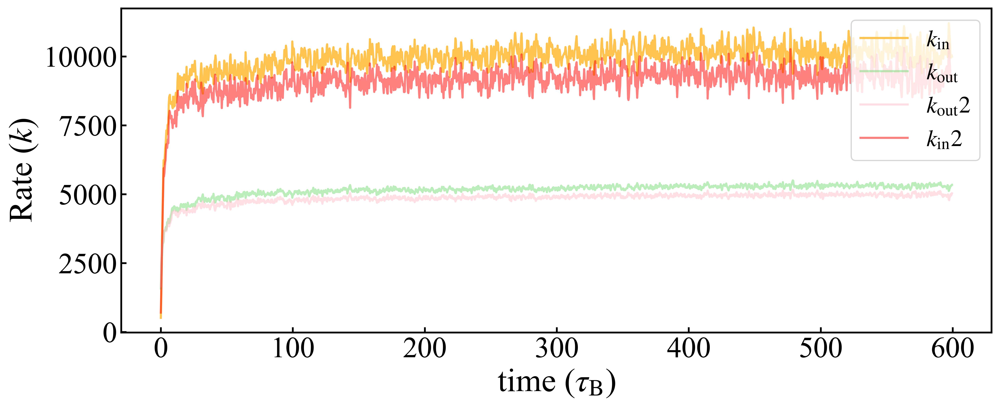

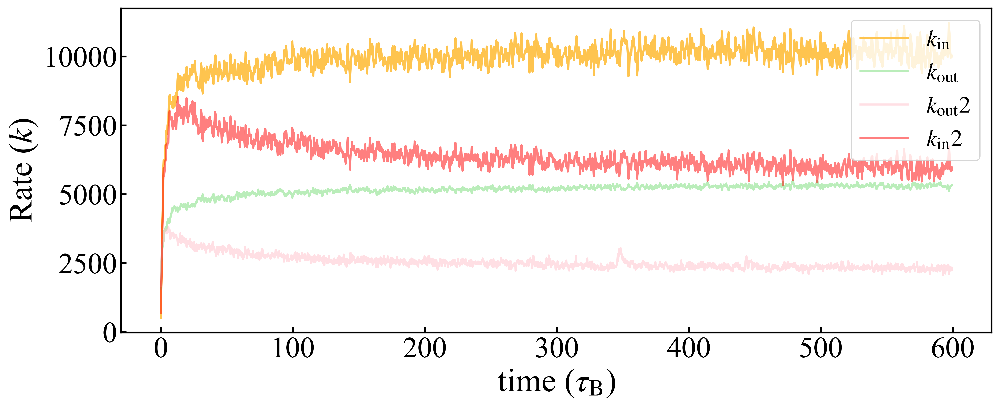

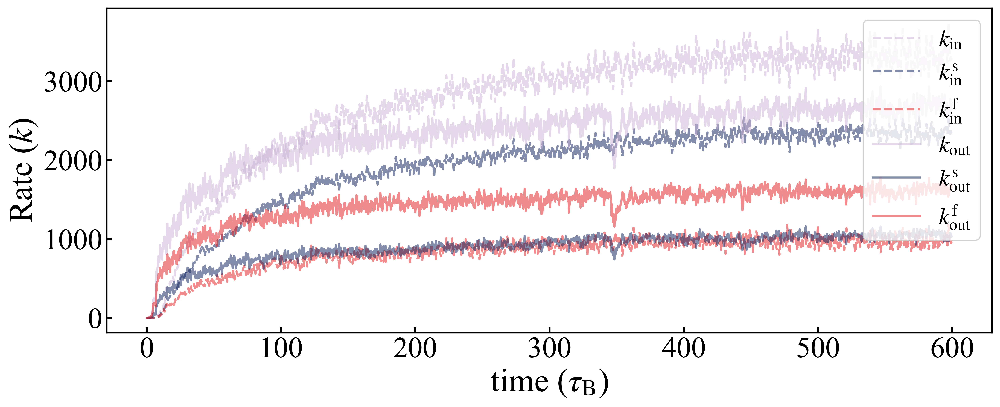

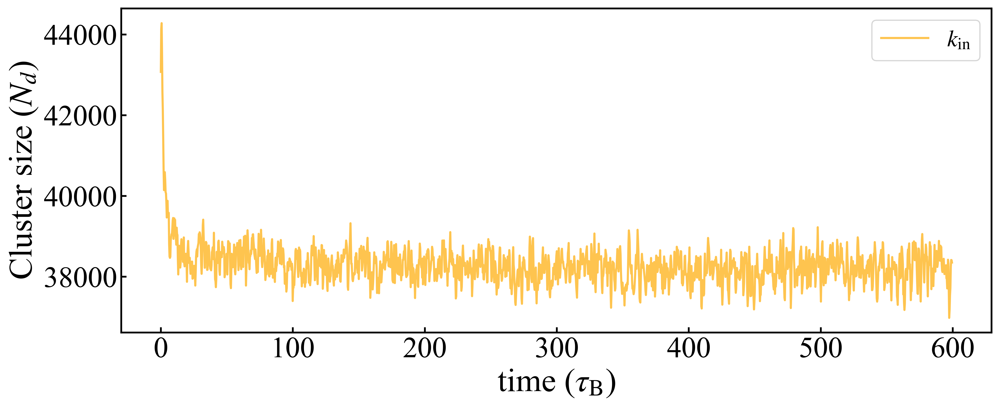

NameError: name 'stop' is not defined

In [16]:
align_peA=np.array([])
align_peB=np.array([])
align_peNet=np.array([])
first_align_peNet=np.array([])
first_interpart_peNet=np.array([])
first_interpart_peA=np.array([])
first_interpart_peB=np.array([])

align_xA=np.array([])
align_eps=np.array([])
align_pnum=np.array([])
align_phi=np.array([])
align_press_arr = np.array([])
first_align_press = np.array([])
first_bulk_press = np.array([])
first_align_peA=np.array([])
first_align_peB=np.array([])

width_peA=np.array([])
width_peB=np.array([])
width_peNet=np.array([])
width_xA=np.array([])
width_eps=np.array([])
width_pnum=np.array([])
width_phi=np.array([])

interpart_peA=np.array([])
interpart_peB=np.array([])
interpart_peNet=np.array([])
interpart_xA=np.array([])
interpart_eps=np.array([])
interpart_pnum=np.array([])
interpart_phi=np.array([])
interpart_press=np.array([])
interpart_press_expand=np.array([])
avg_shear=np.array([])
fastCol = '#e31a1c'
slowCol = '#081d58'

avg_rad = np.array([])
avg_width = np.array([])
avg_clust = np.array([])
avg_circularity = np.array([])

bulk_lat_time_mean = np.array([])
int_lat_time_mean = np.array([])
all_lat_time_mean = np.array([])
bulk_lat_time_std = np.array([])
int_lat_time_std = np.array([])
all_lat_time_std = np.array([])


avg_bulk_nA = np.array([])
avg_bulk_nB = np.array([])
avg_bulk_n = np.array([])
avg_dense_nA = np.array([])
avg_dense_nB = np.array([])
avg_dense_n = np.array([])
avg_int_n = np.array([])
avg_int_nA = np.array([])
avg_int_nB = np.array([])
avg_gas_nA = np.array([])
avg_gas_nB = np.array([])
avg_gas_n = np.array([])

align_type = np.array([])
interpart_type = np.array([])

width_type = np.array([])

avg_int_theory_arr = np.array([])
avg_bulk_theory_arr = np.array([])
def ljForce(r, eps, sigma=1.):
    div = (sigma/r)
    dU = (24. * eps / sigma) * ((2*(div**13)) - (div)**7)
    return dU

def avgCollisionForce(pe, power=1.):
    '''Computed from the integral of possible angles'''
    peCritical = 40.
    if pe < peCritical:
        pe = 0
    else:
        pe -= peCritical
    magnitude = 6.
    # A vector sum of the six nearest neighbors
    magnitude = np.sqrt(28)
#     return (magnitude * (pe**power)) / (np.pi)
#     return (pe * (1. + (8./(np.pi**2.))))
    coeff = 1.92#3.0#1.92#2.03#3.5#2.03
    #coeff= 0.4053
    return (pe * coeff)

def conForRClust(pe, eps):
    out = []
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while ljForce(r, eps) < avgCollisionForce(pe):
            r -= j
        r += j
    out = r
    return out
def densProbability(r, activity_net, activity_slow):
    "Using similar triangles to find sides"
    gas_dense_dif_phi = 0.866 * np.log10(activity_net - 46.993) - 0.443
    rate_decay = -6.151 * np.log10(activity_net-49.921) - 4.392
    mid_point = 0.044 * np.log10(activity_slow-49.893) + 0.836
    gas_phi = -0.26 * np.log10(activity_slow-41.742)+0.783
    
    num_dens_r = ((gas_dense_dif_phi / (1+np.exp(-rate_decay * (r-mid_point)))) + gas_phi)
    
    return num_dens_r

def alignProbability(r, activity_net, activity_slow):
    "Using similar triangles to find sides"
    max_align = 0.2019 * np.log10(activity_net - 41.2803) - 0.1885
    mid_point = 0.0492 * np.log10(activity_slow - 47.0061) + 0.8220
    std_dev = 0.1057
    align_r = max_align * np.exp(-(r-mid_point)**2/(2*std_dev**2))
    
    return align_r


mean_gas_fast_frac = np.array([])
mean_int_fast_frac = np.array([])
mean_bulk_fast_frac = np.array([])
mean_dense_fast_frac = np.array([])
slow_act = np.array([])
fast_act = np.array([])
int_act = np.array([])
gas_act = np.array([])
bulk_act = np.array([])
dense_act = np.array([])


avg_bulk_nA = np.array([])
avg_bulk_n = np.array([])
avg_bulk_nB = np.array([])


avg_int_n = np.array([])
avg_int_nA = np.array([])
avg_int_nB = np.array([])

avg_gas_n = np.array([])
avg_gas_nA = np.array([])
avg_gas_nB = np.array([])

avg_dense_nA = np.array([])
avg_dense_n = np.array([])
avg_dense_nB = np.array([])
            
yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
for q in range(0, len(all_dens)):
    if (params['peA'][q]>=150) & (params['peB'][q]>=400):
        if all_dens[q].empty:
            continue
        print(params['peA'][q])
        print(params['peB'][q])

        time_q = all_dens[q]['tst']
        clust_size_arr = all_dens[q]['clust_size']

        Nnot_to_clust_arr = all_dens[q]['Ngas_to_clust']
        Nsnot_to_clust_arr = all_dens[q]['Nsgas_to_clust']
        Nfnot_to_clust_arr = all_dens[q]['Nfgas_to_clust']

        Nclust_to_gas_arr = all_dens[q]['Nclust_to_gas']
        Nsclust_to_gas_arr = all_dens[q]['Nsclust_to_gas']
        Nfclust_to_gas_arr = all_dens[q]['Nfclust_to_gas']

        Ngas_to_bulk_arr = all_dens[q]['Ngas_to_bulk']
        Nsgas_to_bulk_arr = all_dens[q]['Nsgas_to_bulk']
        Nfgas_to_bulk_arr = all_dens[q]['Nfgas_to_bulk']

        Nbulk_to_gas_arr = all_dens[q]['Nbulk_to_gas']
        Nsbulk_to_gas_arr = all_dens[q]['Nsbulk_to_gas']
        Nfbulk_to_gas_arr = all_dens[q]['Nfbulk_to_gas']

        Ngas_to_int_arr = all_dens[q]['Ngas_to_int']
        Nsgas_to_int_arr = all_dens[q]['Nsgas_to_int']
        Nfgas_to_int_arr = all_dens[q]['Nfgas_to_int']

        Nint_to_gas_arr = all_dens[q]['Nint_to_gas']
        Nsint_to_gas_arr = all_dens[q]['Nsint_to_gas']
        Nfint_to_gas_arr = all_dens[q]['Nfint_to_gas']

        Nbulk_to_int_arr = all_dens[q]['Nbulk_to_int']
        Nsbulk_to_int_arr = all_dens[q]['Nsbulk_to_int']
        Nfbulk_to_int_arr = all_dens[q]['Nfbulk_to_int']

        Nint_to_bulk_arr = all_dens[q]['Nint_to_bulk']
        Nsint_to_bulk_arr = all_dens[q]['Nsint_to_bulk']
        Nfint_to_bulk_arr = all_dens[q]['Nfint_to_bulk']

        fsize=10
        mpl.rcParams.update({'font.size': 13})
        mkSz = [0.1, 0.1, 0.15, 0.1, 0.1]
        msz=40
        yellow = ("#fec44f")
        green = ("#77dd77")
        red = ("#ff6961")
        
        fig, ax1 = plt.subplots(figsize=(12,5))

        plot_max = 1.0

        plot_min = 0.0


        plt.plot(time_q, Nnot_to_clust_arr,
                       c=yellow, lw=1.8, ls='-', label=r'$k_\mathrm{in}$')
        plt.plot(time_q, Nclust_to_gas_arr,
                       c=green, lw=1.8, ls='-', label=r'$k_\mathrm{out}$', alpha=0.5)
        plt.plot(time_q, Nint_to_gas_arr + Nbulk_to_gas_arr,
                       c='pink', lw=1.8, ls='-', label=r'$k_\mathrm{out} 2$', alpha=0.5)
        plt.plot(time_q, Ngas_to_int_arr + Ngas_to_bulk_arr,
                       c='red', lw=1.8, ls='-', label=r'$k_\mathrm{in} 2$', alpha=0.5)
        
        ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



        ax1.set_ylabel(r'Rate ($k$)', fontsize=fsize*2.8)

        ax1.tick_params(axis='y', labelsize=fsize*2.5)

        plt.legend(loc='upper right', fontsize=fsize*2.0)

        ax1.tick_params(axis='x', labelsize=fsize*2.5)

        plt.tight_layout()
        #plt.savefig('/Volumes/EXTERNAL2/pe_time2/random_long_bi_pa' + str(int(params4['peA'][q])) + '_pb'+str(int(params4['peB'][q])), dpi=100)
        #plt.close()

        plt.show()

        fig, ax1 = plt.subplots(figsize=(12,5))

        plot_max = 1.0

        plot_min = 0.0


        plt.plot(time_q, Nnot_to_clust_arr,
                       c=yellow, lw=1.8, ls='-', label=r'$k_\mathrm{in}$')
        plt.plot(time_q, Nclust_to_gas_arr,
                       c=green, lw=1.8, ls='-', label=r'$k_\mathrm{out}$', alpha=0.5)
        plt.plot(time_q, Nint_to_gas_arr,
                       c='pink', lw=1.8, ls='-', label=r'$k_\mathrm{out} 2$', alpha=0.5)
        plt.plot(time_q, Ngas_to_int_arr,
                       c='red', lw=1.8, ls='-', label=r'$k_\mathrm{in} 2$', alpha=0.5)
        
        ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



        ax1.set_ylabel(r'Rate ($k$)', fontsize=fsize*2.8)

        ax1.tick_params(axis='y', labelsize=fsize*2.5)

        plt.legend(loc='upper right', fontsize=fsize*2.0)

        ax1.tick_params(axis='x', labelsize=fsize*2.5)

        plt.tight_layout()
        #plt.savefig('/Volumes/EXTERNAL2/pe_time2/random_long_bi_pa' + str(int(params4['peA'][q])) + '_pb'+str(int(params4['peB'][q])), dpi=100)
        #plt.close()

        plt.show()
        
        fig, ax1 = plt.subplots(figsize=(12,5))

        plot_max = 1.0

        plot_min = 0.0


        plt.plot(time_q, Ngas_to_bulk_arr,
                       c=purple, lw=1.8, ls='--', label=r'$k_\mathrm{in}$', alpha=0.5)
        plt.plot(time_q, Nsgas_to_bulk_arr,
                       c=slowCol, lw=1.8, ls='--', label=r'$k_\mathrm{in}^\mathrm{s}$', alpha=0.5)
        plt.plot(time_q, Nfgas_to_bulk_arr,
                       c=fastCol, lw=1.8, ls='--', label=r'$k_\mathrm{in}^\mathrm{f}$', alpha=0.5)
        plt.plot(time_q, Nbulk_to_gas_arr,
                       c=purple, lw=1.8, ls='-', label=r'$k_\mathrm{out}$', alpha=0.5)
        plt.plot(time_q, Nsbulk_to_gas_arr,
                       c=slowCol, lw=1.8, ls='-', label=r'$k_\mathrm{out}^\mathrm{s}$', alpha=0.5)
        plt.plot(time_q, Nfbulk_to_gas_arr,
                       c=fastCol, lw=1.8, ls='-', label=r'$k_\mathrm{out}^\mathrm{f}$', alpha=0.5)

        ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



        ax1.set_ylabel(r'Rate ($k$)', fontsize=fsize*2.8)

        ax1.tick_params(axis='y', labelsize=fsize*2.5)

        plt.legend(loc='upper right', fontsize=fsize*2.0)

        ax1.tick_params(axis='x', labelsize=fsize*2.5)

        plt.tight_layout()
        #plt.savefig('/Volumes/EXTERNAL2/pe_time2/random_long_bi_pa' + str(int(params4['peA'][q])) + '_pb'+str(int(params4['peB'][q])), dpi=100)
        #plt.close()

        plt.show()
        
        fig, ax1 = plt.subplots(figsize=(12,5))

        plot_max = 1.0

        plot_min = 0.0


        plt.plot(time_q, clust_size_arr,
                       c=yellow, lw=1.8, ls='-', label=r'$k_\mathrm{in}$')

        ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



        ax1.set_ylabel(r'Cluster size ($N_d$)', fontsize=fsize*2.8)

        ax1.tick_params(axis='y', labelsize=fsize*2.5)

        plt.legend(loc='upper right', fontsize=fsize*2.0)

        ax1.tick_params(axis='x', labelsize=fsize*2.5)

        plt.tight_layout()
        #plt.savefig('/Volumes/EXTERNAL2/pe_time2/random_long_bi_pa' + str(int(params4['peA'][q])) + '_pb'+str(int(params4['peB'][q])), dpi=100)
        #plt.close()

        plt.show()
        stop


        nonzero_bulk = np.where(clust_size_arr>=0.95 * np.mean(clust_size_arr[int(len(clust_size_arr)/2):]))[0]

        if len(nonzero_bulk)>10:
            fastSim = '#de2d26'
            fastTheory = '#fc9272'
            slowSim = '#3182bd'
            slowTheory = '#9ecae1'


            mean_gas_fast_frac = np.append( mean_gas_fast_frac, np.mean(gas_fast_frac))
            mean_dense_fast_frac = np.append( mean_dense_fast_frac, np.mean(dense_fast_frac))
            mean_bulk_fast_frac = np.append( mean_bulk_fast_frac, np.mean(bulk_fast_frac))
            mean_int_fast_frac = np.append( mean_int_fast_frac, np.mean(int_fast_frac))
            slow_act = np.append(slow_act, params4['peA'][q])
            fast_act = np.append(fast_act, params4['peB'][q])
            int_act = np.append(int_act, np.mean((int_nA_arr/int_n_arr) * float(params4['peA'][q]) + (int_nB_arr/int_n_arr) * float(params4['peA'][q])))
            gas_act = np.append(gas_act, np.mean((gas_nA_arr/gas_n_arr) * float(params4['peA'][q]) + (gas_nB_arr/gas_n_arr) * float(params4['peA'][q])))
            bulk_act = np.append(bulk_act, np.mean((bulk_nA_arr/bulk_n_arr) * float(params4['peA'][q]) + (bulk_nB_arr/bulk_n_arr) * float(params4['peA'][q])))
            dense_act = np.append(dense_act, np.mean((dense_nA_arr/dense_n_arr) * float(params4['peA'][q]) + (dense_nB_arr/dense_n_arr) * float(params4['peA'][q])))
            #Time-average values for sufficiently long phase composition .txt files
            avg_bulk_nA = np.append(avg_bulk_nA, np.mean(bulk_nA_arr))
            avg_bulk_n = np.append(avg_bulk_n, np.mean(bulk_n_arr))
            avg_bulk_nB = np.append(avg_bulk_nB, np.mean(bulk_nB_arr))


            avg_int_n = np.append(avg_int_n, np.mean(int_n_arr))
            avg_int_nA = np.append(avg_int_nA, np.mean(int_nA_arr))
            avg_int_nB = np.append(avg_int_nB, np.mean(int_nB_arr))

            avg_gas_n = np.append(avg_gas_n, np.mean(gas_n_arr))
            avg_gas_nA = np.append(avg_gas_nA, np.mean(gas_nA_arr))
            avg_gas_nB = np.append(avg_gas_nB, np.mean(gas_nB_arr))

            avg_dense_nA = np.append(avg_dense_nA, np.mean(dense_nA_arr))
            avg_dense_n = np.append(avg_dense_n, np.mean(dense_n_arr))
            avg_dense_nB = np.append(avg_dense_nB, np.mean(dense_nB_arr))




[]
[]
[]
[]
[]


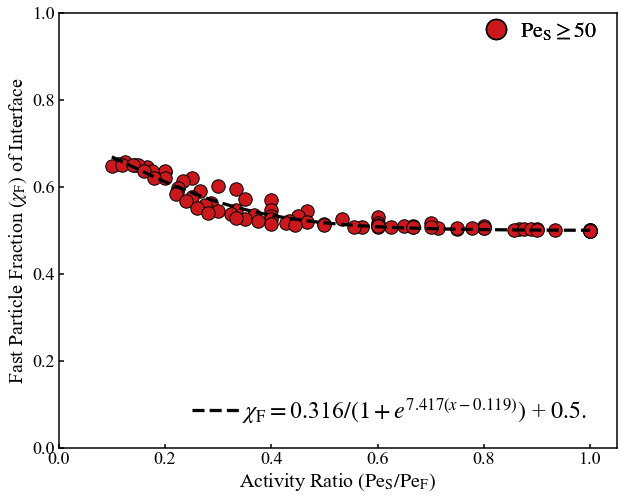

In [44]:

col0='white'
col10='#fff5f0'
col20='#fee0d2'
col30='#fcbba1'
col40='#fc9272'
col50='#fb6a4a'
col60='#ef3b2c'
col70='#cb181d'
col80='#a50f15'
col90='#67000d'
col100='gray'
#col100='#cb181d'
#col150='#a50f15'


net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 00.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=50))[0]
where_else2 = np.where((slow_act<50))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A/(1+np.exp(B*(x-C)))) + 0.5
    return y
#def Gauss4(x, A, B, C):
#    y = A*np.exp(B*(x-C)) + 0.5
#    return y

x_span = np.linspace(0.1, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_int_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 50$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Interface', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    
#plt.plot(x_span, (fit_A*np.exp(fit_B*(x_span-fit_C))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(((slow_act[where_else]/fast_act[where_else])), mean_int_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)
plt.xlim([0,1.05])

plt.ylim([0,1.0])
plt.show()

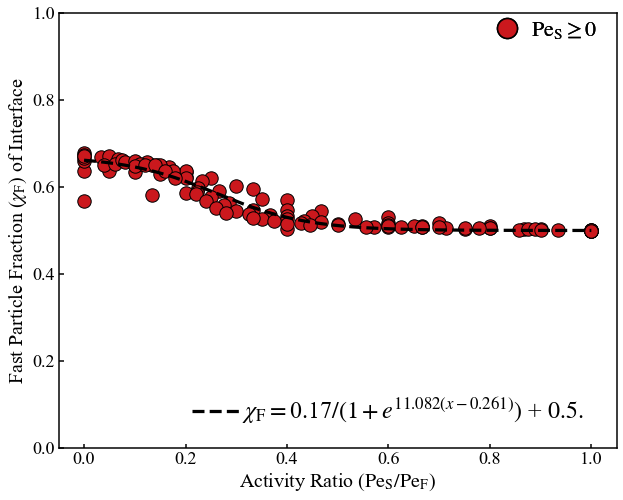

In [42]:

x_span = np.linspace(0.0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act/fast_act, mean_int_fast_frac)

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 0$', markersize=20))


fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Interface', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    
#plt.plot(x_span, (fit_A*np.exp(fit_B*(x_span-fit_C))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(((slow_act/fast_act)), mean_int_fast_frac, s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)

plt.ylim([0,1.0])
plt.show()

In [46]:
temp_id = np.where(slow_act[where_else]/fast_act[where_else]>0.4)[0]
temp_id2 = np.where((slow_act/fast_act<=0.2) & (mean_int_fast_frac<0.6))[0]

print(slow_act[where_else][temp_id])
print(fast_act[where_else][temp_id])
print(slow_act[where_else][temp_id]/fast_act[where_else][temp_id])

print(slow_act[temp_id2])
print(fast_act[temp_id2])
print(slow_act[temp_id2]/fast_act[temp_id2])
print(mean_int_fast_frac[temp_id2])

stop
print(slow_act[where_else2]/fast_act[where_else2])
fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Interface', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    
#plt.plot(x_span, (fit_A*np.exp(fit_B*(x_span-fit_C))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(((slow_act[where_else][temp_id2]/fast_act[where_else][temp_id2])), mean_int_fast_frac[where_else][temp_id2], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)

plt.ylim([0,1.0])
plt.show()




fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Interface', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    
#plt.plot(x_span, (fit_A*np.exp(fit_B*(x_span-fit_C))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(((slow_act[where_else][temp_id]/fast_act[where_else][temp_id])), mean_int_fast_frac[where_else][temp_id], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)

plt.ylim([0,1.0])
plt.show()

[ 60.  70.  70.  80.  80.  90.  90.  90. 100. 100. 120. 120. 130. 130.
 130. 140. 140. 150. 150. 150. 150. 150. 200. 200. 200. 200. 200. 250.
 250. 250. 250. 250. 300. 300. 300. 300. 350. 350. 350. 350. 400. 400.
 450. 450. 500.]
[100. 100. 150. 100. 150. 100. 200. 150. 100. 150. 200. 150. 150. 200.
 300. 150. 300. 200. 150. 250. 350. 300. 200. 300. 350. 450. 250. 350.
 500. 250. 400. 450. 400. 450. 500. 350. 500. 400. 450. 350. 400. 450.
 500. 450. 500.]
[0.6        0.7        0.46666667 0.8        0.53333333 0.9
 0.45       0.6        1.         0.66666667 0.6        0.8
 0.86666667 0.65       0.43333333 0.93333333 0.46666667 0.75
 1.         0.6        0.42857143 0.5        1.         0.66666667
 0.57142857 0.44444444 0.8        0.71428571 0.5        1.
 0.625      0.55555556 0.75       0.66666667 0.6        0.85714286
 0.7        0.875      0.77777778 1.         1.         0.88888889
 0.9        1.         1.        ]
[ 0. 20. 30.]
[150. 150. 150.]
[0.         0.13333333 0.2       

NameError: name 'stop' is not defined

[]
[]
[]
[]
[]


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/1685588958.py:86: RuntimeWarning: invalid value encountered in log10
  plt.plot(x_span, (fit_A + fit_B * np.log10(x_span - fit_C)), color='black', linestyle='dashed', linewidth=1.8*1.8)


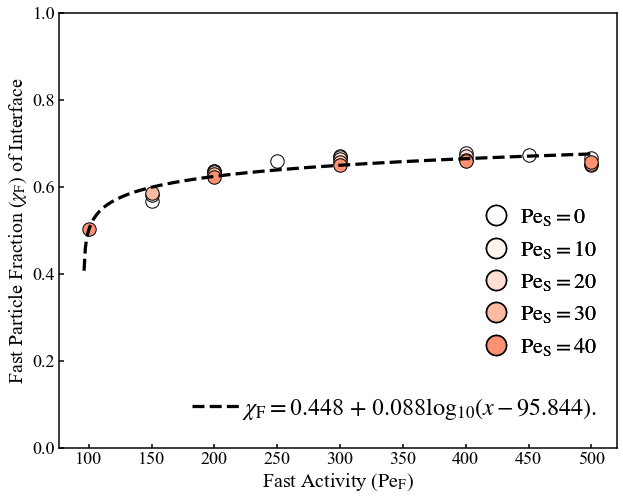

In [47]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 00.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act<=40))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A + B * np.log10(x-C))
    return y
x_span = np.linspace(0, 500, num=500)

parameters, covariance = curve_fit(Gauss4, fast_act[where_else], mean_int_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col10, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=10$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col20, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=20$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col30, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=30$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col40, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=40$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Interface', fontsize=20)
ax1.set_xlabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A + fit_B * np.log10(x_span - fit_C)), color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3)) + r' $+$ ' +str(round(fit_B,3))+r'$\mathrm{log}_{10}$' + r'$(x-{})$'.format(round(fit_C,3)) + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 0.6],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((fast_act[where_0])), mean_int_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((fast_act[where_10])), mean_int_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((fast_act[where_20])), mean_int_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((fast_act[where_30])), mean_int_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((fast_act[where_40])), mean_int_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[]
[]
[]
[]
[]


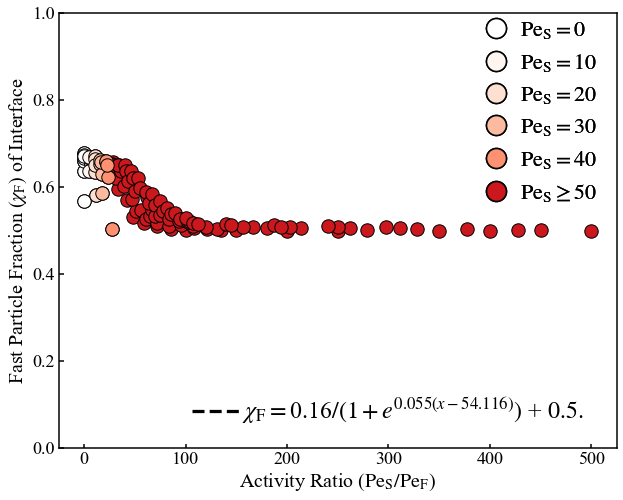

In [27]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 00.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=50) | ((slow_act>=0) & (net_activity_arr>=cut_off)))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A/(1+np.exp(B*(x-C)))) + 0.5
    return y
x_span = np.linspace(0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, (slow_act[where_else]/fast_act[where_else]) * (slow_act[where_else] * 0.5 + 0.5 * fast_act[where_else]), mean_int_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col10, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=10$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col20, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=20$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col30, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=30$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col40, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=40$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 50$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Interface', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(((slow_act[where_else]/fast_act[where_else]) * (slow_act[where_else] * 0.5 + 0.5 * fast_act[where_else])), mean_int_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act[where_0]/fast_act[where_0]) * (slow_act[where_0] * 0.5 + 0.5 * fast_act[where_0])), mean_int_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_10]/fast_act[where_10]) * (slow_act[where_10] * 0.5 + 0.5 * fast_act[where_10])), mean_int_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_20]/fast_act[where_20]) * (slow_act[where_20] * 0.5 + 0.5 * fast_act[where_20])), mean_int_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_30]/fast_act[where_30]) * (slow_act[where_30] * 0.5 + 0.5 * fast_act[where_30])), mean_int_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_40]/fast_act[where_40]) * (slow_act[where_40] * 0.5 + 0.5 * fast_act[where_40])), mean_int_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[]
[]
[]
[]
[]


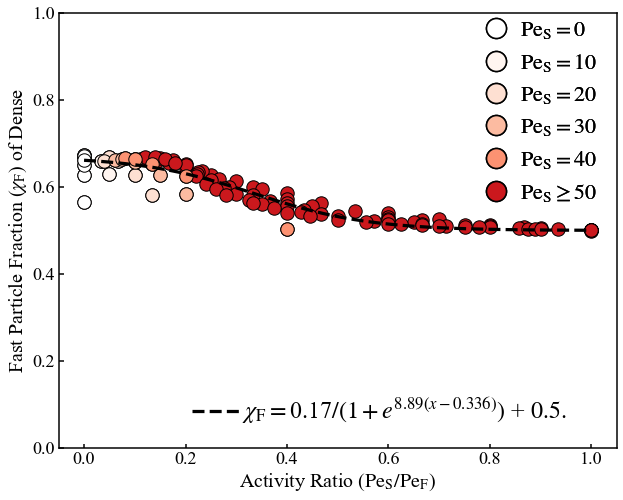

In [74]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 0.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=50) | ((slow_act>=0) & (net_activity_arr>=cut_off)))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A/(1+np.exp(B*(x-C)))) + 0.5
    return y
x_span = np.linspace(0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_dense_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col10, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=10$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col20, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=20$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col30, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=30$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col40, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=40$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 50$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Dense', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act[where_else]/fast_act[where_else])), mean_dense_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act[where_0]/fast_act[where_0])), mean_dense_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_10]/fast_act[where_10])), mean_dense_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_20]/fast_act[where_20])), mean_dense_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_30]/fast_act[where_30])), mean_dense_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_40]/fast_act[where_40])), mean_dense_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[]
[]
[]
[]
[]
[0.609056   0.62983931 0.68057707 0.66657909 0.66835689 0.576349
 0.64072604 0.64791852 0.62095336 0.59758    0.66866788 0.65056444
 0.61244799 0.6850495  0.6842652  0.67216865 0.62344914 0.59870216
 0.65841436 0.68519065 0.63492034 0.67562315 0.66104539 0.54305318]
[]
[]


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_83733/3827340506.py:35: RuntimeWarning: invalid value encountered in log10
  y = (A + B * np.log10(x-C))
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_83733/3827340506.py:91: RuntimeWarning: invalid value encountered in log10
  plt.plot(x_span, (fit_A + fit_B * np.log10(x_span - fit_C)), color='black', linestyle='dashed', linewidth=1.8*1.8)


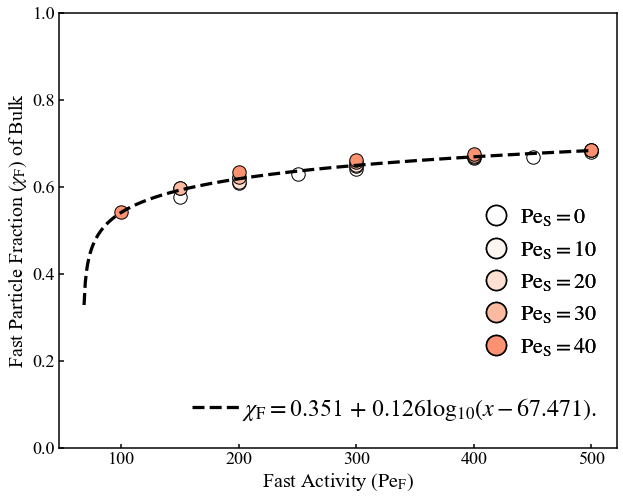

In [122]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 0.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act<=40))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A + B * np.log10(x-C))
    return y
x_span = np.linspace(0, 500, num=500)
print(mean_bulk_fast_frac[where_else])

print(slow_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])
print(fast_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])

parameters, covariance = curve_fit(Gauss4, fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col10, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=10$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col20, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=20$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col30, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=30$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col40, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=40$', markersize=20))


fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A + fit_B * np.log10(x_span - fit_C)), color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3)) + r' $+$ ' +str(round(fit_B,3))+r'$\mathrm{log}_{10}$' + r'$(x-{})$'.format(round(fit_C,3)) + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 0.6],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(((slow_act[where_else] *0.5 + 0.5 * fast_act[where_else])), mean_bulk_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act[where_0] *0.0 + fast_act[where_0])), mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_10] *0.0 + fast_act[where_10])), mean_bulk_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_20] *0.0 + fast_act[where_20])), mean_bulk_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_30] *0.0 + fast_act[where_30])), mean_bulk_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_40] *0.0 + fast_act[where_40])), mean_bulk_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_50] *0.0 + 0.5 * fast_act[where_50])), mean_bulk_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_60] *0.0 + 0.5 * fast_act[where_60])), mean_bulk_fast_frac[where_60], s=180, facecolor=col60, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[]
[]
[]
[]
[]
[0.68380361 0.6745071  0.66670049 0.68997368 0.69286653 0.6339887
 0.67821915 0.65214567 0.57250293 0.62734963 0.64705108 0.69785517
 0.68422564 0.70533957 0.54405068 0.70746041 0.70587377 0.59614169
 0.6771929  0.6340507  0.71357237 0.51337775 0.60562635 0.69948935
 0.66414506 0.56619558 0.71309954 0.5088709  0.58070466 0.68792335
 0.54546087 0.62015722 0.499857   0.66997306 0.53347873 0.68980292
 0.64658453 0.59193741 0.68362354 0.64769535 0.59806014 0.66013576
 0.53804536 0.62612299 0.51577901 0.58151037 0.50985742 0.64729856
 0.52774568 0.56656168 0.60289745 0.62809142 0.59321113 0.50499874
 0.5542019  0.51902618 0.50023604 0.57898398 0.59424182 0.53390162
 0.56291657 0.54759983 0.50082579 0.52062261 0.56153533 0.53054012
 0.55056291 0.51001483 0.5147394  0.53411438 0.5000377  0.52174855
 0.52882061 0.51110286 0.51520289 0.51971109 0.50683412 0.51093312
 0.50415576 0.50802112 0.50092865 0.4999363  0.50253876 0.50309317
 0.49969179 0.50009863]
[]
[]


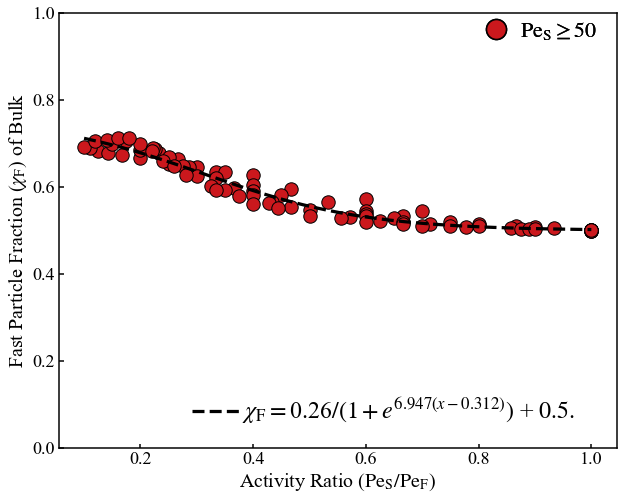

In [102]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 0.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=50) | ((slow_act>=50) & (net_activity_arr>=cut_off)))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A/(1+np.exp(B*(x-C)))) + 0.5
    return y
x_span = np.linspace(0.1, 1, num=500)
print(mean_bulk_fast_frac[where_else])

print(slow_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])
print(fast_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 50$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act[where_else]/fast_act[where_else])), mean_bulk_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(((slow_act[where_0]/fast_act[where_0])), mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_10]/fast_act[where_10])), mean_bulk_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_20]/fast_act[where_20])), mean_bulk_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_30]/fast_act[where_30])), mean_bulk_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_40]/fast_act[where_40])), mean_bulk_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[]
[]
[]
[]
[]
[0.68380361 0.6745071  0.66670049 0.68997368 0.69286653 0.6339887
 0.67821915 0.65214567 0.57250293 0.62734963 0.64705108 0.69785517
 0.68422564 0.70533957 0.54405068 0.70746041 0.70587377 0.59614169
 0.6771929  0.6340507  0.71357237 0.51337775 0.60562635 0.69948935
 0.66414506 0.56619558 0.71309954 0.5088709  0.58070466 0.68792335
 0.54546087 0.62015722 0.499857   0.66997306 0.53347873 0.68980292
 0.64658453 0.59193741 0.68362354 0.64769535 0.59806014 0.66013576
 0.53804536 0.62612299 0.51577901 0.58151037 0.50985742 0.64729856
 0.52774568 0.56656168 0.60289745 0.62809142 0.59321113 0.50499874
 0.5542019  0.51902618 0.50023604 0.57898398 0.59424182 0.53390162
 0.56291657 0.54759983 0.50082579 0.52062261 0.56153533 0.53054012
 0.55056291 0.51001483 0.5147394  0.53411438 0.5000377  0.52174855
 0.52882061 0.51110286 0.51520289 0.51971109 0.50683412 0.51093312
 0.50415576 0.50802112 0.50092865 0.4999363  0.50253876 0.50309317
 0.49969179 0.50009863]
[]
[]


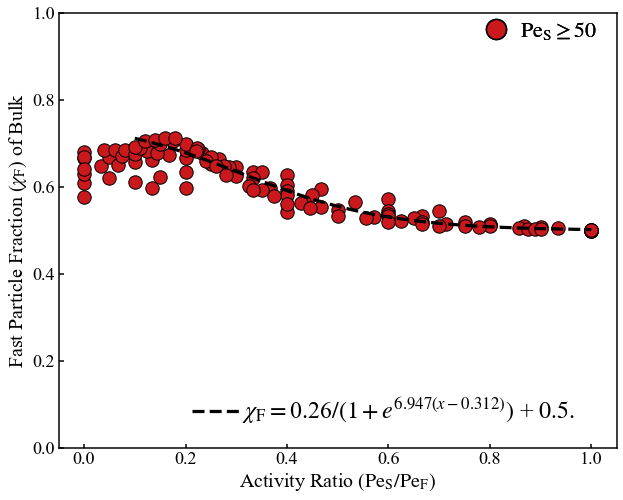

In [48]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 0.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=50) | ((slow_act>=50) & (net_activity_arr>=cut_off)))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A/(1+np.exp(B*(x-C)))) + 0.5
    return y
x_span = np.linspace(0.1, 1, num=500)
print(mean_bulk_fast_frac[where_else])

print(slow_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])
print(fast_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 50$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act/fast_act)), mean_bulk_fast_frac, s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(((slow_act[where_0]/fast_act[where_0])), mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_10]/fast_act[where_10])), mean_bulk_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_20]/fast_act[where_20])), mean_bulk_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_30]/fast_act[where_30])), mean_bulk_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_40]/fast_act[where_40])), mean_bulk_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)

plt.ylim([0,1.05])
plt.ylim([0,1.0])
plt.show()

[]
[]
[]
[]
[]
[0.609056   0.62983931 0.68057707 0.66657909 0.66835689 0.576349
 0.64072604 0.64791852 0.62095336 0.59758    0.66866788 0.65056444
 0.61244799 0.6850495  0.6842652  0.67216865 0.62344914 0.59870216
 0.65841436 0.68519065 0.63492034 0.67562315 0.66104539 0.54305318
 0.68380361 0.6745071  0.66670049 0.68997368 0.69286653 0.6339887
 0.67821915 0.65214567 0.57250293 0.62734963 0.64705108 0.69785517
 0.68422564 0.70533957 0.54405068 0.70746041 0.70587377 0.59614169
 0.6771929  0.6340507  0.71357237 0.51337775 0.60562635 0.69948935
 0.66414506 0.56619558 0.71309954 0.5088709  0.58070466 0.68792335
 0.54546087 0.62015722 0.499857   0.66997306 0.53347873 0.68980292
 0.64658453 0.59193741 0.68362354 0.64769535 0.59806014 0.66013576
 0.53804536 0.62612299 0.51577901 0.58151037 0.50985742 0.64729856
 0.52774568 0.56656168 0.60289745 0.62809142 0.59321113 0.50499874
 0.5542019  0.51902618 0.50023604 0.57898398 0.59424182 0.53390162
 0.56291657 0.54759983 0.50082579 0.52062261 0.561

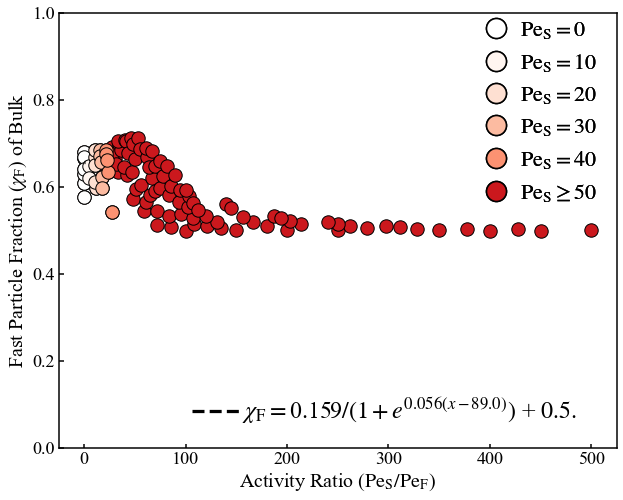

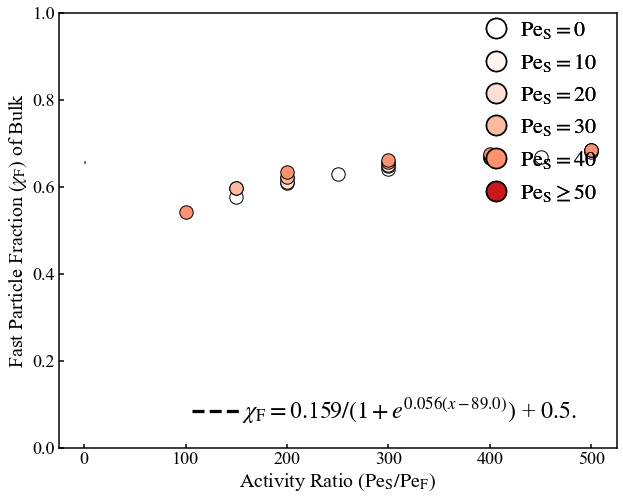

In [50]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 0.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=50) | ((slow_act>=0) & (net_activity_arr>=cut_off)))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A/(1+np.exp(B*(x-C)))) + 0.5
    return y
x_span = np.linspace(0, 1, num=500)
print(mean_bulk_fast_frac[where_else])

print(slow_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])
print(fast_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])

parameters, covariance = curve_fit(Gauss4, (slow_act[where_else]/fast_act[where_else]) * (slow_act[where_else] * 0.5 + 0.5 * fast_act[where_else]), mean_bulk_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col10, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=10$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col20, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=20$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col30, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=30$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col40, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=40$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 50$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act[where_else]/fast_act[where_else]) * (slow_act[where_else] * 0.5 + 0.5 * fast_act[where_else])), mean_bulk_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(((slow_act[where_0]/fast_act[where_0]) * (slow_act[where_0] * 0.5 + 0.5 * fast_act[where_0])), mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_10]/fast_act[where_10]) * (slow_act[where_10] * 0.5 + 0.5 * fast_act[where_10])), mean_bulk_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_20]/fast_act[where_20]) * (slow_act[where_20] * 0.5 + 0.5 * fast_act[where_20])), mean_bulk_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_30]/fast_act[where_30]) * (slow_act[where_30] * 0.5 + 0.5 * fast_act[where_30])), mean_bulk_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_40]/fast_act[where_40]) * (slow_act[where_40] * 0.5 + 0.5 * fast_act[where_40])), mean_bulk_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*


#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(((slow_act[where_else]/fast_act[where_else]) * (slow_act[where_else] * 0.5 + 0.5 * fast_act[where_else])), mean_bulk_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(fast_act[where_0] , mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_10], mean_bulk_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_20], mean_bulk_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_30], mean_bulk_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_40], mean_bulk_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[]
[]
[]
[]
[]
[0.609056   0.62983931 0.68057707 0.66657909 0.66835689 0.576349
 0.64072604 0.64791852 0.62095336 0.59758    0.66866788 0.65056444
 0.61244799 0.6850495  0.6842652  0.67216865 0.62344914 0.59870216
 0.65841436 0.68519065 0.63492034 0.67562315 0.66104539 0.54305318
 0.68380361 0.6745071  0.66670049 0.68997368 0.69286653 0.6339887
 0.67821915 0.65214567 0.57250293 0.62734963 0.64705108 0.69785517
 0.68422564 0.70533957 0.54405068 0.70746041 0.70587377 0.59614169
 0.6771929  0.6340507  0.71357237 0.51337775 0.60562635 0.69948935
 0.66414506 0.56619558 0.71309954 0.5088709  0.58070466 0.68792335
 0.54546087 0.62015722 0.499857   0.66997306 0.53347873 0.68980292
 0.64658453 0.59193741 0.68362354 0.64769535 0.59806014 0.66013576
 0.53804536 0.62612299 0.51577901 0.58151037 0.50985742 0.64729856
 0.52774568 0.56656168 0.60289745 0.62809142 0.59321113 0.50499874
 0.5542019  0.51902618 0.50023604 0.57898398 0.59424182 0.53390162
 0.56291657 0.54759983 0.50082579 0.52062261 0.561

NameError: name 'where_50' is not defined

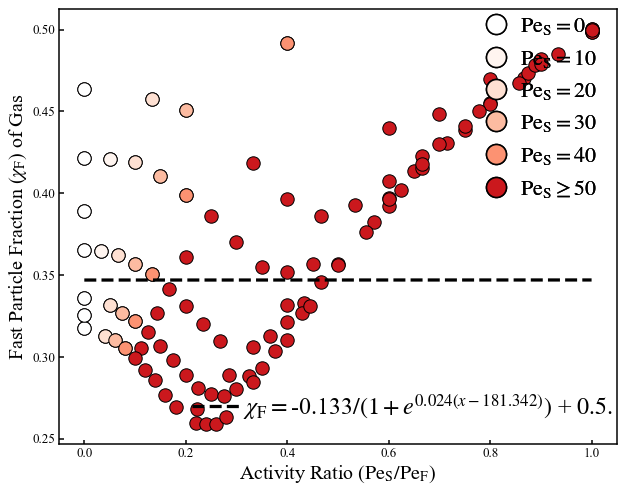

In [53]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 0.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=50) | ((slow_act>=0) & (net_activity_arr>=cut_off)))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C,D):
    y = (A/(1+np.exp(B*(x-C)))) + D
    return y

x_span = np.linspace(0, 1, num=500)
print(mean_bulk_fast_frac[where_else])

print(slow_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])
print(fast_act[np.where(np.isnan(mean_bulk_fast_frac)==1)[0]])

parameters, covariance = curve_fit(Gauss4, (slow_act[where_else]/fast_act[where_else]) * (slow_act[where_else] * 0.5 + 0.5 * fast_act[where_else]), mean_gas_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
fit_D = parameters[3]

#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col10, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=10$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col20, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=20$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col30, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=30$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col40, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=40$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 50$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Gas', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + fit_D, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*

weighted_rat = (slow_act/fast_act)

#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(weighted_rat[where_else], mean_gas_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(weighted_rat[where_0], mean_gas_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_10], mean_gas_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_20], mean_gas_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_30], mean_gas_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_40], mean_gas_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_50], mean_gas_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_60], mean_gas_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[100. 125.  75. 150.]
[155. 105.]
[ 85. 160. 110.]
[115.  90. 165.]
[120. 170.  70.]


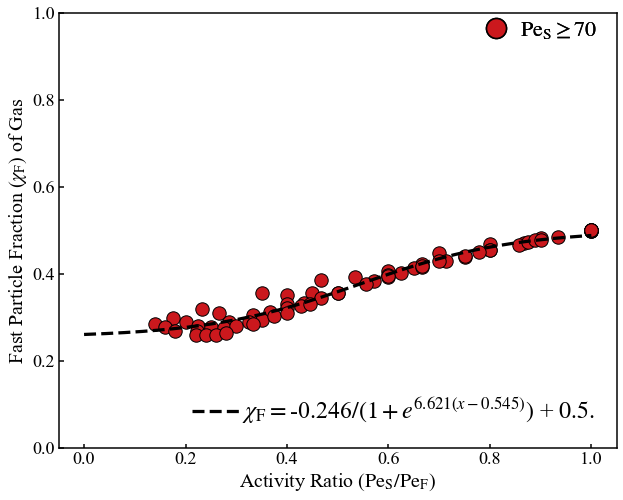

In [131]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 200.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act>=70) | ((slow_act>=70) & (net_activity_arr>=cut_off)))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A/(1+np.exp(B*(x-C)))) + 0.5
    return y

x_span = np.linspace(0, 1, num=500)


parameters, covariance = curve_fit(Gauss4, (slow_act[where_else]/fast_act[where_else]), mean_gas_fast_frac[where_else], p0=np.asarray([-1, 1.0, 0.5]))

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]

#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col70, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 70$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Gas', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A/(1+np.exp(fit_B*(x_span-fit_C)))) + 0.5, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+e^{{{}(x-{}) }}$'.format(round(fit_B,3), round(fit_C,3)) + r'$)$' + ' + ' + r'$0.5$' + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*

weighted_rat = (slow_act/fast_act)
weighted_rat2 = (slow_act * 0.5 + 0.5 * fast_act)
#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(weighted_rat[where_else], mean_gas_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(weighted_rat[where_0], mean_gas_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(weighted_rat[where_10], mean_gas_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(weighted_rat[where_20], mean_gas_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(weighted_rat[where_30], mean_gas_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(weighted_rat[where_40], mean_gas_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

[100. 125.  75. 150.]
[155. 105.]
[ 85. 160. 110.]
[115.  90. 165.]
[120. 170.  70.]


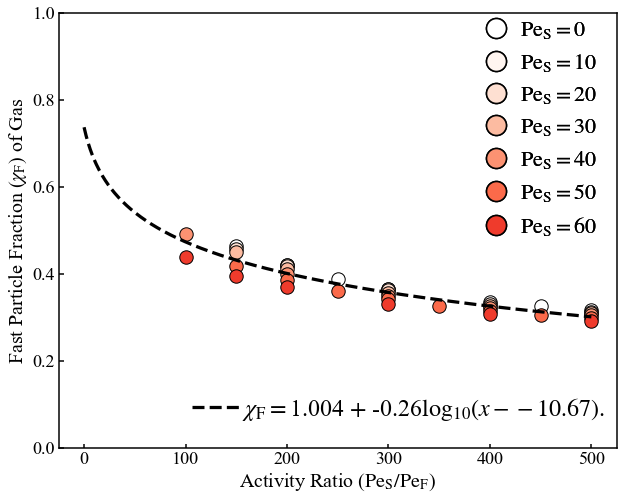

In [132]:
net_activity_arr = slow_act * 0.5 + fast_act * 0.5

cut_off = 200.0
where_0 = np.where((slow_act==0) & (net_activity_arr<cut_off))[0]
where_10 = np.where((slow_act==10) & (net_activity_arr<cut_off))[0]
where_20 = np.where((slow_act==20) & (net_activity_arr<cut_off))[0]
where_30 = np.where((slow_act==30) & (net_activity_arr<cut_off))[0]
where_40 = np.where((slow_act==40) & (net_activity_arr<cut_off))[0]

print(net_activity_arr[where_0])
print(net_activity_arr[where_10])
print(net_activity_arr[where_20])
print(net_activity_arr[where_30])
print(net_activity_arr[where_40])


where_0 = np.where((slow_act==0))[0]
where_10 = np.where((slow_act==10))[0]
where_20 = np.where((slow_act==20))[0]
where_30 = np.where((slow_act==30))[0]
where_40 = np.where((slow_act==40))[0]

where_else = np.where((slow_act<=60))[0]




from scipy.optimize import curve_fit


def Gauss4(x, A, B, C,D):
    y = D/(1+np.exp(-A*(x-B))) + C
    return y
def Gauss4(x, A, B,C):
    y = (A + B * np.log10(x-C))
    return y

x_span = np.linspace(0, 500, num=500)


parameters, covariance = curve_fit(Gauss4, (fast_act[where_else]), mean_gas_fast_frac[where_else], p0=np.asarray([-1, 1.0, 0.5]))

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]

#fit_E = parameters[4]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col10, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=10$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col20, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=20$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col30, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=30$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col40, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=40$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col50, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=50$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col60, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=60$', markersize=20))

fig, ax1 = plt.subplots(figsize=(10,8))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Gas', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)

plt.plot(x_span, (fit_A + fit_B * np.log10(x_span - fit_C)), color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3)) + r' $+$ ' +str(round(fit_B,3))+r'$\mathrm{log}_{10}$' + r'$(x-{})$'.format(round(fit_C,3)) + '.', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.2, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*

weighted_rat = (fast_act)# * 0.5 + 0.5 * slow_act)

#plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_gas_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(weighted_rat[where_else], mean_gas_fast_frac[where_else], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

plt.scatter(weighted_rat[where_0], mean_gas_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_10], mean_gas_fast_frac[where_10], s=180, facecolor=col10, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_20], mean_gas_fast_frac[where_20], s=180, facecolor=col20, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_30], mean_gas_fast_frac[where_30], s=180, facecolor=col30, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_40], mean_gas_fast_frac[where_40], s=180, facecolor=col40, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_50], mean_gas_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(weighted_rat[where_60], mean_gas_fast_frac[where_60], s=180, facecolor=col60, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(weighted_rat[where_70], mean_gas_fast_frac[where_70], s=180, facecolor=col70, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(weighted_rat[where_80], mean_gas_fast_frac[where_80], s=180, facecolor=col80, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

<ipython-input-42-6f9836f1a634>:59: RuntimeWarning: divide by zero encountered in power
  plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)


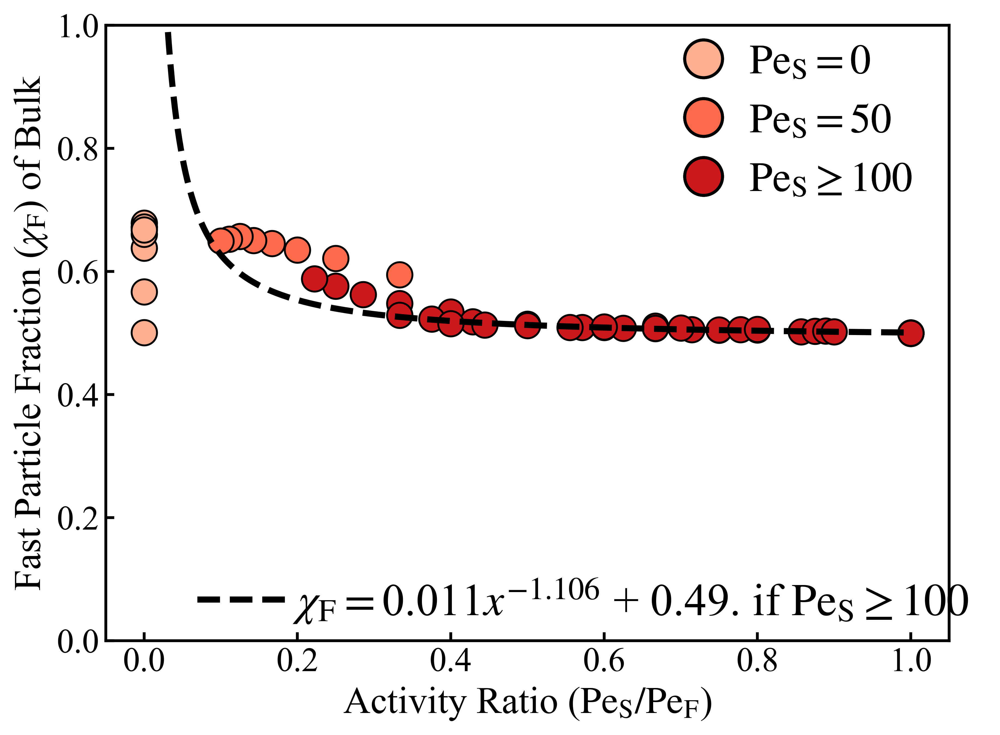

In [42]:
col0='#fcae91'
col50='#fb6a4a'
col100='#cb181d'
col150='#a50f15'
where_0 = np.where(slow_act==0)[0]

where_50 = np.where(slow_act==50)[0]
where_100 = np.where(slow_act==100)[0]
#where_100 = np.where(slow_act==100)[0]

from scipy.optimize import curve_fit


where_else = np.where(slow_act>100)[0]

def Gauss4(x, A, B, C):
    y = A*x**(-B)+C
    return y

x_span = np.linspace(0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_int_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col50, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=50$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col100, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markersize=20))

fig, ax1 = plt.subplots(figsize=(8,6))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)
plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$x^{{{}}}$'.format(round(-fit_B,3)) + ' + ' + str(round(fit_C,3)) + '. if ' + r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.06, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*

plt.scatter(((slow_act[where_0]/fast_act[where_0])), mean_int_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_int_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(((slow_act[where_100]/fast_act[where_100])), mean_int_fast_frac[where_100], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')

#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(((slow_act[where_else]/fast_act[where_else])), mean_int_fast_frac[where_else], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

<ipython-input-35-db61b2e16c91>:58: RuntimeWarning: divide by zero encountered in power
  plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)


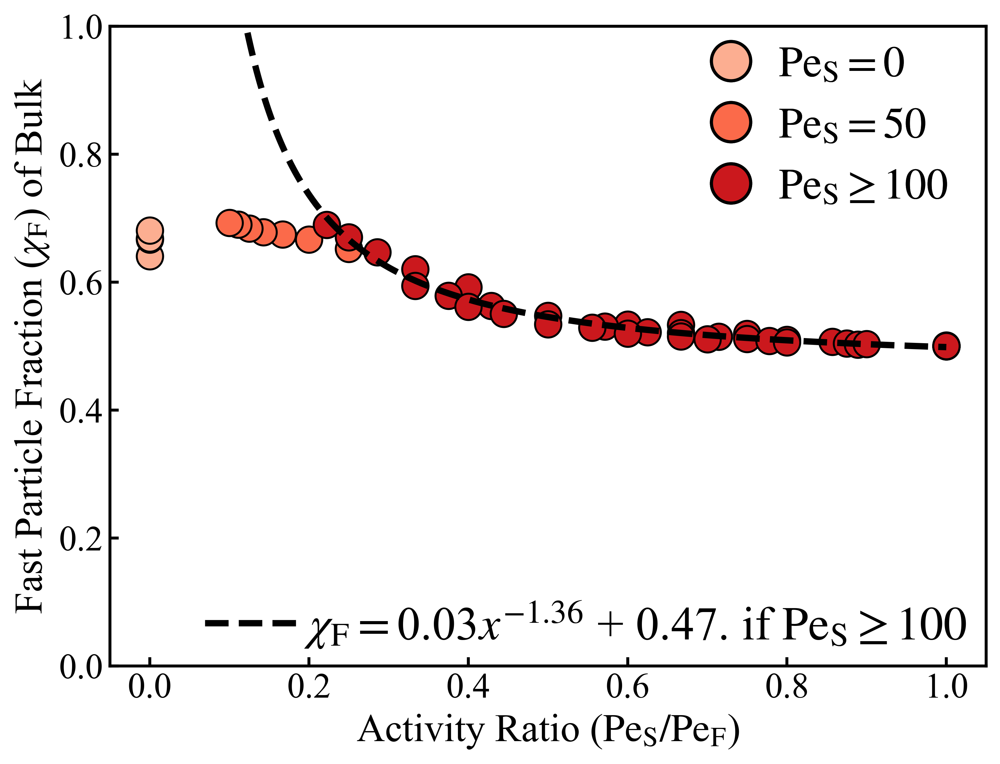

In [35]:
col0='#fcae91'
col50='#fb6a4a'
col100='#cb181d'
col150='#a50f15'
where_0 = np.where(slow_act==0)[0]

where_50 = np.where(slow_act==50)[0]
#where_100 = np.where(slow_act==100)[0]

from scipy.optimize import curve_fit


where_else = np.where(slow_act>=100)[0]

def Gauss4(x, A, B, C):
    y = A*x**(-B)+C
    return y

x_span = np.linspace(0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col50, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=50$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col100, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markersize=20))

fig, ax1 = plt.subplots(figsize=(8,6))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)
plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,2))+r'$x^{{{}}}$'.format(round(-fit_B,2)) + ' + ' + str(round(fit_C,2)) + '. if ' + r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.06, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*

plt.scatter(((slow_act[where_0]/fast_act[where_0])), mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(((slow_act[where_50]/fast_act[where_50])), mean_bulk_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(((slow_act[where_else]/fast_act[where_else])), mean_bulk_fast_frac[where_else], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()


<ipython-input-40-eb9a87e26b4d>:58: RuntimeWarning: divide by zero encountered in power
  plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)


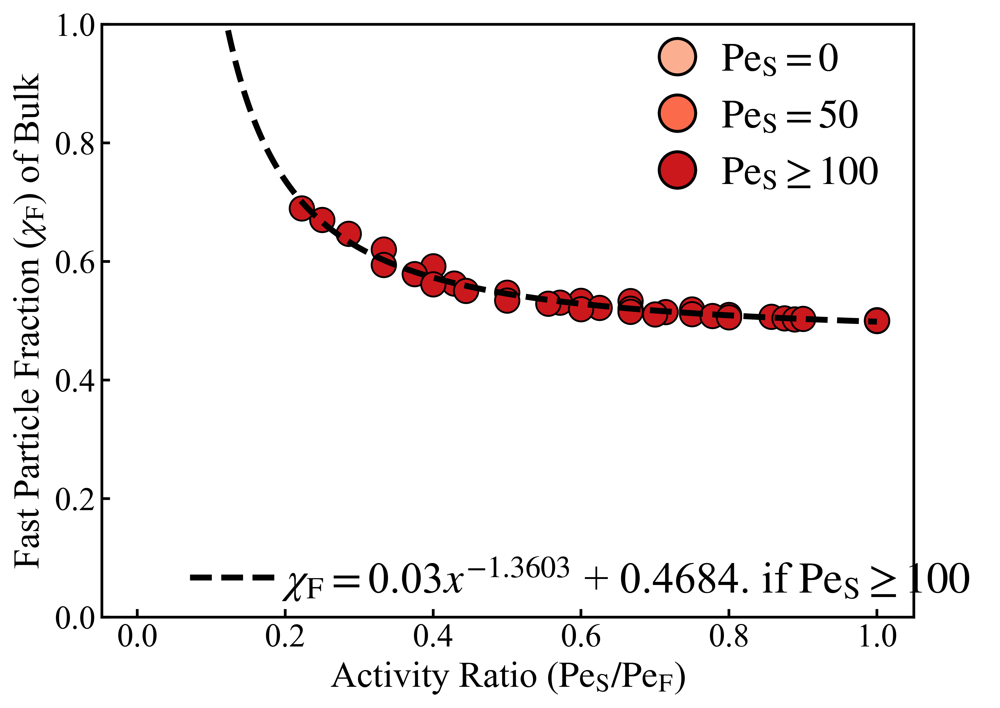

In [40]:
col0='#fcae91'
col50='#fb6a4a'
col100='#cb181d'
col150='#a50f15'
where_0 = np.where(slow_act==0)[0]

where_50 = np.where(slow_act==50)[0]
where_100 = np.where(slow_act==100)[0]

from scipy.optimize import curve_fit


where_else = np.where(slow_act>=100)[0]

def Gauss4(x, A, B, C):
    y = A*x**(-B)+C
    return y

x_span = np.linspace(0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col50, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=50$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col100, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markersize=20))

fig, ax1 = plt.subplots(figsize=(8,6))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)
plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,4))+r'$x^{{{}}}$'.format(round(-fit_B,4)) + ' + ' + str(round(fit_C,4)) + '. if ' + r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.06, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)
#((slow_act[where_else]/fast_act[where_else])**0.5)*

#plt.scatter(((slow_act[where_0])), mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
#plt.scatter(((slow_act[where_50])), mean_bulk_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(((slow_act[where_100])), mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(((slow_act[where_else]/fast_act[where_else])), mean_bulk_fast_frac[where_else], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

<ipython-input-159-6592cbdbb374>:58: RuntimeWarning: divide by zero encountered in power
  plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)


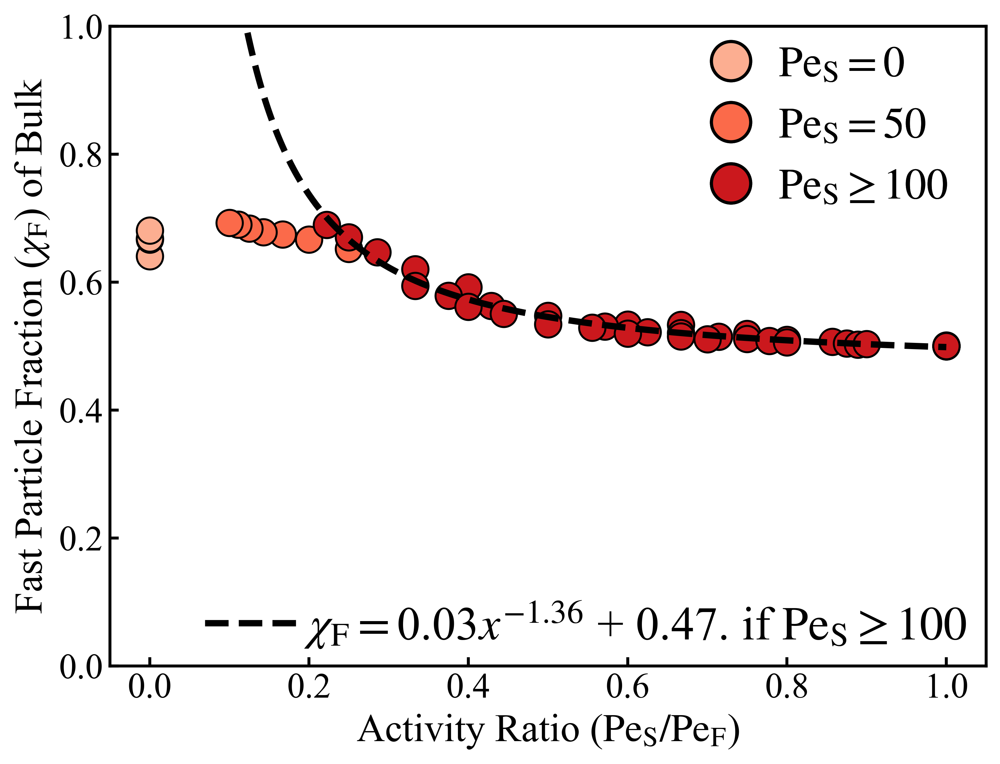

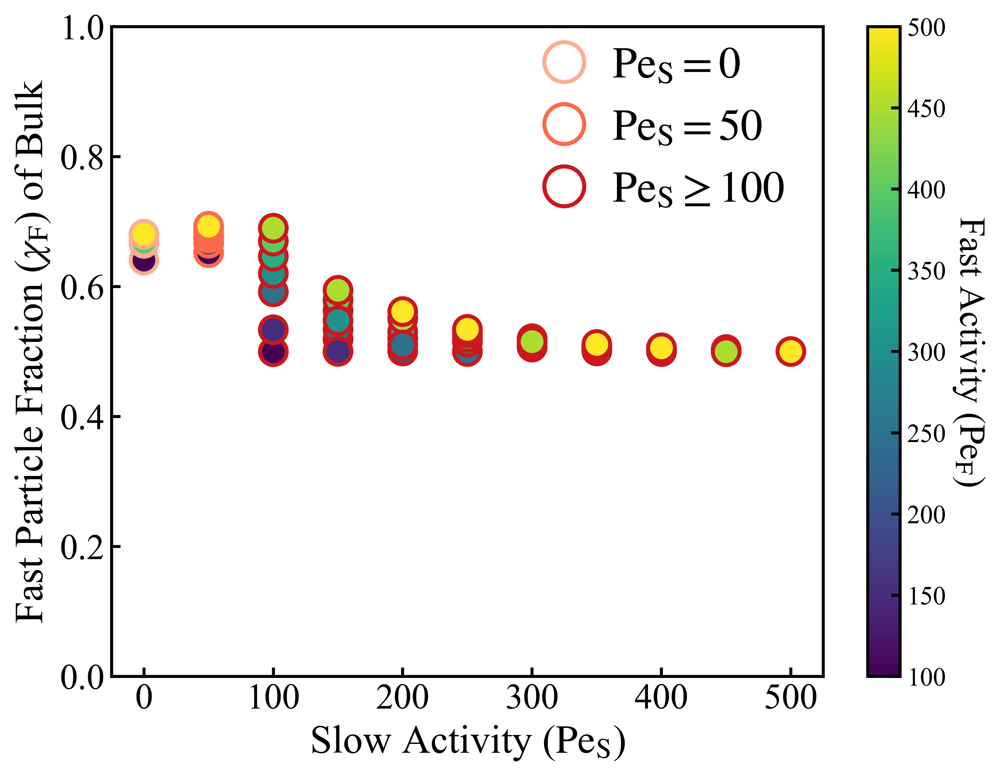

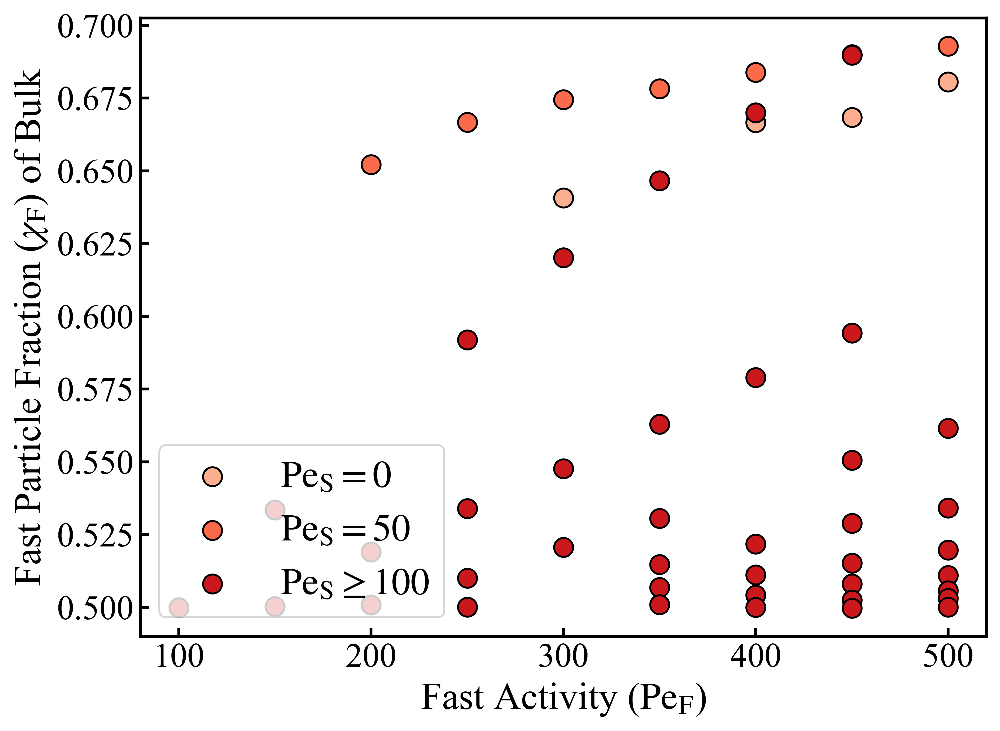

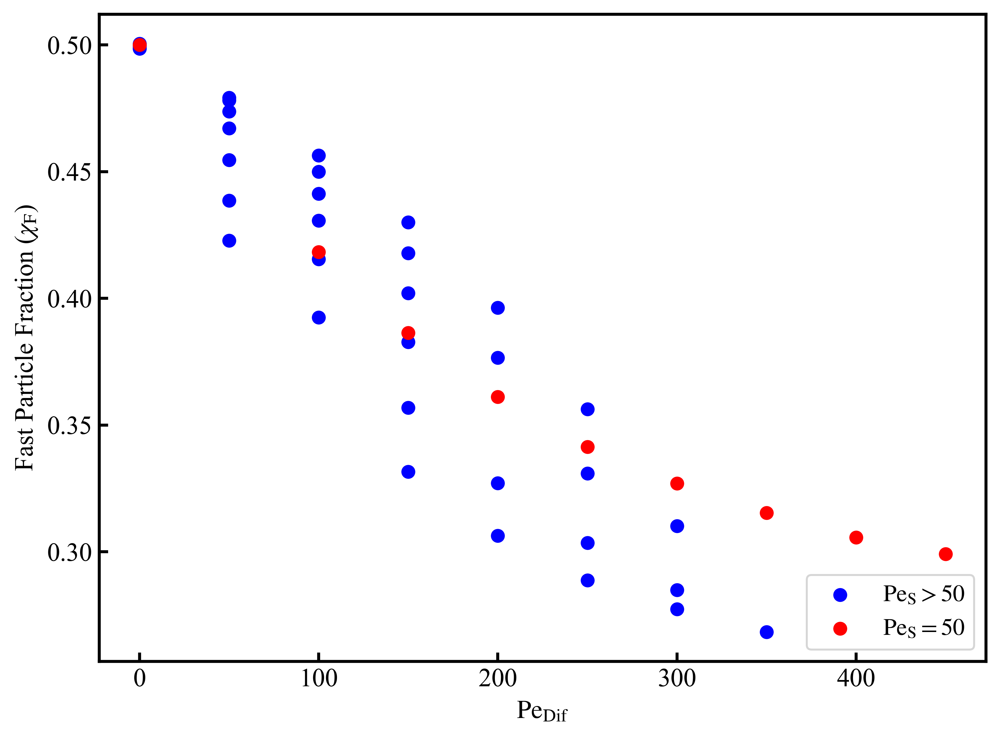

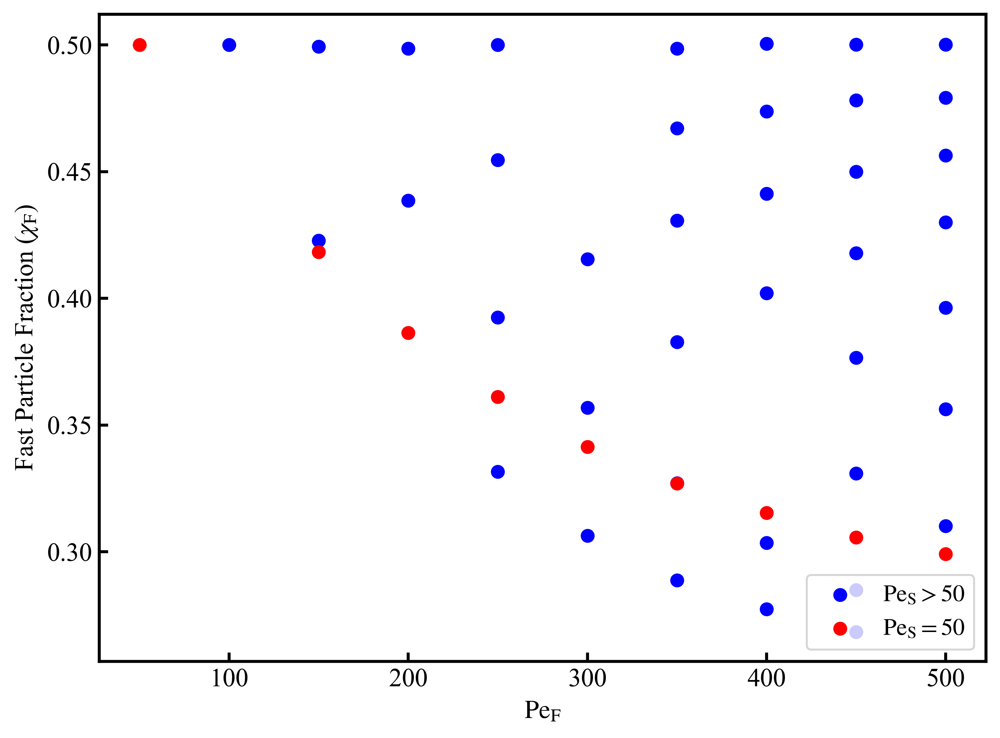

In [159]:
col0='#fcae91'
col50='#fb6a4a'
col100='#cb181d'
col150='#a50f15'
where_0 = np.where(slow_act==0)[0]

where_50 = np.where(slow_act==50)[0]
#where_100 = np.where(slow_act==100)[0]

from scipy.optimize import curve_fit


where_else = np.where(slow_act>=100)[0]

def Gauss4(x, A, B, C):
    y = A*x**(-B)+C
    return y

x_span = np.linspace(0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
'''
parameters, covariance = curve_fit(Gauss4, slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]
'''

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col0, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col50, 
                      label=r'$\mathrm{Pe}_\mathrm{S}=50$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.6,
                      markeredgecolor='black',
                      markerfacecolor=col100, 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markersize=20))

fig, ax1 = plt.subplots(figsize=(8,6))
ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=20)
#r'$10^{{{}}}$'.format(-i)
plt.plot(x_span, fit_A*x_span**(-fit_B)+fit_C, color='black', linestyle='dashed', linewidth=1.8*1.8)    

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,2))+r'$x^{{{}}}$'.format(round(-fit_B,2)) + ' + ' + str(round(fit_C,2)) + '. if ' + r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper left',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.06, 0.17],
             fontsize=fsize*2.4, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(one_leg)


plt.scatter(slow_act[where_0]/fast_act[where_0], mean_bulk_fast_frac[where_0], s=180, facecolor=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50]/fast_act[where_50], mean_bulk_fast_frac[where_50], s=180, facecolor=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_else]/fast_act[where_else], mean_bulk_fast_frac[where_else], s=180, facecolor=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$')

#plt.legend(loc='upper right', fontsize=20)
ax1.tick_params(axis='x', labelsize=18)
ax1.tick_params(axis='y', labelsize=18)


plt.ylim([0,1.0])
plt.show()

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=2.0,
                      markeredgecolor=col0,
                      markerfacecolor='none', 
                      label=r'$\mathrm{Pe}_\mathrm{S}=0$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=2.0,
                      markeredgecolor=col50,
                      markerfacecolor='none', 
                      label=r'$\mathrm{Pe}_\mathrm{S}=50$', markersize=20))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=2.0,
                      markeredgecolor=col100,
                      markerfacecolor='none', 
                      label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$', markersize=20))

fig, ax1 = plt.subplots(figsize=(8,6))
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
plt.xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{S}$)', fontsize=20)

pos1 = plt.scatter(slow_act[where_0], mean_bulk_fast_frac[where_0], linewidth=2.0, c=fast_act[where_0], s=180, cmap='viridis', edgecolor=col0, label=r'$\mathrm{Pe}_\mathrm{S}=0$')
pos2 = plt.scatter(slow_act[where_50], mean_bulk_fast_frac[where_50], linewidth=2.0, c=fast_act[where_50], s=180, cmap='viridis', edgecolor=col50, label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(slow_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')
pos3 = plt.scatter(slow_act[where_else], mean_bulk_fast_frac[where_else], linewidth=2.0, c=fast_act[where_else], s=180, cmap='viridis', edgecolor=col100, label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$')

clb = fig.colorbar(pos3, ax=ax1)
clb.set_label('Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', rotation=270, fontsize=18, labelpad=20)
one_leg = ax1.legend(handles=fast_leg, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)

ax1.add_artist(one_leg)
plt.tick_params(axis='x', labelsize=18)
plt.tick_params(axis='y', labelsize=18)
plt.ylim([0,1.0])
plt.show()


plt.figure(figsize=(8,6))
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$) of Bulk', fontsize=20)
plt.xlabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=20)

plt.scatter(fast_act[where_0], mean_bulk_fast_frac[where_0], s=100, color=col0, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50], mean_bulk_fast_frac[where_50], s=100, color=col50, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
#plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color=col100, label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_else], mean_bulk_fast_frac[where_else], s=100, color=col100, edgecolor='black', label=r'$\mathrm{Pe}_\mathrm{S}\geq 100$')

plt.legend(loc='lower left', fontsize=20)
plt.tick_params(axis='x', labelsize=18)
plt.tick_params(axis='y', labelsize=18)
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_else]-slow_act[where_else], mean_gas_fast_frac[where_else], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}>50$')
plt.scatter(fast_act[where_50]-slow_act[where_50], mean_gas_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Dif}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_else], mean_gas_fast_frac[where_else], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}>50$')
plt.scatter(fast_act[where_50], mean_gas_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{F}$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

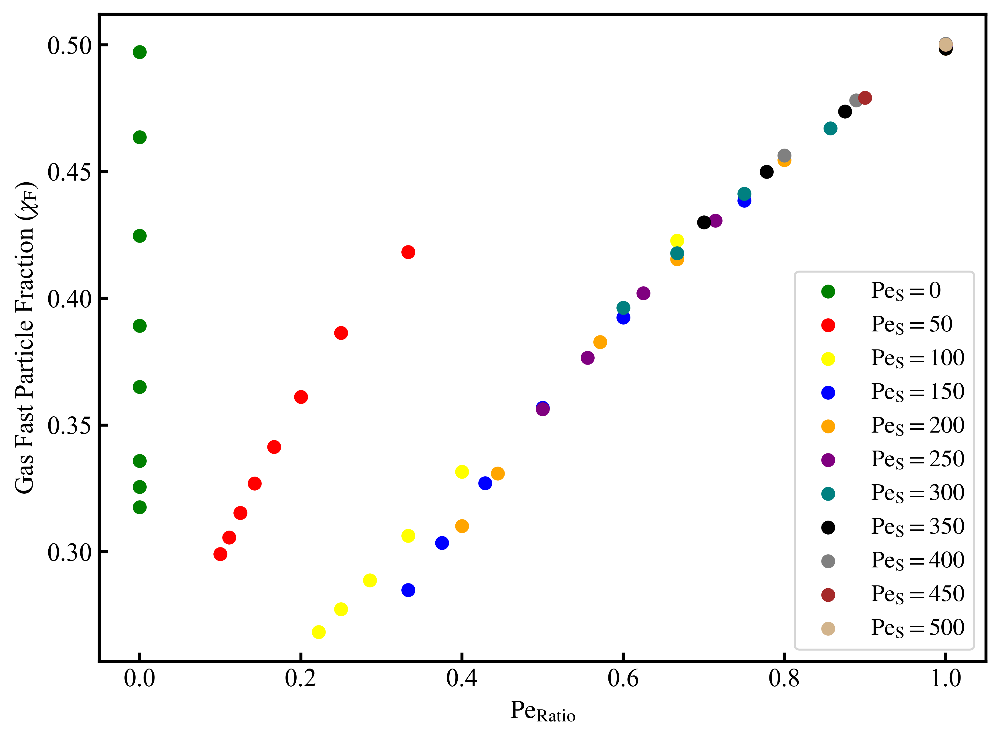

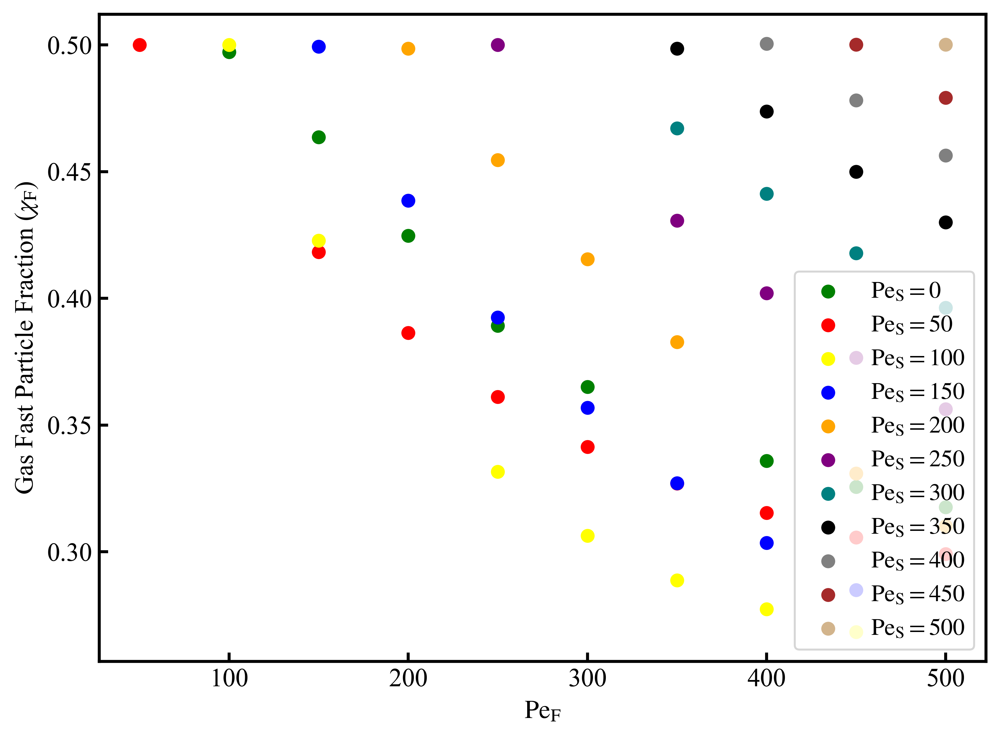

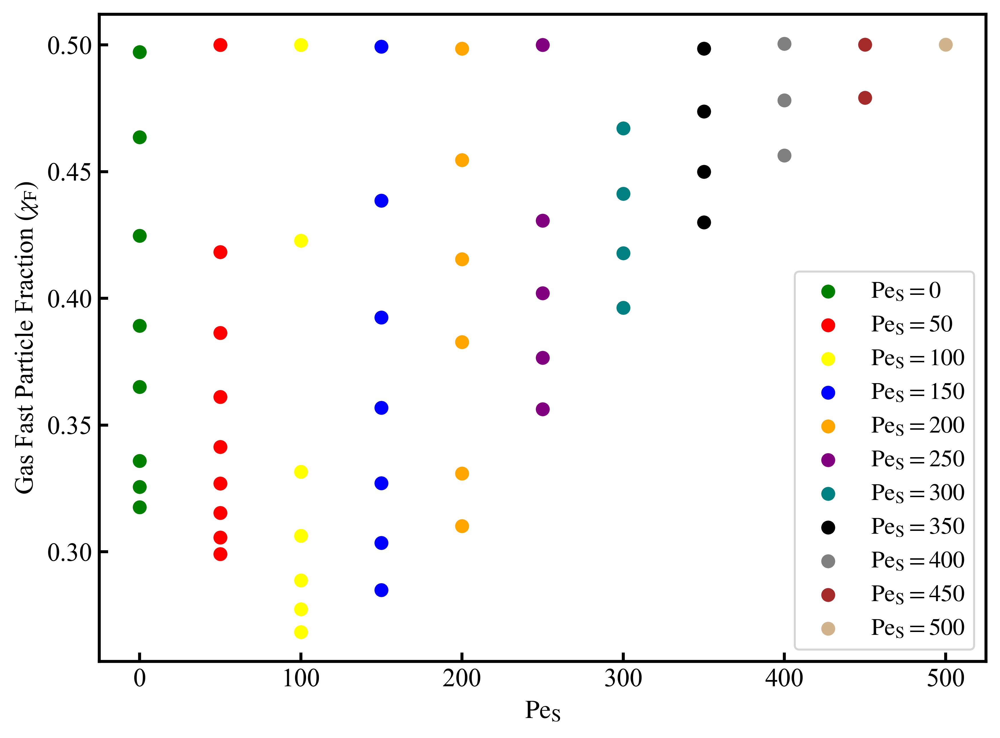

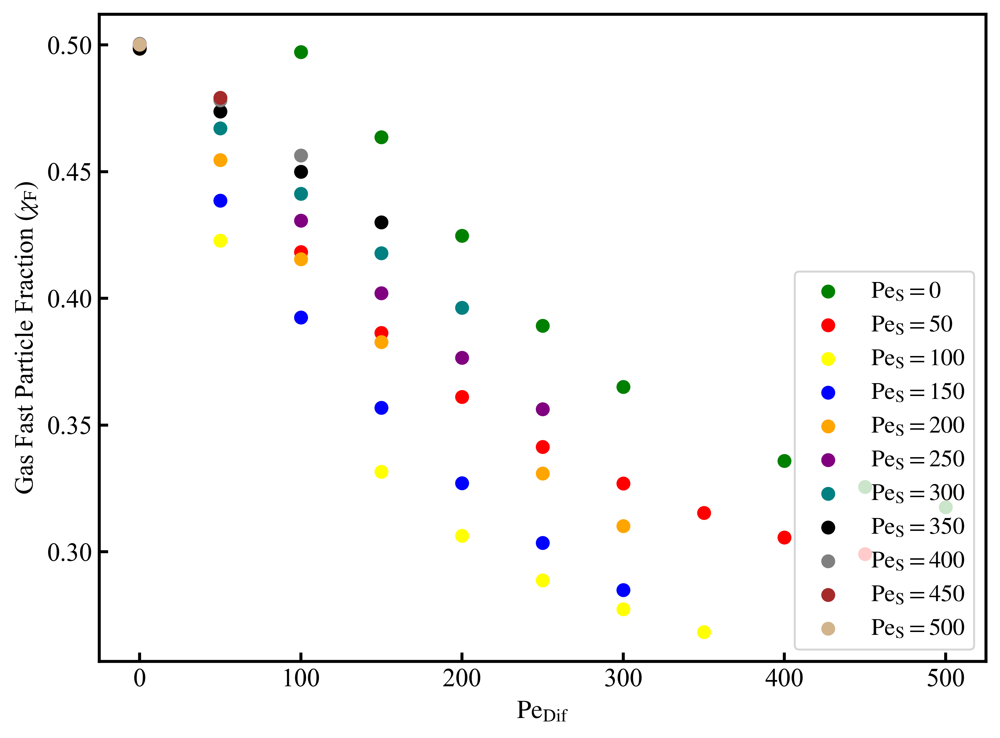

In [26]:
where_50 = np.where(slow_act==50)[0]
where_0 = np.where(slow_act==0)[0]
where_100 = np.where(slow_act==100)[0]
where_150 = np.where(slow_act==150)[0]
where_250 = np.where(slow_act==250)[0]
where_200 = np.where(slow_act==200)[0]
where_300 = np.where(slow_act==300)[0]
where_350 = np.where(slow_act==350)[0]
where_450 = np.where(slow_act==450)[0]
where_400 = np.where(slow_act==400)[0]
where_500 = np.where(slow_act==500)[0]
#where_else = np.where(slow_act>50)[0]

plt.figure(figsize=(8,6))
plt.ylabel(r'Gas Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Ratio}$')

plt.scatter(slow_act[where_0]/fast_act[where_0], mean_gas_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50]/fast_act[where_50], mean_gas_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100]/fast_act[where_100], mean_gas_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150]/fast_act[where_150], mean_gas_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200]/fast_act[where_200], mean_gas_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250]/fast_act[where_250], mean_gas_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300]/fast_act[where_300], mean_gas_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350]/fast_act[where_350], mean_gas_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400]/fast_act[where_400], mean_gas_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450]/fast_act[where_450], mean_gas_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500]/fast_act[where_500], mean_gas_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0], mean_gas_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50], mean_gas_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100], mean_gas_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150], mean_gas_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200], mean_gas_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250], mean_gas_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300], mean_gas_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350], mean_gas_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400], mean_gas_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450], mean_gas_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500], mean_gas_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Gas Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{F}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(slow_act[where_0], mean_gas_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50], mean_gas_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100], mean_gas_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150], mean_gas_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200], mean_gas_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250], mean_gas_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300], mean_gas_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350], mean_gas_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400], mean_gas_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450], mean_gas_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500], mean_gas_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Gas Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{S}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0]-slow_act[where_0], mean_gas_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50]-slow_act[where_50], mean_gas_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100]-slow_act[where_100], mean_gas_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150]-slow_act[where_150], mean_gas_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200]-slow_act[where_200], mean_gas_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250]-slow_act[where_250], mean_gas_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300]-slow_act[where_300], mean_gas_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350]-slow_act[where_350], mean_gas_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400]-slow_act[where_400], mean_gas_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450]-slow_act[where_450], mean_gas_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500]-slow_act[where_500], mean_gas_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.ylabel(r'Gas Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Dif}$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

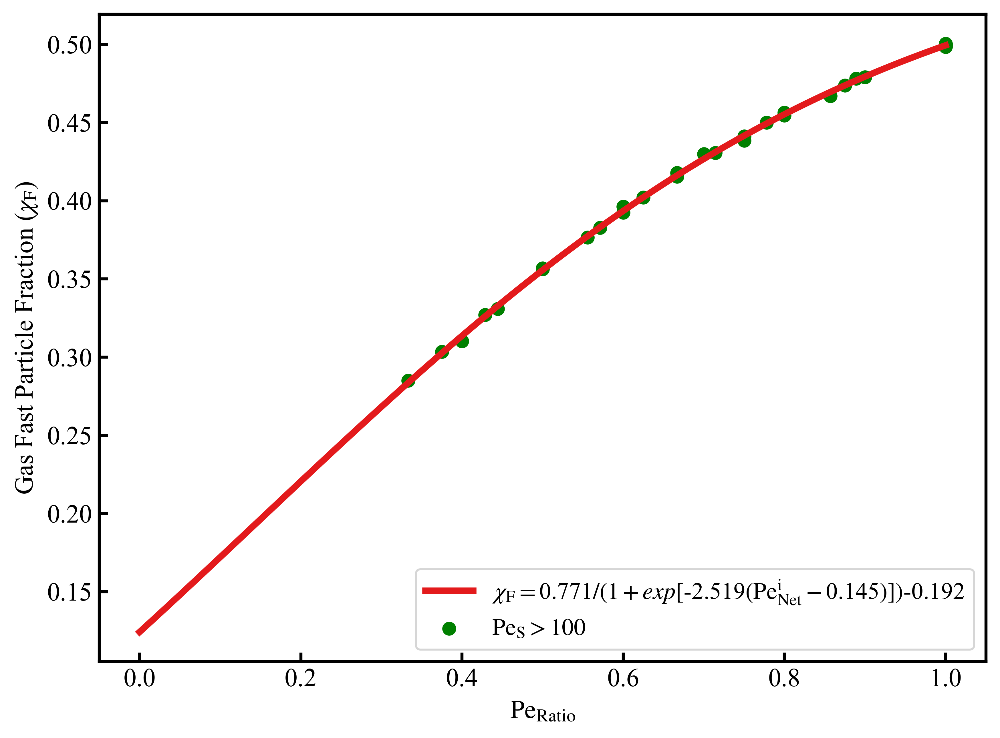

In [42]:
where_0 = np.where(slow_act>100)[0]

from scipy.optimize import curve_fit

#where_else = np.where(slow_act>50)[0]

def Gauss4(x, A, B, C, D):
    y = A/(1+np.exp(B*(x-C)))+D
    return y

def Gauss5(x, A, B,C):
    y = A*np.log10(x+B)+C
    return y

x_span = np.linspace(0, 1, num=500)

parameters, covariance = curve_fit(Gauss4, slow_act[where_0]/fast_act[where_0], mean_gas_fast_frac[where_0])

fit_A = parameters[0]
fit_B = parameters[1]
fit_C = parameters[2]
fit_D = parameters[3]

parameters, covariance = curve_fit(Gauss4, slow_act[where_0]/fast_act[where_0], mean_gas_fast_frac[where_0])

fit_A2 = parameters[0]
fit_B2 = parameters[1]
fit_C2 = parameters[2]

plt.figure(figsize=(8,6))
plt.ylabel(r'Gas Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Ratio}$')
plt.plot(x_span, fit_A /(1+np.exp(fit_B*(x_span-fit_C)))+ fit_D, color=fastCol, linewidth=1.8*1.8, label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+exp[$' + str(round(fit_B,3))+r'$(\mathrm{Pe}_\mathrm{Net}^\mathrm{i}-$' +str(round(fit_C,3)) + r'$)])$'+ str(round(fit_D,3)))      
#plt.plot(x_span, fit_A2 * np.log10(x_span+fit_B2)+ fit_C2, color=slowCol, linewidth=1.8*1.8, label=r'$\chi_\mathrm{F}=$'+str(round(fit_A,3))+r'$/(1+exp[$' + str(round(fit_B,3))+r'$(\mathrm{Pe}_\mathrm{Net}^\mathrm{i}-$' +str(round(fit_C,3)) + r'$)])$'+ str(round(fit_D,3)))      

plt.scatter(slow_act[where_0]/fast_act[where_0], mean_gas_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}>100$')
plt.legend(loc='lower right', fontsize=12)
plt.show()



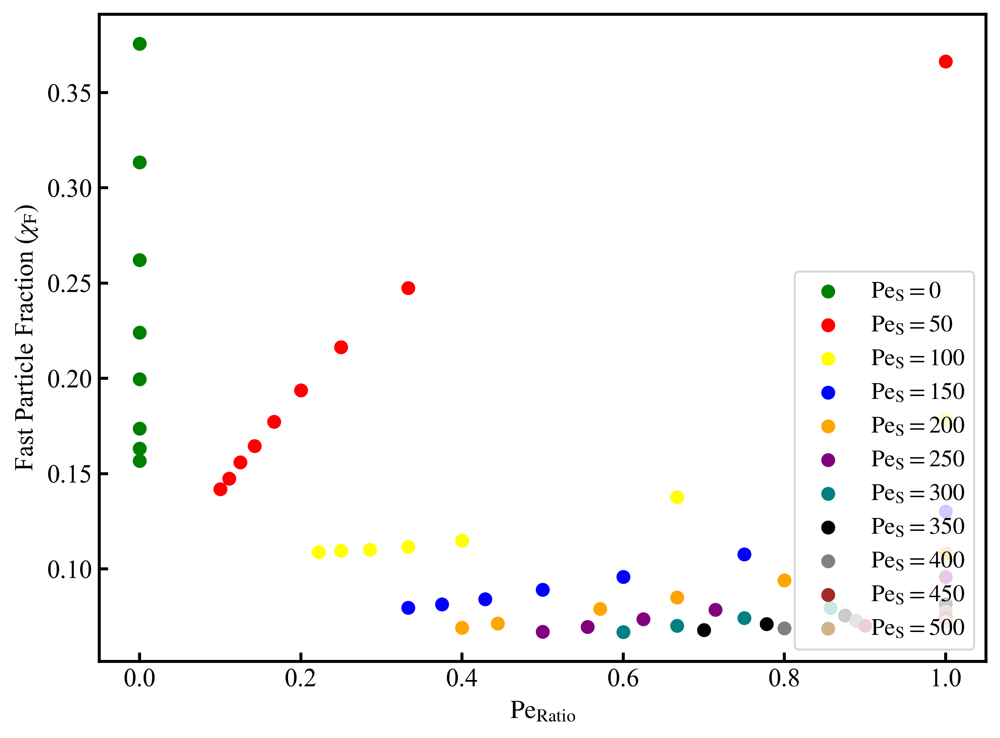

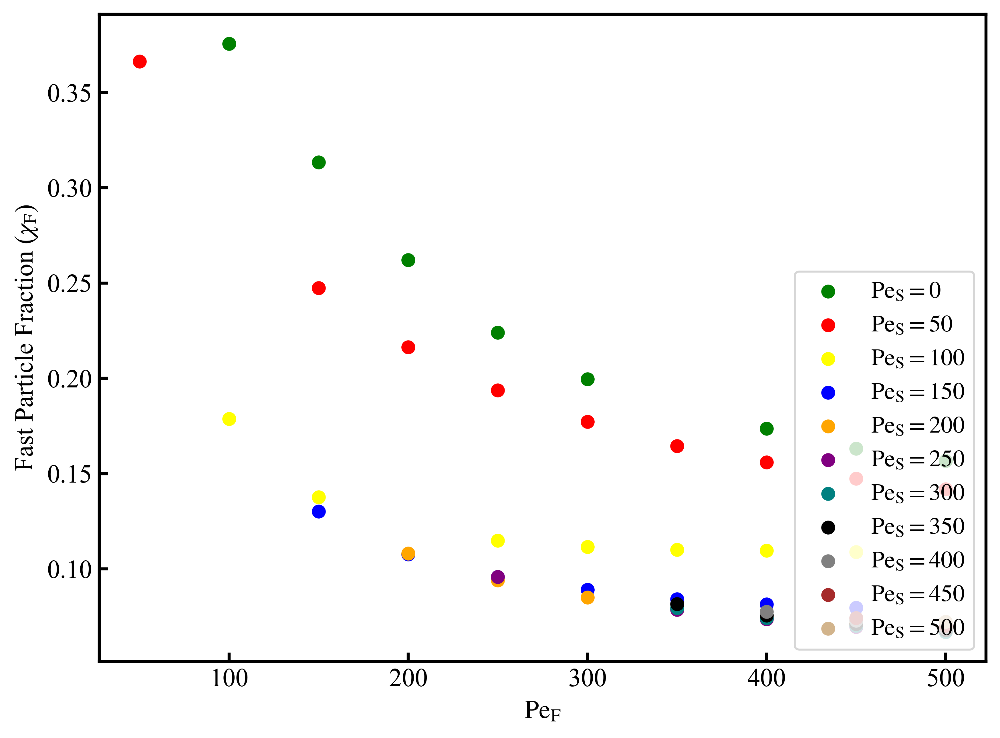

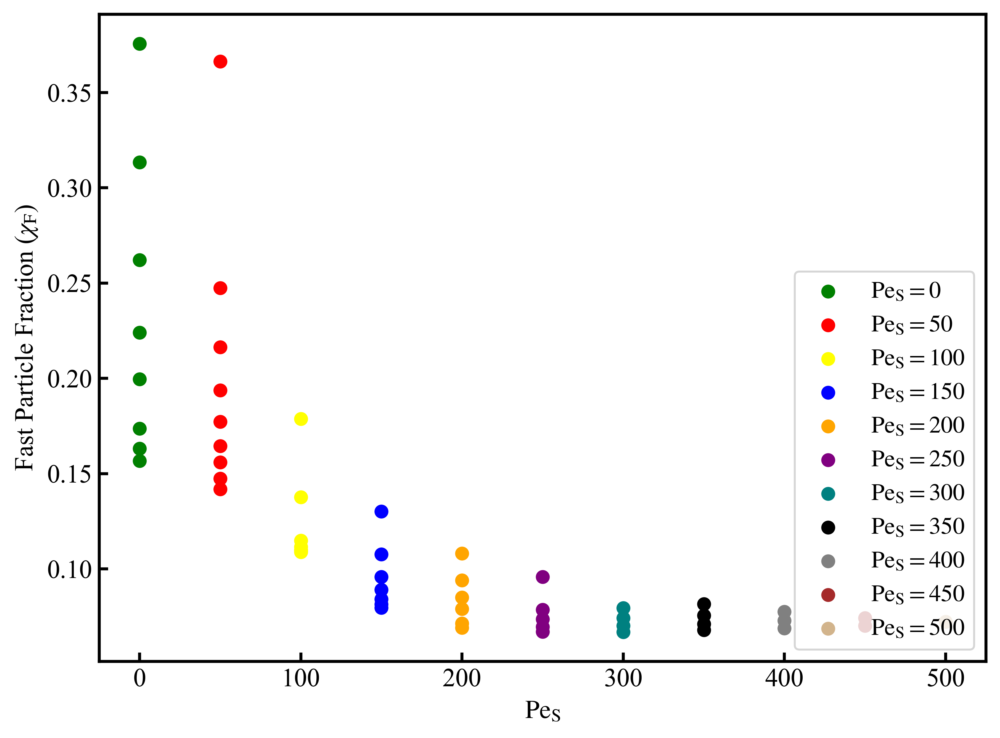

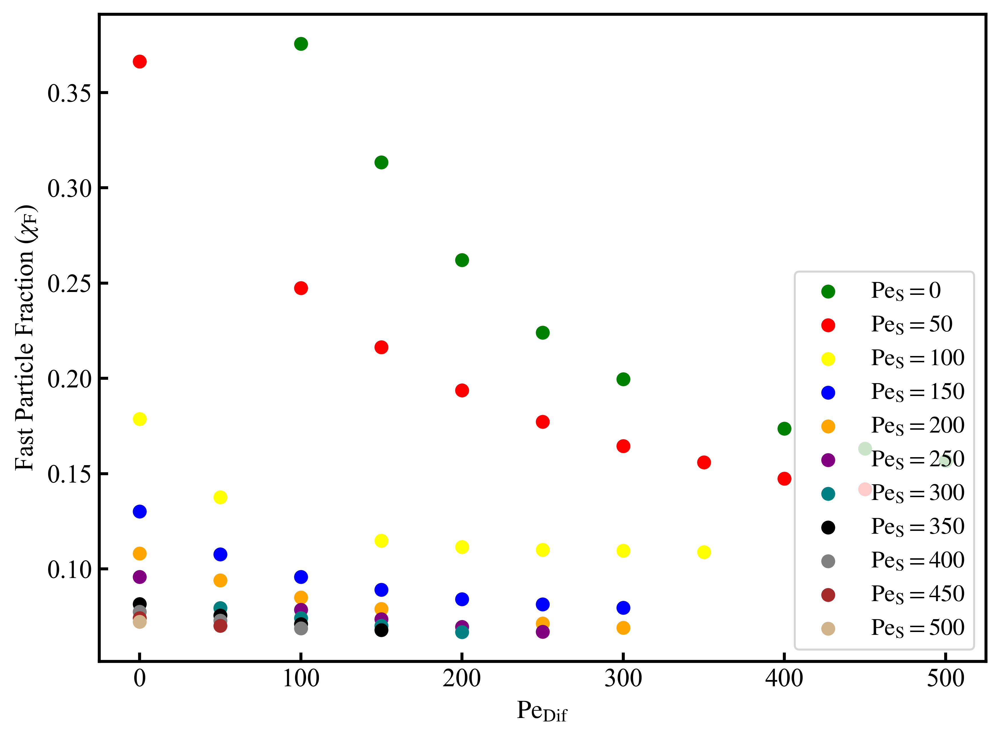

In [27]:
where_50 = np.where(slow_act==50)[0]
where_0 = np.where(slow_act==0)[0]
where_100 = np.where(slow_act==100)[0]
where_150 = np.where(slow_act==150)[0]
where_250 = np.where(slow_act==250)[0]
where_200 = np.where(slow_act==200)[0]
where_300 = np.where(slow_act==300)[0]
where_350 = np.where(slow_act==350)[0]
where_450 = np.where(slow_act==450)[0]
where_400 = np.where(slow_act==400)[0]
where_500 = np.where(slow_act==500)[0]
#where_else = np.where(slow_act>50)[0]

plt.figure(figsize=(8,6))
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Ratio}$')

plt.scatter(slow_act[where_0]/fast_act[where_0], avg_gas_nB[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50]/fast_act[where_50], avg_gas_nB[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100]/fast_act[where_100], avg_gas_nB[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150]/fast_act[where_150], avg_gas_nB[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200]/fast_act[where_200], avg_gas_nB[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250]/fast_act[where_250], avg_gas_nB[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300]/fast_act[where_300], avg_gas_nB[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350]/fast_act[where_350], avg_gas_nB[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400]/fast_act[where_400], avg_gas_nB[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450]/fast_act[where_450], avg_gas_nB[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500]/fast_act[where_500], avg_gas_nB[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0], avg_gas_nB[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50], avg_gas_nB[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100], avg_gas_nB[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150], avg_gas_nB[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200], avg_gas_nB[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250], avg_gas_nB[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300], avg_gas_nB[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350], avg_gas_nB[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400], avg_gas_nB[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450], avg_gas_nB[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500], avg_gas_nB[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{F}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(slow_act[where_0], avg_gas_nB[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50], avg_gas_nB[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100], avg_gas_nB[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150], avg_gas_nB[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200], avg_gas_nB[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250], avg_gas_nB[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300], avg_gas_nB[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350], avg_gas_nB[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400], avg_gas_nB[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450], avg_gas_nB[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500], avg_gas_nB[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{S}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0]-slow_act[where_0], avg_gas_nB[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50]-slow_act[where_50], avg_gas_nB[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100]-slow_act[where_100], avg_gas_nB[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150]-slow_act[where_150], avg_gas_nB[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200]-slow_act[where_200], avg_gas_nB[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250]-slow_act[where_250], avg_gas_nB[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300]-slow_act[where_300], avg_gas_nB[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350]-slow_act[where_350], avg_gas_nB[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400]-slow_act[where_400], avg_gas_nB[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450]-slow_act[where_450], avg_gas_nB[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500]-slow_act[where_500], avg_gas_nB[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Dif}$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

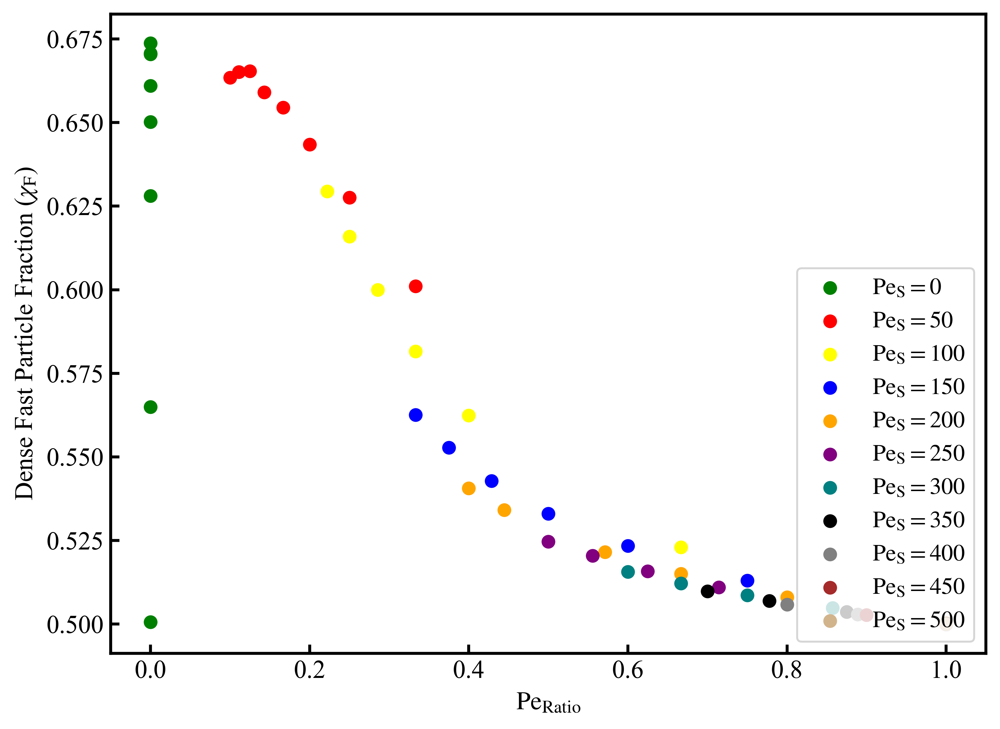

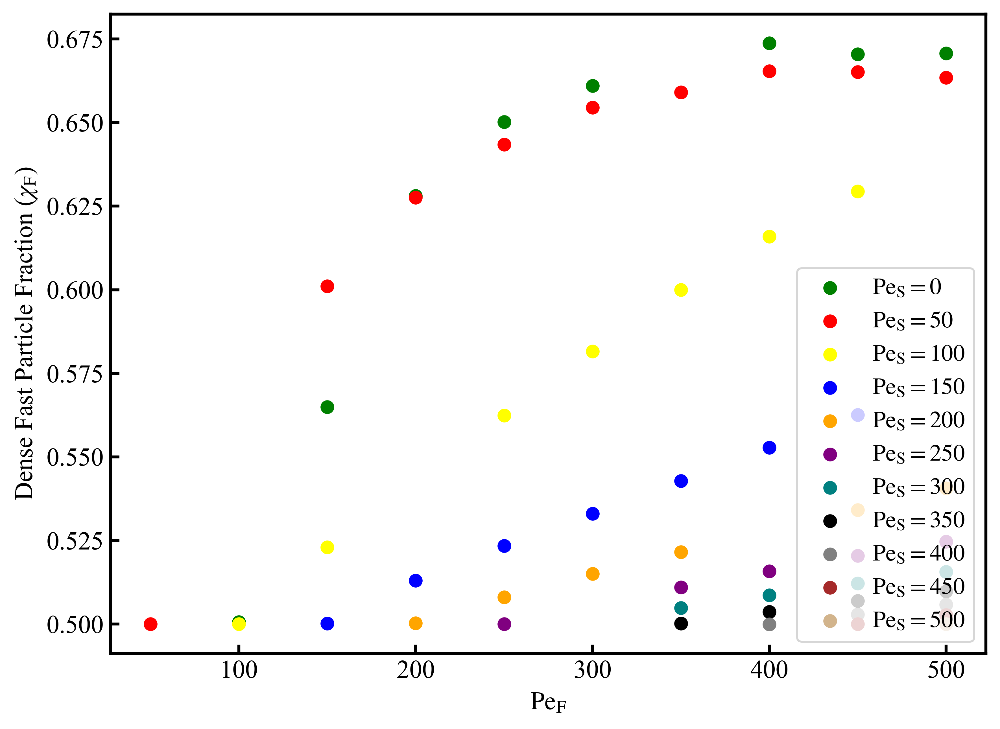

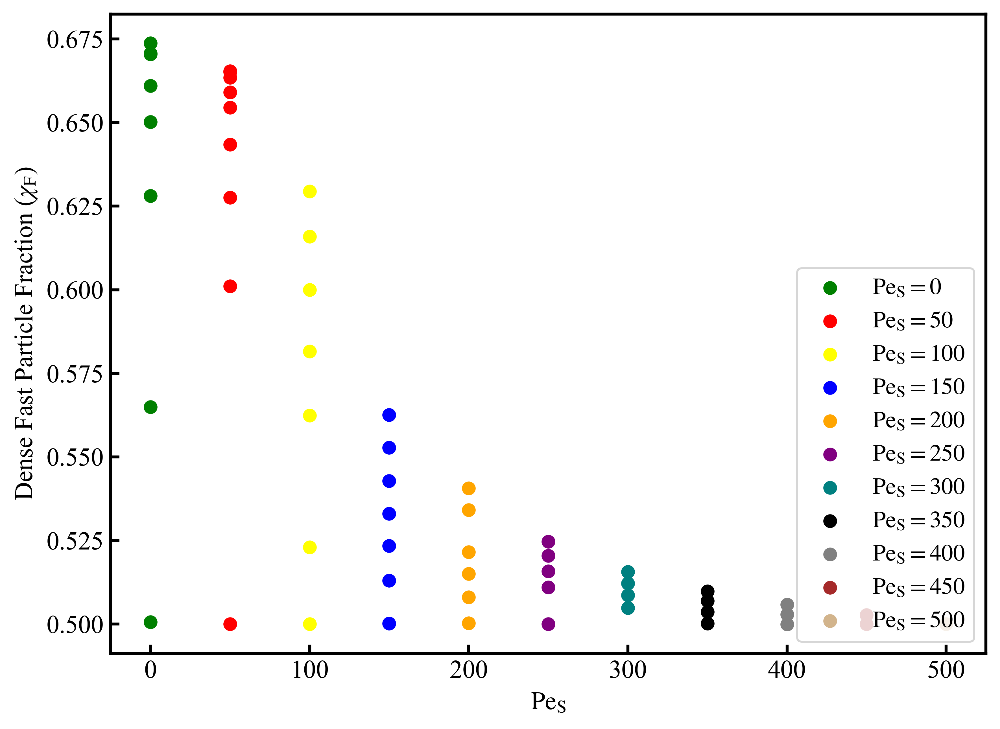

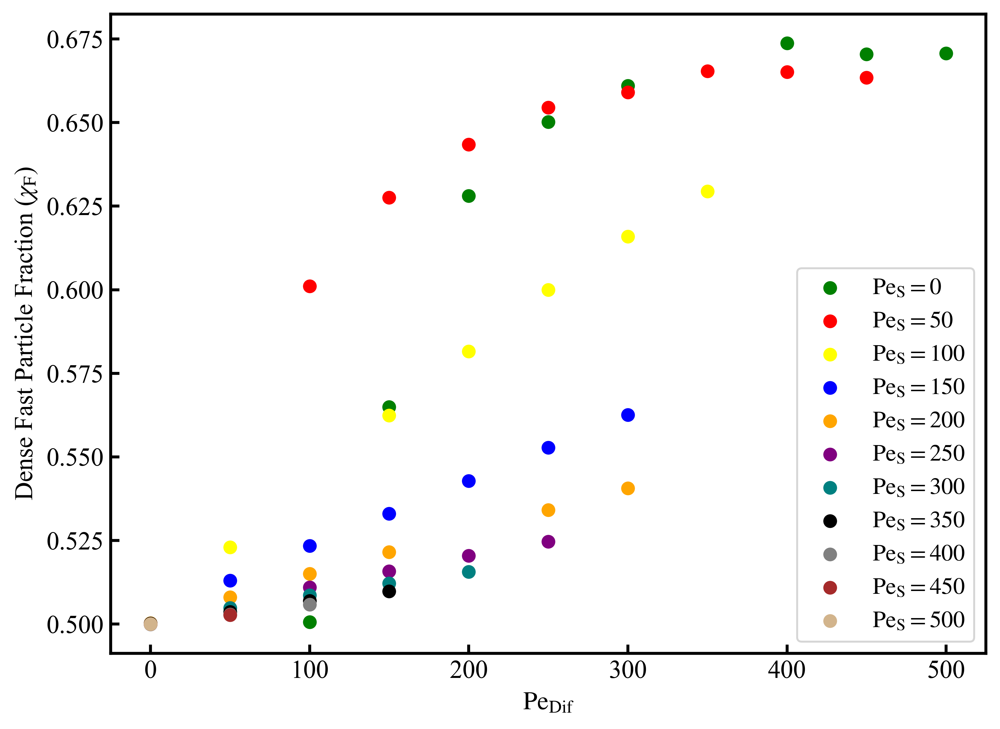

In [28]:
where_50 = np.where(slow_act==50)[0]
where_0 = np.where(slow_act==0)[0]
where_100 = np.where(slow_act==100)[0]
where_150 = np.where(slow_act==150)[0]
where_250 = np.where(slow_act==250)[0]
where_200 = np.where(slow_act==200)[0]
where_300 = np.where(slow_act==300)[0]
where_350 = np.where(slow_act==350)[0]
where_450 = np.where(slow_act==450)[0]
where_400 = np.where(slow_act==400)[0]
where_500 = np.where(slow_act==500)[0]
#where_else = np.where(slow_act>50)[0]

plt.figure(figsize=(8,6))
plt.ylabel(r'Dense Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Ratio}$')

plt.scatter(slow_act[where_0]/fast_act[where_0], mean_dense_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50]/fast_act[where_50], mean_dense_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100]/fast_act[where_100], mean_dense_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150]/fast_act[where_150], mean_dense_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200]/fast_act[where_200], mean_dense_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250]/fast_act[where_250], mean_dense_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300]/fast_act[where_300], mean_dense_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350]/fast_act[where_350], mean_dense_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400]/fast_act[where_400], mean_dense_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450]/fast_act[where_450], mean_dense_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500]/fast_act[where_500], mean_dense_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0], mean_dense_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50], mean_dense_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100], mean_dense_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150], mean_dense_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200], mean_dense_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250], mean_dense_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300], mean_dense_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350], mean_dense_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400], mean_dense_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450], mean_dense_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500], mean_dense_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Dense Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{F}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(slow_act[where_0], mean_dense_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50], mean_dense_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100], mean_dense_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150], mean_dense_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200], mean_dense_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250], mean_dense_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300], mean_dense_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350], mean_dense_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400], mean_dense_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450], mean_dense_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500], mean_dense_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Dense Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{S}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0]-slow_act[where_0], mean_dense_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50]-slow_act[where_50], mean_dense_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100]-slow_act[where_100], mean_dense_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150]-slow_act[where_150], mean_dense_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200]-slow_act[where_200], mean_dense_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250]-slow_act[where_250], mean_dense_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300]-slow_act[where_300], mean_dense_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350]-slow_act[where_350], mean_dense_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400]-slow_act[where_400], mean_dense_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450]-slow_act[where_450], mean_dense_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500]-slow_act[where_500], mean_dense_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.ylabel(r'Dense Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Dif}$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

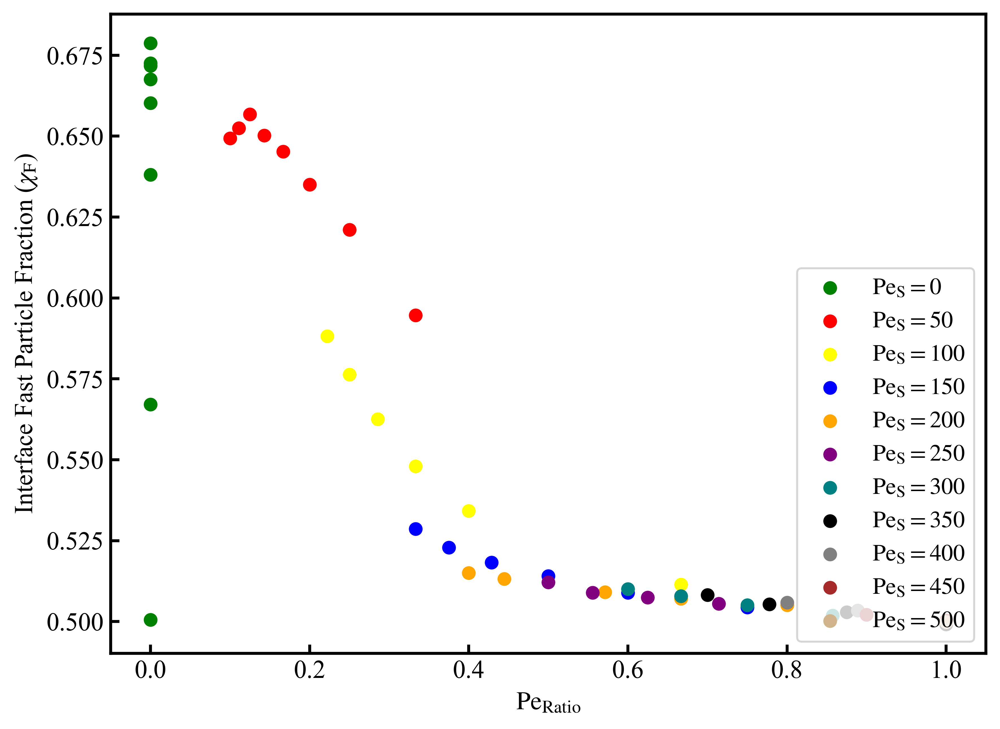

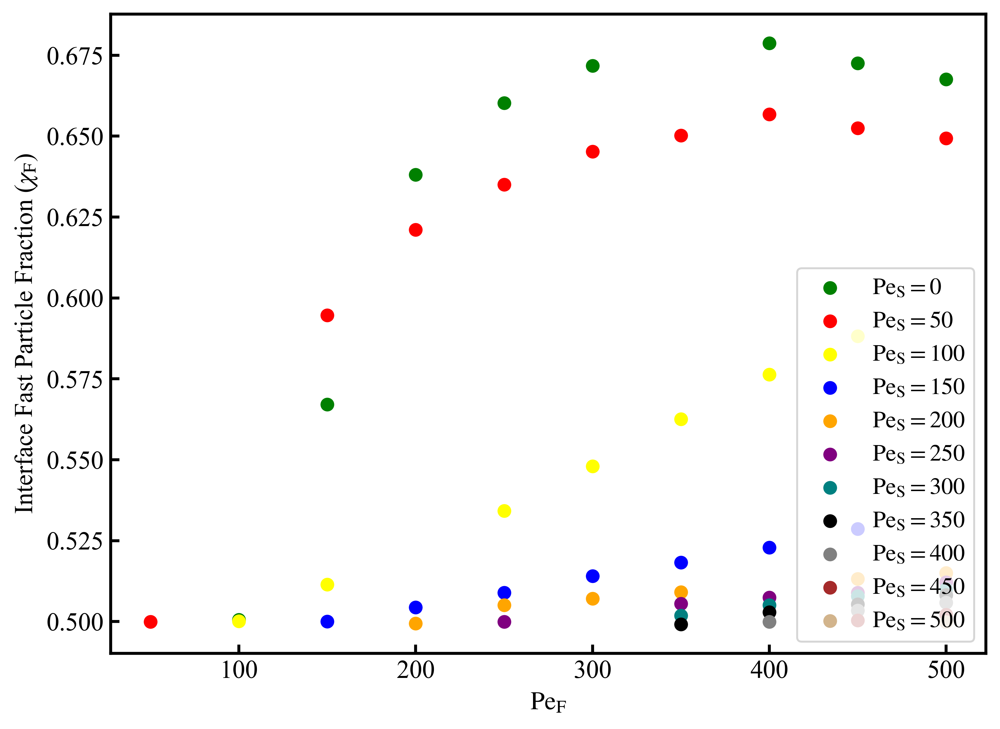

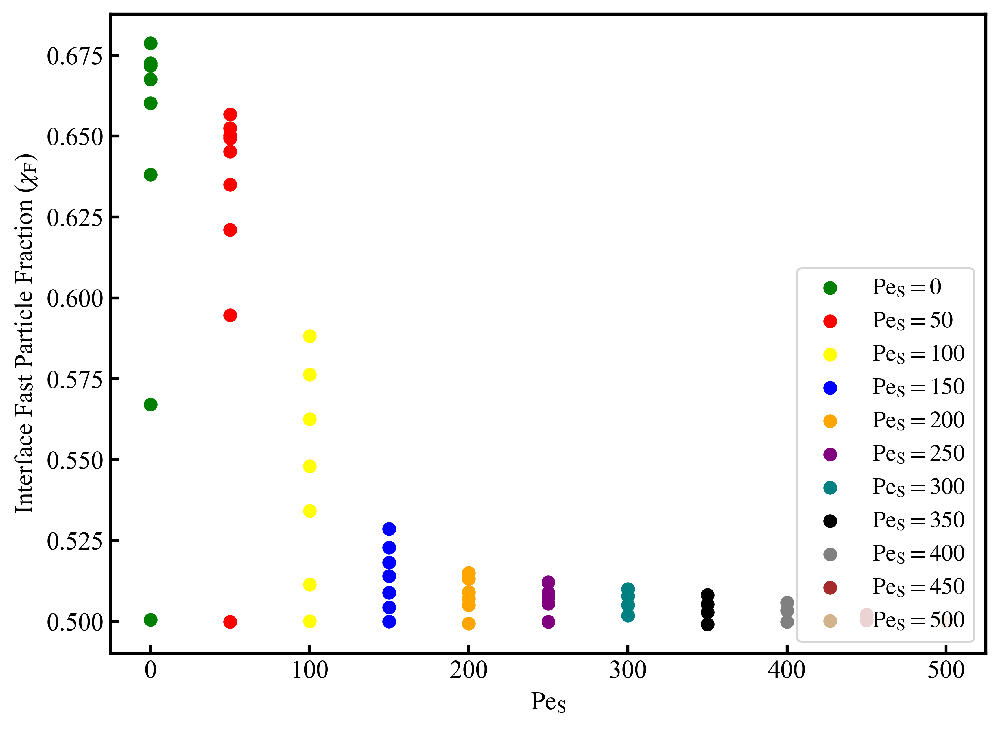

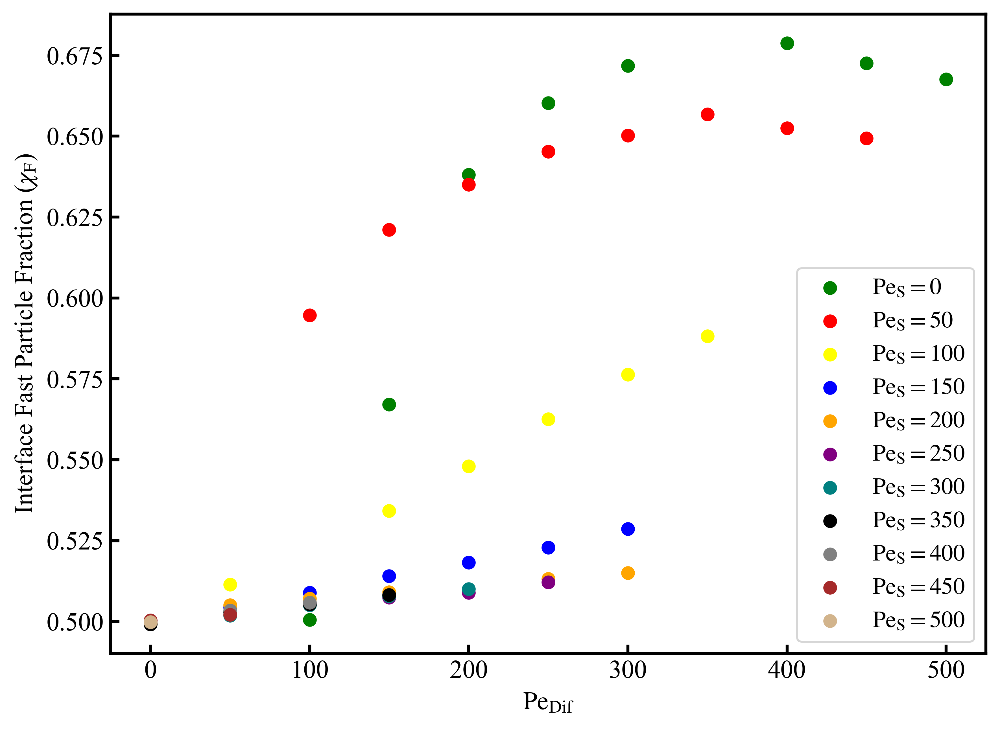

In [44]:
where_50 = np.where(slow_act==50)[0]
where_0 = np.where(slow_act==0)[0]
where_100 = np.where(slow_act==100)[0]
where_150 = np.where(slow_act==150)[0]
where_250 = np.where(slow_act==250)[0]
where_200 = np.where(slow_act==200)[0]
where_300 = np.where(slow_act==300)[0]
where_350 = np.where(slow_act==350)[0]
where_450 = np.where(slow_act==450)[0]
where_400 = np.where(slow_act==400)[0]
where_500 = np.where(slow_act==500)[0]
#where_else = np.where(slow_act>50)[0]

plt.figure(figsize=(8,6))
plt.ylabel(r'Interface Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Ratio}$')

plt.scatter(slow_act[where_0]/fast_act[where_0], mean_int_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50]/fast_act[where_50], mean_int_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100]/fast_act[where_100], mean_int_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150]/fast_act[where_150], mean_int_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200]/fast_act[where_200], mean_int_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250]/fast_act[where_250], mean_int_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300]/fast_act[where_300], mean_int_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350]/fast_act[where_350], mean_int_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400]/fast_act[where_400], mean_int_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450]/fast_act[where_450], mean_int_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500]/fast_act[where_500], mean_int_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0], mean_int_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50], mean_int_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100], mean_int_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150], mean_int_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200], mean_int_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250], mean_int_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300], mean_int_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350], mean_int_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400], mean_int_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450], mean_int_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500], mean_int_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Interface Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{F}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(slow_act[where_0], mean_int_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50], mean_int_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100], mean_int_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150], mean_int_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200], mean_int_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250], mean_int_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300], mean_int_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350], mean_int_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400], mean_int_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450], mean_int_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500], mean_int_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Interface Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{S}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0]-slow_act[where_0], mean_int_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50]-slow_act[where_50], mean_int_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100]-slow_act[where_100], mean_int_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150]-slow_act[where_150], mean_int_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200]-slow_act[where_200], mean_int_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250]-slow_act[where_250], mean_int_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300]-slow_act[where_300], mean_int_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350]-slow_act[where_350], mean_int_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400]-slow_act[where_400], mean_int_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450]-slow_act[where_450], mean_int_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500]-slow_act[where_500], mean_int_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.ylabel(r'Interface Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Dif}$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

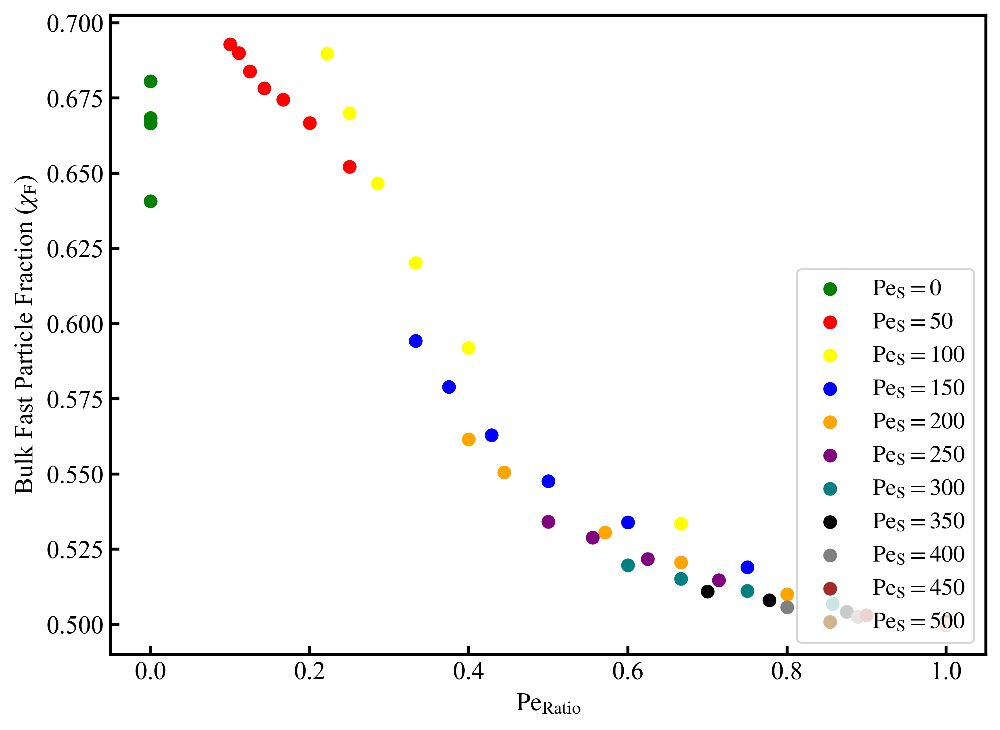

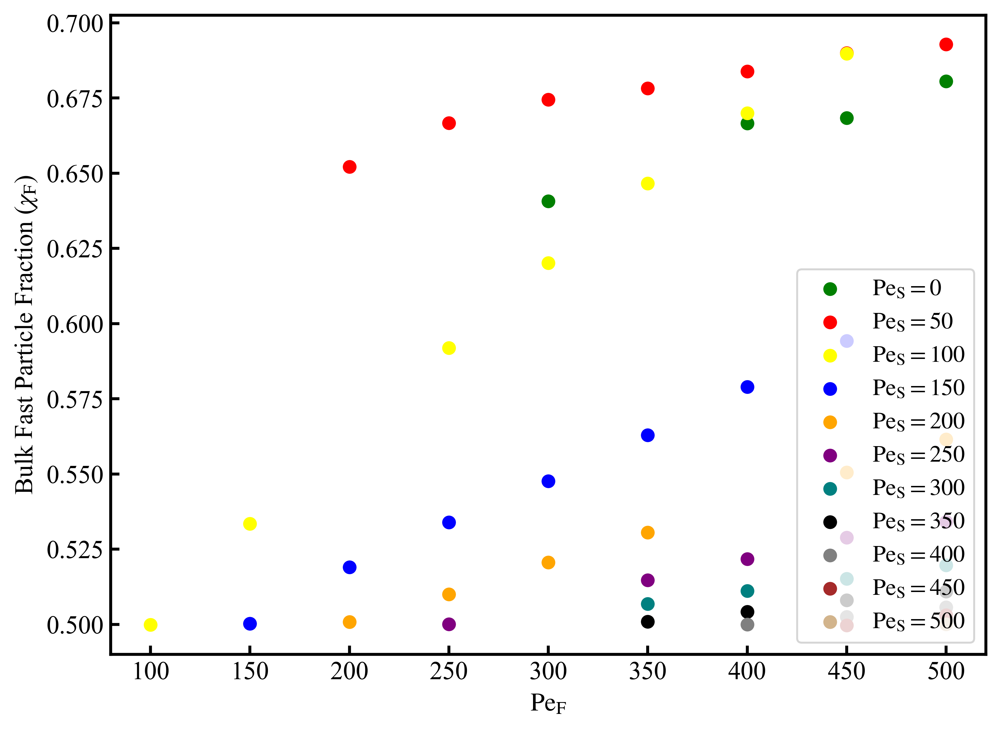

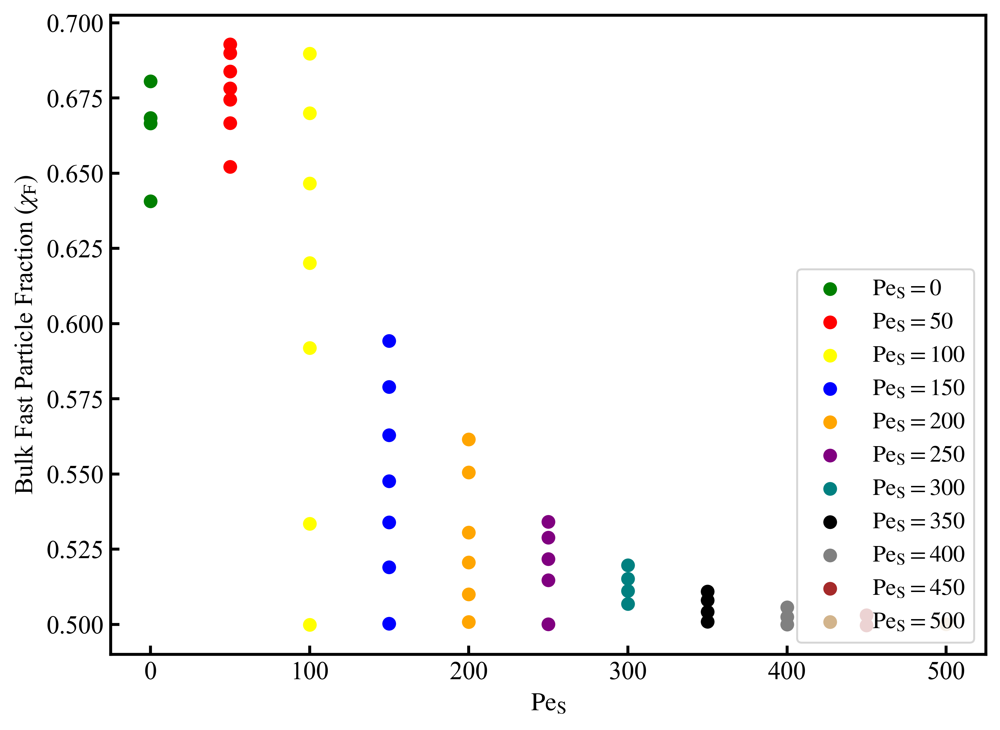

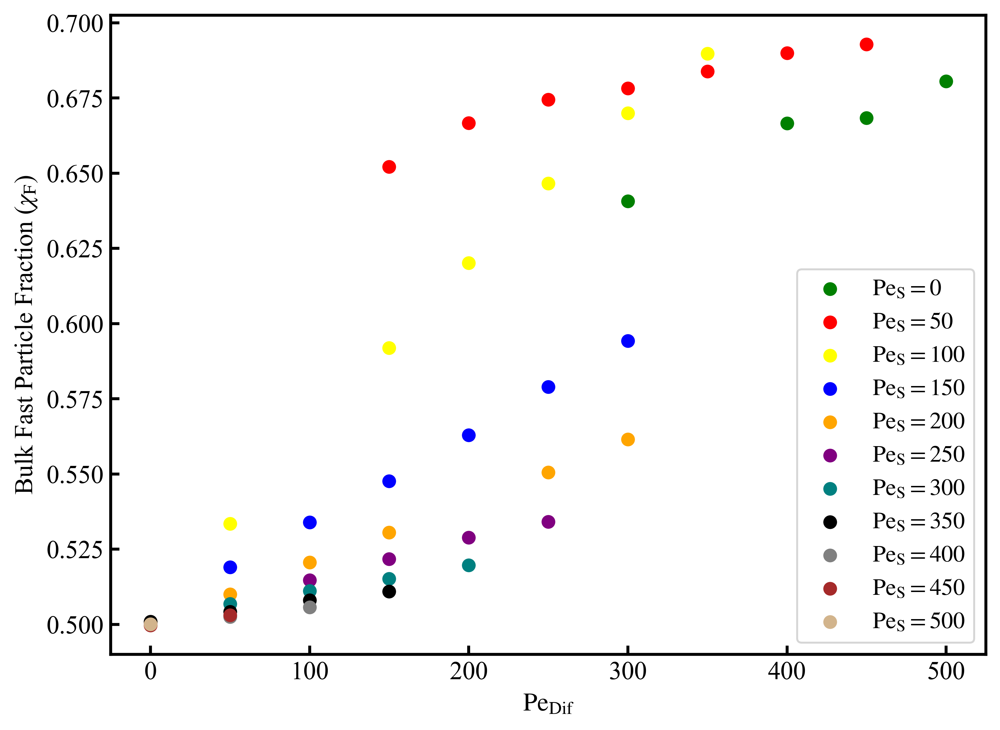

In [45]:
where_50 = np.where(slow_act==50)[0]
where_0 = np.where(slow_act==0)[0]
where_100 = np.where(slow_act==100)[0]
where_150 = np.where(slow_act==150)[0]
where_250 = np.where(slow_act==250)[0]
where_200 = np.where(slow_act==200)[0]
where_300 = np.where(slow_act==300)[0]
where_350 = np.where(slow_act==350)[0]
where_450 = np.where(slow_act==450)[0]
where_400 = np.where(slow_act==400)[0]
where_500 = np.where(slow_act==500)[0]
#where_else = np.where(slow_act>50)[0]

plt.figure(figsize=(8,6))
plt.ylabel(r'Bulk Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Ratio}$')

plt.scatter(slow_act[where_0]/fast_act[where_0], mean_bulk_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50]/fast_act[where_50], mean_bulk_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100]/fast_act[where_100], mean_bulk_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150]/fast_act[where_150], mean_bulk_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200]/fast_act[where_200], mean_bulk_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250]/fast_act[where_250], mean_bulk_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300]/fast_act[where_300], mean_bulk_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350]/fast_act[where_350], mean_bulk_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400]/fast_act[where_400], mean_bulk_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450]/fast_act[where_450], mean_bulk_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500]/fast_act[where_500], mean_bulk_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0], mean_bulk_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50], mean_bulk_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100], mean_bulk_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150], mean_bulk_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200], mean_bulk_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250], mean_bulk_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300], mean_bulk_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350], mean_bulk_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400], mean_bulk_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450], mean_bulk_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500], mean_bulk_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Bulk Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{F}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(slow_act[where_0], mean_bulk_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(slow_act[where_50], mean_bulk_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(slow_act[where_100], mean_bulk_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(slow_act[where_150], mean_bulk_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(slow_act[where_200], mean_bulk_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(slow_act[where_250], mean_bulk_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(slow_act[where_300], mean_bulk_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(slow_act[where_350], mean_bulk_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(slow_act[where_400], mean_bulk_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(slow_act[where_450], mean_bulk_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(slow_act[where_500], mean_bulk_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.legend(loc='lower right', fontsize=12)
plt.ylabel(r'Bulk Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{S}$')
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(fast_act[where_0]-slow_act[where_0], mean_bulk_fast_frac[where_0], color='green', label=r'$\mathrm{Pe}_\mathrm{S}=0$')
plt.scatter(fast_act[where_50]-slow_act[where_50], mean_bulk_fast_frac[where_50], color='red', label=r'$\mathrm{Pe}_\mathrm{S}=50$')
plt.scatter(fast_act[where_100]-slow_act[where_100], mean_bulk_fast_frac[where_100], color='yellow', label=r'$\mathrm{Pe}_\mathrm{S}=100$')
plt.scatter(fast_act[where_150]-slow_act[where_150], mean_bulk_fast_frac[where_150], color='blue', label=r'$\mathrm{Pe}_\mathrm{S}=150$')
plt.scatter(fast_act[where_200]-slow_act[where_200], mean_bulk_fast_frac[where_200], color='orange', label=r'$\mathrm{Pe}_\mathrm{S}=200$')
plt.scatter(fast_act[where_250]-slow_act[where_250], mean_bulk_fast_frac[where_250], color='purple', label=r'$\mathrm{Pe}_\mathrm{S}=250$')
plt.scatter(fast_act[where_300]-slow_act[where_300], mean_bulk_fast_frac[where_300], color='teal', label=r'$\mathrm{Pe}_\mathrm{S}=300$')
plt.scatter(fast_act[where_350]-slow_act[where_350], mean_bulk_fast_frac[where_350], color='black', label=r'$\mathrm{Pe}_\mathrm{S}=350$')
plt.scatter(fast_act[where_400]-slow_act[where_400], mean_bulk_fast_frac[where_400], color='gray', label=r'$\mathrm{Pe}_\mathrm{S}=400$')
plt.scatter(fast_act[where_450]-slow_act[where_450], mean_bulk_fast_frac[where_450], color='brown', label=r'$\mathrm{Pe}_\mathrm{S}=450$')
plt.scatter(fast_act[where_500]-slow_act[where_500], mean_bulk_fast_frac[where_500], color='tan', label=r'$\mathrm{Pe}_\mathrm{S}=500$')
plt.ylabel(r'Bulk Fast Particle Fraction ($\chi_\mathrm{F}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Dif}$')
plt.legend(loc='lower right', fontsize=12)
plt.show()

In [ ]:
align_peA=np.array([])
align_peB=np.array([])
align_peNet=np.array([])
first_align_peNet=np.array([])
first_interpart_peNet=np.array([])
first_interpart_peA=np.array([])
first_interpart_peB=np.array([])

align_xA=np.array([])
align_eps=np.array([])
align_pnum=np.array([])
align_phi=np.array([])
align_press_arr = np.array([])
first_align_press = np.array([])
first_bulk_press = np.array([])
first_align_peA=np.array([])
first_align_peB=np.array([])

width_peA=np.array([])
width_peB=np.array([])
width_peNet=np.array([])
width_xA=np.array([])
width_eps=np.array([])
width_pnum=np.array([])
width_phi=np.array([])

interpart_peA=np.array([])
interpart_peB=np.array([])
interpart_peNet=np.array([])
interpart_xA=np.array([])
interpart_eps=np.array([])
interpart_pnum=np.array([])
interpart_phi=np.array([])
interpart_press=np.array([])
interpart_press_expand=np.array([])
avg_shear=np.array([])
fastCol = '#e31a1c'
slowCol = '#081d58'

avg_rad = np.array([])
avg_width = np.array([])
avg_clust = np.array([])
avg_circularity = np.array([])

bulk_lat_time_mean = np.array([])
int_lat_time_mean = np.array([])
all_lat_time_mean = np.array([])
bulk_lat_time_std = np.array([])
int_lat_time_std = np.array([])
all_lat_time_std = np.array([])


avg_bulk_nA = np.array([])
avg_bulk_nB = np.array([])
avg_bulk_n = np.array([])
avg_dense_nA = np.array([])
avg_dense_nB = np.array([])
avg_dense_n = np.array([])
avg_int_n = np.array([])
avg_int_nA = np.array([])
avg_int_nB = np.array([])
avg_gas_nA = np.array([])
avg_gas_nB = np.array([])
avg_gas_n = np.array([])

align_type = np.array([])
interpart_type = np.array([])

width_type = np.array([])

avg_int_theory_arr = np.array([])
avg_bulk_theory_arr = np.array([])
def ljForce(r, eps, sigma=1.):
    div = (sigma/r)
    dU = (24. * eps / sigma) * ((2*(div**13)) - (div)**7)
    return dU

def avgCollisionForce(pe, power=1.):
    '''Computed from the integral of possible angles'''
    peCritical = 40.
    if pe < peCritical:
        pe = 0
    else:
        pe -= peCritical
    magnitude = 6.
    # A vector sum of the six nearest neighbors
    magnitude = np.sqrt(28)
#     return (magnitude * (pe**power)) / (np.pi)
#     return (pe * (1. + (8./(np.pi**2.))))
    coeff = 1.92#3.0#1.92#2.03#3.5#2.03
    #coeff= 0.4053
    return (pe * coeff)

def conForRClust(pe, eps):
    out = []
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while ljForce(r, eps) < avgCollisionForce(pe):
            r -= j
        r += j
    out = r
    return out
def densProbability(r, activity_net, activity_slow):
    "Using similar triangles to find sides"
    gas_dense_dif_phi = 0.866 * np.log10(activity_net - 46.993) - 0.443
    rate_decay = -6.151 * np.log10(activity_net-49.921) - 4.392
    mid_point = 0.044 * np.log10(activity_slow-49.893) + 0.836
    gas_phi = -0.26 * np.log10(activity_slow-41.742)+0.783
    
    num_dens_r = ((gas_dense_dif_phi / (1+np.exp(-rate_decay * (r-mid_point)))) + gas_phi)
    
    return num_dens_r

def alignProbability(r, activity_net, activity_slow):
    "Using similar triangles to find sides"
    max_align = 0.2019 * np.log10(activity_net - 41.2803) - 0.1885
    mid_point = 0.0492 * np.log10(activity_slow - 47.0061) + 0.8220
    std_dev = 0.1057
    align_r = max_align * np.exp(-(r-mid_point)**2/(2*std_dev**2))
    
    return align_r


for i in range(0, len(all_dens)):
    #if (dens[i][0:1]=='rand') or (dens[i][0:4]=='fast'):
        #if (params['peA'][i]==150) & (params['peB'][i]==450):
        if (params['peA'][i]>=0) & (params['peB'][i]>=0):
            if all_dens[i].empty:
                continue

            for k in range(0, len(all_pres)):
                if all_pres[k].empty:
                    continue
                if params2['peA'][k]==params['peA'][i]:
                    if params2['peB'][k]==params['peB'][i]:


                            for q in range(0, len(all_pres_new2)):

                                if all_pres_new2[q].empty:
                                    continue
                                if params4['peA'][q]==params['peA'][i]:
                                    if params4['peB'][q]==params['peB'][i]:
                                        for s in range(0, len(all_pres_new3)):

                                            if all_pres_new3[s].empty:
                                                continue
                                            if params5['peA'][s]==params['peA'][i]:
                                                if params5['peB'][s]==params['peB'][i]:
                                                        for t in range(0, len(all_pres_new)):
                                                            if all_pres_new[t].empty:
                                                                    continue
                                                            if params3['peA'][t]==params['peA'][i]:
                                                                if params3['peB'][t]==params['peB'][i]:
                                                                    for u in range(0, len(all_pres_new4)):
                                                                        if all_pres_new4[u].empty:
                                                                            continue
                                                                        if params6['peA'][u]==params['peA'][i]:
                                                                            if params6['peB'][u]==params['peB'][i]:
                                                                                if ((params4['peA'][q]==0) & (params4['peB'][q]==100)):
        
                                                                                    continue
                                                                                elif ((params4['peA'][q]==10) & (params4['peB'][q]==100)):
                                                                                    continue
                                                                                elif ((params4['peA'][q]==10) & (params4['peB'][q]==150)):
                                                                                    continue
                                                                                elif ((params4['peA'][q]==20) & (params4['peB'][q]==100)):
                                                                                    continue
                                                                                elif ((params4['peA'][q]==40) & (params4['peB'][q]==150)):
                                                                                    continue
                                                                                elif ((params4['peA'][q]==50) & (params4['peB'][q]==50)):
                                                                                    continue
                                                                                else:
                                                                                    print(pres5[u][0:4])
                                                                                    print(params['peA'][i])
                                                                                    print(params['peB'][i])
                                                                                    time_i = all_dens[i]['tauB']
                                                                                    time_k = all_pres[k]['Timestep']
                                                                                    time_q = all_pres_new2[q]['tauB']
                                                                                    time_s = all_pres_new3[s]['tauB']
                                                                                    time_t = all_pres_new[t]['tauB']
                                                                                    time_u = all_pres_new4[u]['tauB']

                                                                                    #Instantiate arrays for reading in interface pressure .txt file
                                                                                    final_time_i =np.array([])
                                                                                    final_align_press = np.array([])
                                                                                    align_press_total = 0
                                                                                    align_press_vals=0

                                                                                    #Instantiate arrays for reading in bulk pressure .txt file
                                                                                    bulk_time =np.array([])
                                                                                    bulk_press_time = np.array([])
                                                                                    bulk_press_total = 0
                                                                                    bulk_press_total_expand = 0
                                                                                    bulk_press_vals=0
                                                                                    shear_press_expand=0

                                                                                    #Instantiate arrays for reading in number density .txt file
                                                                                    bulk_nA_arr = np.array([])
                                                                                    bulk_nB_arr = np.array([])
                                                                                    bulk_n_arr = np.array([])
                                                                                    int_n_arr = np.array([])
                                                                                    int_nA_arr = np.array([])
                                                                                    int_nB_arr = np.array([])
                                                                                    gas_nA_arr = np.array([])
                                                                                    gas_n_arr = np.array([])
                                                                                    gas_nB_arr = np.array([])
                                                                                    dense_nA_arr = np.array([])
                                                                                    dense_nB_arr = np.array([])
                                                                                    dense_n_arr = np.array([])

                                                                                    #Instantiate arrays for reading in lattice spacing .txt file
                                                                                    bulk_lat_mean = np.array([])
                                                                                    int_lat_mean = np.array([])
                                                                                    all_lat_mean = np.array([])
                                                                                    bulk_lat_std = np.array([])
                                                                                    int_lat_std = np.array([])
                                                                                    all_lat_std = np.array([])

                                                                                    #Instantiate arrays for reading in radial measurement .txt file
                                                                                    num_dens_arr_temp = np.zeros(50)
                                                                                    align_arr_temp = np.zeros(50)
                                                                                    press_arr_temp = np.zeros(50)
                                                                                    xA_arr_temp = np.zeros(50)
                                                                                    xB_arr_temp = np.zeros(50)
                                                                                    temp_count = np.zeros(50)
                                                                                    temp_count_count = np.zeros(50)

                                                                                    radius_arr_final = np.linspace(0,1.6,num=50)
                                                                                    num_dens_arr_final = np.zeros(50)
                                                                                    align_arr_final = np.zeros(50)
                                                                                    xA_arr_final = np.zeros(50)
                                                                                    xB_arr_final = np.zeros(50)
                                                                                    press_arr_final = np.zeros(50)
                                                                                    final_count = np.zeros(50)
                                                                                    final_count_count = np.zeros(50)

                                                                                    press_theory_time = np.array([])
                                                                                    press_theory_val = np.array([])
                                                                                    time_arr = np.array([])

                                                                                    bub_width_arr = np.array([])
                                                                                    bub_area_arr = np.array([])
                                                                                    bub_surface_area_arr = np.array([])
                                                                                    int_width_arr = np.array([])
                                                                                    clust_arr = np.array([])

                                                                                    time_dens = np.array([])
                                                                                    time_width = np.array([])
                                                                                    time_lat = np.array([])
                                                                                    
                                                                                    align_arr_temp_sum = 0
                                                                                    align_arr_temp_val = 0

                                                                                    num_dens_arr_temp_sum = 0
                                                                                    #Loop over time in interface pressure .txt file
                                                                                    for j in range(0, len(time_i)):
                                                                                      
                                                                                        #Current time in loop
                                                                                        time = time_i[j]
                                                                                        if time >=0:

                                                                                            #Read values and set variables from interface pressure .txt file
                                                                                            align_press = all_dens[i]['press_align'][j]

                                                                                            if align_press > 0:
                                                                                                final_time_i = np.append(final_time_i, all_dens[i]['tauB'].iloc[j])
                                                                                                final_align_press = np.append(final_align_press, align_press)

                                                                                                align_press_total += align_press
                                                                                                align_press_vals += 1

                                                                                            #Read values and set variables from bulk pressure.txt files

                                                                                            time_id_k = np.where(time_k==time)[0]
                                                                                            if len(time_id_k)>0:
                                                                                                time_id_k=time_id_k[0]

                                                                                                bulk_trace = (all_pres[k]['bulkSigXX'].iloc[time_id_k]+all_pres[k]['bulkSigYY'].iloc[time_id_k])/2


                                                                                                bulk_press = bulk_trace / (all_pres[k]['bulkArea'].iloc[time_id_k])

                                                                                                bulk_trace_expand = (all_pres[k]['bulkSigXX'].iloc[time_id_k]+all_pres[k]['bulkSigXY'].iloc[time_id_k]+all_pres[k]['bulkSigYX'].iloc[time_id_k]+all_pres[k]['bulkSigYY'].iloc[time_id_k])/2
                                                                                                bulk_press_expand = bulk_trace_expand / (all_pres[k]['bulkArea'].iloc[time_id_k])

                                                                                                shear_stress = (all_pres[k]['bulkSigXY'].iloc[time_id_k]+all_pres[k]['bulkSigYX'].iloc[time_id_k])/2
                                                                                                shear_press = shear_stress / (all_pres[k]['bulkArea'].iloc[time_id_k])
                                                                                                if bulk_press>0:
                                                                                                    bulk_time = np.append(bulk_time, all_pres[k]['Timestep'].iloc[time_id_k])
                                                                                                    bulk_press_time = np.append(bulk_press_time, bulk_press/2)
                                                                                                    shear_press_expand +=shear_press
                                                                                                    bulk_press_total += bulk_press
                                                                                                    bulk_press_total_expand += bulk_press_expand
                                                                                                    bulk_press_vals += 1

                                                                                            #Read values and set variables from number density .txt files
                                                                                            time_id_q = np.where(time_q==time)[0]
                                                                                            
                                                                                            if len(time_id_q)>0:
                                                                                                time_dens = np.append(time_dens, time)
                                                                                                bin_size = all_pres_new2[q]['sizeBin'][time_id_q]
                                                                                                bin_area = bin_size**2
                                                                                                if (all_pres_new2[q]['NBin_bulk'][time_id_q].values[0])>0:
                                                                                                    bulk_nA_arr = np.append(bulk_nA_arr, all_pres_new2[q]['Na_bulk'][time_id_q].values[0] / (bin_area * all_pres_new2[q]['NBin_bulk'][time_id_q].values[0]))
                                                                                                    bulk_nB_arr = np.append(bulk_nB_arr, all_pres_new2[q]['Nb_bulk'][time_id_q].values[0] / (bin_area * all_pres_new2[q]['NBin_bulk'][time_id_q].values[0]))
                                                                                                    bulk_n_arr = np.append(bulk_n_arr, (all_pres_new2[q]['Nb_bulk'][time_id_q].values[0]+all_pres_new2[q]['Na_bulk'][time_id_q].values[0]) / (bin_area * all_pres_new2[q]['NBin_bulk'][time_id_q].values[0]))
                                                                                                else:
                                                                                                    bulk_nA_arr = np.append(bulk_nA_arr, 0.0)
                                                                                                    bulk_nB_arr = np.append(bulk_nB_arr, 0.0)
                                                                                                    bulk_n_arr = np.append(bulk_n_arr, 0.0)
                                                                                                if (all_pres_new2[q]['NBin_int'][time_id_q].values[0])>0:
                                                                                                    int_n_arr = np.append(int_n_arr, (all_pres_new2[q]['Na_int'][time_id_q].values[0]+all_pres_new2[q]['Nb_int'][time_id_q].values[0]) / (bin_area * all_pres_new2[q]['NBin_int'][time_id_q].values[0]))
                                                                                                    int_nA_arr = np.append(int_nA_arr, all_pres_new2[q]['Na_int'][time_id_q].values[0] / (bin_area * all_pres_new2[q]['NBin_int'][time_id_q].values[0]))
                                                                                                    int_nB_arr = np.append(int_nB_arr, all_pres_new2[q]['Nb_int'][time_id_q].values[0] / (bin_area * all_pres_new2[q]['NBin_int'][time_id_q].values[0]))
                                                                                                else:
                                                                                                    int_n_arr = np.append(int_n_arr, 0.0)
                                                                                                    int_nA_arr = np.append(int_nA_arr, 0.0)
                                                                                                    int_nB_arr = np.append(int_nB_arr, 0.0)
                                                                                                if (all_pres_new2[q]['NBin_gas'][time_id_q].values[0])>0:
                                                                                                    gas_n_arr = np.append(gas_n_arr, (all_pres_new2[q]['Na_gas'][time_id_q].values[0] + all_pres_new2[q]['Nb_gas'][time_id_q].values[0]) / (bin_area * all_pres_new2[q]['NBin_gas'][time_id_q].values[0]))
                                                                                                    gas_nA_arr = np.append(gas_nA_arr, all_pres_new2[q]['Na_gas'][time_id_q].values[0] / (bin_area * all_pres_new2[q]['NBin_gas'][time_id_q].values[0]))
                                                                                                    gas_nB_arr = np.append(gas_nB_arr, all_pres_new2[q]['Nb_gas'][time_id_q].values[0] / (bin_area * all_pres_new2[q]['NBin_gas'][time_id_q].values[0]))
                                                                                                else:
                                                                                                    gas_n_arr = np.append(gas_n_arr, 0.0)
                                                                                                    gas_nA_arr = np.append(gas_nA_arr, 0.0)
                                                                                                    gas_nB_arr = np.append(gas_nB_arr, 0.0)
                                                                                                if (all_pres_new2[q]['NBin_int'][time_id_q].values[0]+all_pres_new2[q]['NBin_bulk'][time_id_q].values[0])>0:
                                                                                                    dense_n_arr = np.append(dense_n_arr, (all_pres_new2[q]['Na_int'][time_id_q].values[0]+all_pres_new2[q]['Nb_int'][time_id_q].values[0]+all_pres_new2[q]['Na_bulk'][time_id_q].values[0]+all_pres_new2[q]['Nb_bulk'][time_id_q].values[0]) / (bin_area * (all_pres_new2[q]['NBin_int'][time_id_q].values[0]+all_pres_new2[q]['NBin_bulk'][time_id_q].values[0])))
                                                                                                    dense_nA_arr = np.append(dense_nA_arr, (all_pres_new2[q]['Na_int'][time_id_q].values[0]+all_pres_new2[q]['Na_bulk'][time_id_q].values[0]) / (bin_area * (all_pres_new2[q]['NBin_int'][time_id_q].values[0]+all_pres_new2[q]['NBin_bulk'][time_id_q].values[0])))
                                                                                                    dense_nB_arr = np.append(dense_nB_arr, (all_pres_new2[q]['Nb_int'][time_id_q].values[0]+all_pres_new2[q]['Nb_bulk'][time_id_q].values[0]) / (bin_area * (all_pres_new2[q]['NBin_int'][time_id_q].values[0]+all_pres_new2[q]['NBin_bulk'][time_id_q].values[0])))
                                                                                                else:
                                                                                                    dense_n_arr = np.append(dense_n_arr, 0.0)
                                                                                                    dense_nA_arr = np.append(dense_nA_arr, 0.0)
                                                                                                    dense_nB_arr = np.append(dense_nB_arr, 0.0)
                                                                                                    

                                                                                            #Read values and set variables from lattice spacing .txt files

                                                                                            time_id_u = np.where(time_u==time)[0]
                                                                                            if len(time_id_u)>0:
                                                                                                time_id_u = time_id_u[0]
                                                                                                bulk_lat_mean = np.append(bulk_lat_mean, all_pres_new4[u]['bulk_mean'][time_id_u])
                                                                                                bulk_lat_std = np.append(bulk_lat_std, all_pres_new4[u]['bulk_std'][time_id_u])
                                                                                                int_lat_mean = np.append(int_lat_mean, all_pres_new4[u]['int_mean'][time_id_u])
                                                                                                int_lat_std = np.append(int_lat_std, all_pres_new4[u]['int_std'][time_id_u])
                                                                                                all_lat_mean = np.append(all_lat_mean, all_pres_new4[u]['dense_mean'][time_id_u])
                                                                                                all_lat_std = np.append(all_lat_std, all_pres_new4[u]['dense_std'][time_id_u])
                                                                                                time_lat = np.append(time_lat, time)


                                                                                            #Read values and set variables from radial measurement .txt files
                                                                                            time_id_s = np.where(time_s==time)[0]
                                                                                            time_id_t = np.where(time_t==time)[0]

                                                                                            max_size = np.amax(all_pres_new[t]['clust_size'])
                                                                                            if len(time_id_t)>0:
                                                                                                for z in range(0, len(time_id_t)):
                                                                                                    #if all_pres_new[t]['clust_size'][time_id_t[z]]>=0.95*max_size:
                                                                                                    if all_pres_new[t]['int_id'][time_id_t[z]] == all_pres_new[t]['bub_id'][time_id_t[z]]:
                
                                                                                                        time_width = np.append(time_width, time)
                                                                                                        bub_width_arr = np.append(bub_width_arr, all_pres_new[t]['radius'][time_id_t[z]])
                                                                                                        bub_surface_area_arr = np.append(bub_surface_area_arr, all_pres_new[t]['sa_ext'][time_id_t[z]])
                                                                                                        int_width_arr = np.append(int_width_arr, all_pres_new[t]['edge_width'][time_id_t[z]])
                                                                                                        clust_arr = np.append(clust_arr, all_pres_new[t]['clust_size'][time_id_t[z]])
                                                                                                avg_rad_temp = np.mean(bub_width_arr)
                                                                                                uncertain = np.where(((0.9*avg_rad_temp)<=bub_width_arr) & (bub_width_arr<=(1.1*avg_rad_temp)))[0]
                                                                                                bub_width_arr = bub_width_arr[uncertain]
                                                                                                time_width = time_width[uncertain]
                                                                                                bub_surface_area_arr = bub_surface_area_arr[uncertain]
                                                                                                int_width_arr = int_width_arr[uncertain]
                                                                                                clust_arr = clust_arr[uncertain]

                                                                                            if (len(time_id_s)>0) & (len(time_id_t)>0):
                                                                                                for y in time_id_s:


                                                                                                    if len(time_id_t)==1:
                                                                                                        edge_width = all_pres_new[t]['radius'][time_id_t[0]]
                                                                                                        nB = all_pres_new[t]['Nb'][time_id_t[0]]
                                                                                                        nA = all_pres_new[t]['Na'][time_id_t[0]]
                                                                                                    elif len(time_id_t)>1:
                                                                                                        edge_width = np.max(all_pres_new[t]['radius'][time_id_t])
                                                                                                        nB = np.max(all_pres_new[t]['Nb'][time_id_t])
                                                                                                        nA = np.max(all_pres_new[t]['Na'][time_id_t])
                                                                                                    if time not in time_arr:
                                                                                                        time_arr = np.append(time_arr, time)  
                                                                                                        if len(time_arr)>1:

                                                                                                            for x in range(0, len(radius_arr_final)-1):
                                                                                                                rad_where = np.where((radius_arr_final[x]<=radius_arr) & (radius_arr<radius_arr_final[x+1]))[0]
                                                                                                                if len(rad_where)>0:
                                                                                                                    nonzero_align = np.where(align_arr[rad_where]!=0)[0]
                                                                                                                    if len(nonzero_align)>0:
                                                                                                                        press_arr_final[x]+=np.mean(press_arr[rad_where][nonzero_align])
                                                                                                                        align_arr_final[x]+=np.mean(align_arr[rad_where][nonzero_align])
                                                                                                                        num_dens_arr_final[x]+=np.mean(num_dens_arr[rad_where][nonzero_align])
                                                                                                                        xA_arr_final[x]+=np.mean(xA_arr[rad_where][nonzero_align])
                                                                                                                        xB_arr_final[x]+=np.mean(xB_arr[rad_where][nonzero_align])
                                                                                                                        final_count[x]+=1
                                                                                                                        final_count_count[x]+=len(rad_where)

                                                                                                                        press_arr_temp[x]=np.mean(press_arr[rad_where][nonzero_align])
                                                                                                                        align_arr_temp[x]=np.mean(align_arr[rad_where][nonzero_align])
                                                                                                                        xA_arr_temp[x]=np.mean(xA_arr[rad_where][nonzero_align])
                                                                                                                        xB_arr_temp[x]=np.mean(xB_arr[rad_where][nonzero_align])
                                                                                                                        num_dens_arr_temp[x]=np.mean(num_dens_arr[rad_where][nonzero_align])
                                                                                                            if (j<=25) and (j>=15):
                                                                                                                align_arr_temp_sum += align_arr_temp
                                                                                                                align_arr_temp_val += 1
                                                                                                                
                                                                                                                num_dens_arr_temp_sum += num_dens_arr_temp
                                                                                                                
                                                                                                            if (j<=205) and (j>=195):
                                                                                                                align_arr_temp_sum += align_arr_temp
                                                                                                                align_arr_temp_val += 1
                                                                                                                
                                                                                                                num_dens_arr_temp_sum += num_dens_arr_temp
                                                                                                            
                                                                                                            if (j<=805) and (j>=795):
                                                                                                                align_arr_temp_sum += align_arr_temp
                                                                                                                align_arr_temp_val += 1
                                                                                                                
                                                                                                                num_dens_arr_temp_sum += num_dens_arr_temp
                                                                                                            
                                                                                                            if (j== 25) or (j==200) or (j==800):
                                                                                                                
                                                                                                                fastSim = '#de2d26'
                                                                                                                fastTheory = '#fc9272'
                                                                                                                slowSim = '#3182bd'
                                                                                                                slowTheory = '#9ecae1'

                                                                                                                
                                                                                                                x_arr_temp = np.array([0, 0.79999999, 0.8, 1.0, 1.00001, 1.6])
                                                                                                                y_arr_temp = np.array([0, 0, 1, 1.0, 0, 0])
                                                                                                                
                                                                                                                align_arr_temp_avg = align_arr_temp_sum / align_arr_temp_val
                                                                                                                num_dens_arr_temp_avg = num_dens_arr_temp_sum / align_arr_temp_val
                                                                                                                
                                                                                                                align_arr_temp_sum = 0
                                                                                                                num_dens_arr_temp_sum = 0
                                                                                                                align_arr_temp_val = 0
                                                                                                                
                                                                                                                
                                                                                                                '''
                                                                                                                if (j==25):
                                                                                                                    nonzero_test = np.where(align_arr_temp_avg>0)[0]
            
                                                                                                                    
                                                                                                                    
                                                                                                                    fig, ax1 = plt.subplots(figsize=(12,5))

                                                                                                                    plot_max = 1.1



                                                                                                                    plot_min = -0.1
                                                                                                                    step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                                    if step < 0:
                                                                                                                        step = step * -1
                                                                                                                    plt.plot(x_arr_temp, y_arr_temp,
                                                                                                                               c='#a6bddb', lw=1.8*1.8, ls='--', label=r'$\tau=0.0\tau_\mathrm{B}$')
                                                                                                                    
                                                                                                                    plt.plot(radius_arr_final[nonzero_test], align_arr_temp_avg[nonzero_test], label=r'$\tau=2.0\tau_\mathrm{B}$',
                                                                                                                               c='#74a9cf', lw=1.8*1.8, ls='--')
                                                                                                                elif (j==200):
                                                                                                                    nonzero_test = np.where(align_arr_temp_avg>0)[0]
                                                                                                                    plt.plot(radius_arr_final[nonzero_test], align_arr_temp_avg[nonzero_test], label=r'$\tau=20.0\tau_\mathrm{B}$',
                                                                                                                               c='#0570b0', lw=1.8*1.8, ls='--')
                                                                                                                elif (j==800):
                                                                                                                    nonzero_test = np.where(align_arr_temp_avg>0)[0]
                                                                                                                    plt.plot(radius_arr_final[nonzero_test], align_arr_temp_avg[nonzero_test], label=r'$\tau=80.0\tau_\mathrm{B}$',
                                                                                                                               c='#023858', lw=1.8*1.8, ls='--')
                                                                                                                


                                                                                                                    ax1.set_ylim(plot_min, plot_max) 


                                                                                                                    ax1.set_xlabel(r'Distance from CoM ($x=r/r_\mathrm{c}$)', fontsize=fsize*2.8)



                                                                                                                    ax1.set_ylabel(r'Alignment ($\alpha$)', fontsize=fsize*2.8)


                                                                                                                    # Set all the x ticks for radial plots
                                                                                                                    loc = ticker.MultipleLocator(base=0.2)
                                                                                                                    ax1.xaxis.set_major_locator(loc)
                                                                                                                    loc = ticker.MultipleLocator(base=0.1)
                                                                                                                    ax1.xaxis.set_minor_locator(loc)
                                                                                                                    ax1.set_xlim(0, 1.4)
                                                                                                                    plt.legend(loc='upper right', fontsize=fsize*2.6)


                                                                                                                    # Set y ticks
                                                                                                                    print(step)
                                                                                                                    loc = ticker.MultipleLocator(base=step)
                                                                                                                    ax1.yaxis.set_major_locator(loc)
                                                                                                                    loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                                    ax1.yaxis.set_minor_locator(loc)
                                                                                                                    # Left middle plot
                                                                                                                    ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                                    ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                                    #plt.legend(loc='upper right')

                                                                                                                    plt.tight_layout()
                                                                                                                
                                                                                                                    plt.show()
                                                                                                                '''
                                                                                                                '''
                                                                                                                if (j==25):
                                                                                                                    
                                                                                                                    nonzero_test = np.where(num_dens_arr_temp_avg>0)[0]
                                                                                                                    fig, ax1 = plt.subplots(figsize=(12,5))

                                                                                                                    plot_max = 1.1

                                                                                                                    net_act = params['peA'][i] * 0.5 + params['peB'][i] * 0.5
                                                                                                                    phi_cp = np.pi / (2 * np.sqrt(3))
                                                                                                                    lat_temp = conForRClust(net_act, 1.0)
                                                                                                                    
                                                                                                                    phi_d_theory = (phi_cp / lat_temp**2) / (np.pi / 4)
                                                                                                                    phi_g_theory = ( ( (3 * (np.pi ** 2) * 4.5) / 4) * (lat_temp * params['peA'][i]) ** -1) / (np.pi/4)
                                                                                                                    
                                                                                                                    plot_min = -0.1
                                                                                                                    step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                                    x_arr_temp = np.array([0, 1.0, 1.00001, 1.6])
                                                                                                                    y_arr_temp = np.array([1, 1, 0.15, 0.15])
                                                                                                                    y_arr_temp = np.array([phi_d_theory, phi_d_theory, phi_g_theory, phi_g_theory])
                                                                                                                    if step < 0:
                                                                                                                        step = step * -1
                                                                                                                    plt.plot(x_arr_temp, y_arr_temp,
                                                                                                                               c='#a6bddb', lw=1.8*1.8, ls='--', label=r'$\tau=0.0\tau_\mathrm{B}$')
                                                                                                                    
                                                                                                                    plt.plot(radius_arr_final[nonzero_test], num_dens_arr_temp_avg[nonzero_test], label=r'$\tau=2.0\tau_\mathrm{B}$',
                                                                                                                               c='#74a9cf', lw=1.8*1.8, ls='--')
                                                                                                                elif (j==200):
                                                                                                                    nonzero_test = np.where(num_dens_arr_temp_avg>0)[0]
                                                                                                                    plt.plot(radius_arr_final[nonzero_test], num_dens_arr_temp_avg[nonzero_test], label=r'$\tau=20.0\tau_\mathrm{B}$',
                                                                                                                               c='#0570b0', lw=1.8*1.8, ls='--')
                                                                                                                elif (j==800):
                                                                                                                    nonzero_test = np.where(num_dens_arr_temp_avg>0)[0]
                                                                                                                    plt.plot(radius_arr_final[nonzero_test], num_dens_arr_temp_avg[nonzero_test], label=r'$\tau=80.0\tau_\mathrm{B}$',
                                                                                                                               c='#023858', lw=1.8*1.8, ls='--')
                                                                                                                


                                                                                                                    ax1.set_ylim(0.0, 2.0) 


                                                                                                                    ax1.set_xlabel(r'Distance from CoM ($x=r/r_\mathrm{c}$)', fontsize=fsize*2.8)



                                                                                                                    ax1.set_ylabel(r'Number Density ($n$)', fontsize=fsize*2.8)


                                                                                                                    # Set all the x ticks for radial plots
                                                                                                                    loc = ticker.MultipleLocator(base=0.2)
                                                                                                                    ax1.xaxis.set_major_locator(loc)
                                                                                                                    loc = ticker.MultipleLocator(base=0.1)
                                                                                                                    ax1.xaxis.set_minor_locator(loc)
                                                                                                                    ax1.set_xlim(0, 1.4)
                                                                                                                    plt.legend(loc='upper right', fontsize=fsize*2.6)


                                                                                                                    # Set y ticks
                                                                                                                    print(step)
                                                                                                                    loc = ticker.MultipleLocator(base=step)
                                                                                                                    ax1.yaxis.set_major_locator(loc)
                                                                                                                    loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                                    ax1.yaxis.set_minor_locator(loc)
                                                                                                                    # Left middle plot
                                                                                                                    ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                                    ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                                    #plt.legend(loc='upper right')

                                                                                                                    plt.tight_layout()
                                                                                                                
                                                                                                                    plt.show()
                                                                                                                '''
                                                                                                                
                                                                                                                '''
                                                                                                                fastSim = '#de2d26'
                                                                                                                fastTheory = '#fc9272'
                                                                                                                slowSim = '#3182bd'
                                                                                                                slowTheory = '#9ecae1'


                                                                                                                nonzero_test = np.where(num_dens_arr_temp>0)[0]
                                                                                                                x_arr_temp = np.array([0, 1.0, 1.00001, 1.6])
                                                                                                                y_arr_temp = np.array([1, 1, 0.15, 0.15])

                                                                                                                fig, ax1 = plt.subplots(figsize=(12,5))

                                                                                                                plot_max = 1.1



                                                                                                                plot_min = -0.1
                                                                                                                step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                                if step < 0:
                                                                                                                    step = step * -1


                                                                                                                plt.plot(x_arr_temp, y_arr_temp,
                                                                                                                               c=slowCol, lw=1.8*1.8, ls='--', label=r'$\tau=0.0$')
                                                                                                                plt.plot(radius_arr_final[nonzero_test], num_dens_arr_temp[nonzero_test]/np.max(num_dens_arr_temp[nonzero_test]), label=r'$\tau=2.0$',
                                                                                                                               c=fastCol, lw=1.8*1.8, ls='--')


                                                                                                                ax1.set_ylim(plot_min, plot_max)
                                                                                                                ax1.set_xlim(0, 1.4)


                                                                                                                ax1.set_xlabel(r'Distance from CoM ($x=r/r_\mathrm{c}$)', fontsize=fsize*2.8)



                                                                                                                ax1.set_ylabel(r'Number Density ($n$)', fontsize=fsize*2.8)


                                                                                                                # Set all the x ticks for radial plots
                                                                                                                loc = ticker.MultipleLocator(base=0.2)
                                                                                                                ax1.xaxis.set_major_locator(loc)
                                                                                                                loc = ticker.MultipleLocator(base=0.1)
                                                                                                                ax1.xaxis.set_minor_locator(loc)
                                                                                                                plt.legend(loc='upper right', fontsize=fsize*2.6)


                                                                                                                # Set y ticks
                                                                                                                print(step)
                                                                                                                loc = ticker.MultipleLocator(base=step)
                                                                                                                ax1.yaxis.set_major_locator(loc)
                                                                                                                loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                                ax1.yaxis.set_minor_locator(loc)
                                                                                                                # Left middle plot
                                                                                                                ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                                ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                                #plt.legend(loc='upper right')

                                                                                                                plt.tight_layout()
                                                                                                                if (j==800):
                                                                                                                    plt.show()
                                                                                                                '''
                                                                                                                



                                                                                                            peNet_int = (int_nA_arr[-1]/int_n_arr[-1]) * float(params['peA'][i]) + (int_nB_arr[-1]/int_n_arr[-1]) * float(params['peB'][i])
                                                                                                            
                                                                                                            peNet = 0.5 * float(params['peA'][i]) + 0.5 * float(params['peB'][i])
                                                                                                            if params['peA'][i]>=50:
                                                                                                                if dens[i][0:4]=='slow':
                                                                                                                    dens_temp = densProbability(radius_arr_final, peNet_int, params['peB'][i])
                                                                                                                    align_temp = alignProbability(radius_arr_final, peNet_int, params['peB'][i])
                                                                                                                else:
                                                                                                                    dens_temp = densProbability(radius_arr_final, peNet_int, params['peA'][i])
                                                                                                                    align_temp = alignProbability(radius_arr_final, peNet_int, params['peA'][i])

                                                                                                                press = dens_temp * align_temp * ((xA_arr_temp * params['peA'][i] + xB_arr_temp * params['peB'][i]))
                                                                                                                press_int = 0
                                                                                                                for m in range(1, len(press)):
                                                                                                                    press_int += ((press[m-1]+press[m])/2)*(radius_arr_final[m]-radius_arr_final[m-1]) * edge_width
                                                                                                                press_theory_val = np.append(press_theory_val, press_int)
                                                                                                                press_theory_time = np.append(press_theory_time, time)



                                                                                                        radius_arr = np.array([])
                                                                                                        align_arr = np.array([])
                                                                                                        num_dens_arr = np.array([])
                                                                                                        press_arr = np.array([])
                                                                                                        xA_arr = np.array([])
                                                                                                        xB_arr = np.array([])
                                                                                                        radius_arr = np.append(radius_arr, all_pres_new3[s]['r_max'][y]/edge_width)   
                                                                                                        align_arr = np.append(align_arr, all_pres_new3[s]['align'][y])   
                                                                                                        xA_arr = np.append(xA_arr, all_pres_new3[s]['num_densA'][y] / all_pres_new3[s]['num_dens'][y])  
                                                                                                        xB_arr = np.append(xB_arr, all_pres_new3[s]['num_densB'][y] / all_pres_new3[s]['num_dens'][y])  
                                                                                                        num_dens_arr = np.append(num_dens_arr, all_pres_new3[s]['num_dens'][y])   
                                                                                                        press_arr = np.append(press_arr, all_pres_new3[s]['press'][y])   
                                                                                                    else:
                                                                                                        radius_arr = np.append(radius_arr, all_pres_new3[s]['r_max'][y]/edge_width)   
                                                                                                        area_slice = np.pi*(all_pres_new3[s]['r_max'][j]**2 - all_pres_new3[s]['r_min'][y]**2)
                                                                                                        align_arr = np.append(align_arr, all_pres_new3[s]['align'][y])   
                                                                                                        num_dens_arr = np.append(num_dens_arr, all_pres_new3[s]['num_dens'][y])   
                                                                                                        xA_arr = np.append(xA_arr, all_pres_new3[s]['num_densA'][y] / all_pres_new3[s]['num_dens'][y])  
                                                                                                        xB_arr = np.append(xB_arr, all_pres_new3[s]['num_densB'][y] / all_pres_new3[s]['num_dens'][y])  
                                                                                                        press_arr = np.append(press_arr, all_pres_new3[s]['press'][y]) 



                                                                                    #Time-average values for sufficiently long interface pressure .txt files
                                                                                    if align_press_vals > 10: 
                                                                                        if bulk_press_vals > 10: 
                                                                                            if len(bub_width_arr)>0:
                                                                                                avg_press = (align_press_total/align_press_vals)
                                                                                                align_press_arr = np.append(align_press_arr, avg_press)
                                                                                                align_peA=np.append(align_peA, params['peA'][i])
                                                                                                align_peB=np.append(align_peB, params['peB'][i])
                                                                                                align_peNet=np.append(align_peNet, params['peB'][i] * (1-params['xA'][i]/100) + params['peA'][i] * (params['xA'][i]/100))
                                                                                                align_xA=np.append(align_xA, params['xA'][i])
                                                                                                align_phi=np.append(align_phi, params['phi'][i])
                                                                                                align_eps=np.append(align_eps, params['eps'][i])
                                                                                                if dens[i][0:4]=='fast':
                                                                                                    align_type = np.append(align_type, 0)
                                                                                                elif dens[i][0:4]=='rand':
                                                                                                    align_type = np.append(align_type, 1)
                                                                                                elif dens[i][0:4]=='slow':
                                                                                                    align_type = np.append(align_type, 2)

                                                                                                #Time-average values for sufficiently long bulk pressure .txt files

                                                                                                avg_shear = np.append(avg_shear, shear_press_expand/bulk_press_vals)
                                                                                                avg_press = (bulk_press_total/(2*bulk_press_vals))
                                                                                                avg_press_expand = (bulk_press_total_expand/bulk_press_vals)
                                                                                                interpart_press=np.append(interpart_press, avg_press)
                                                                                                interpart_press_expand=np.append(interpart_press_expand, avg_press_expand)
                                                                                                interpart_peA=np.append(interpart_peA, params2['peA'][k])
                                                                                                interpart_peB=np.append(interpart_peB, params2['peB'][k])
                                                                                                interpart_peNet=np.append(interpart_peNet, params2['peB'][k] * (1-params2['xA'][k]/100) + params2['peA'][k] * (params2['xA'][k]/100))
                                                                                                interpart_xA=np.append(interpart_xA, params2['xA'][k])
                                                                                                interpart_phi=np.append(interpart_phi, params2['phi'][k])
                                                                                                interpart_eps=np.append(interpart_eps, params2['eps'][k])
                                                                                                if dens[i][0:4]=='fast':
                                                                                                    interpart_type = np.append(interpart_type, 0)
                                                                                                elif dens[i][0:4]=='rand':
                                                                                                    interpart_type = np.append(interpart_type, 1)
                                                                                                elif dens[i][0:4]=='slow':
                                                                                                    interpart_type = np.append(interpart_type, 2)
                                                                                                #Time-average values for sufficiently long bubble composition .txt files


                                                                                                width_peA=np.append(width_peA, params2['peA'][k])
                                                                                                width_peB=np.append(width_peB, params2['peB'][k])
                                                                                                width_peNet=np.append(width_peNet, params2['peB'][k] * (1-params2['xA'][k]/100) + params2['peA'][k] * (params2['xA'][k]/100))
                                                                                                width_xA=np.append(width_xA, params2['xA'][k])
                                                                                                width_phi=np.append(width_phi, params2['phi'][k])
                                                                                                width_eps=np.append(width_eps, params2['eps'][k])
                                                                                                nonzero = np.where(bub_surface_area_arr>0)[0]

                                                                                                avg_rad = np.append(avg_rad, np.mean(bub_width_arr[nonzero]))
                                                                                                avg_circularity = np.append(avg_circularity, np.mean((np.pi*(bub_width_arr[nonzero]**2)*4*np.pi)/bub_surface_area_arr[nonzero]**2))
                                                                                                avg_width = np.append(avg_width, np.mean(int_width_arr[nonzero]))
                                                                                                avg_clust = np.append(avg_clust, np.mean(clust_arr[nonzero]))
                                                                                                if dens[i][0:4]=='fast':
                                                                                                    width_type = np.append(width_type, 0)
                                                                                                elif dens[i][0:4]=='rand':
                                                                                                    width_type = np.append(width_type, 1)
                                                                                                elif dens[i][0:4]=='slow':
                                                                                                    width_type = np.append(width_type, 2)

                                                                                                bulk_lat_time_mean = np.append(bulk_lat_time_mean, np.mean(bulk_lat_mean))
                                                                                                int_lat_time_mean = np.append(int_lat_time_mean, np.mean(int_lat_mean))
                                                                                                all_lat_time_mean = np.append(all_lat_time_mean, np.mean(all_lat_mean))

                                                                                                bulk_lat_time_std = np.append(bulk_lat_time_std, np.mean(bulk_lat_std))
                                                                                                int_lat_time_std = np.append(int_lat_time_std, np.mean(int_lat_std))
                                                                                                all_lat_time_std = np.append(all_lat_time_std, np.mean(all_lat_std))

                                                                                                #Time-average values for sufficiently long phase composition .txt files
                                                                                                avg_bulk_nA = np.append(avg_bulk_nA, np.mean(bulk_nA_arr))
                                                                                                avg_bulk_n = np.append(avg_bulk_n, np.mean(bulk_n_arr))
                                                                                                avg_bulk_nB = np.append(avg_bulk_nB, np.mean(bulk_nB_arr))


                                                                                                avg_int_n = np.append(avg_int_n, np.mean(int_n_arr))
                                                                                                avg_int_nA = np.append(avg_int_nA, np.mean(int_nA_arr))
                                                                                                avg_int_nB = np.append(avg_int_nB, np.mean(int_nB_arr))

                                                                                                avg_gas_n = np.append(avg_gas_n, np.mean(gas_n_arr))
                                                                                                avg_gas_nA = np.append(avg_gas_nA, np.mean(gas_nA_arr))
                                                                                                avg_gas_nB = np.append(avg_gas_nB, np.mean(gas_nB_arr))

                                                                                                avg_dense_nA = np.append(avg_dense_nA, np.mean(dense_nA_arr))
                                                                                                avg_dense_n = np.append(avg_dense_n, np.mean(dense_n_arr))
                                                                                                avg_dense_nB = np.append(avg_dense_nB, np.mean(dense_nB_arr))

                                                                                                for m in range(0, len(align_arr_temp)):
                                                                                                    if temp_count[m]>0:
                                                                                                        align_arr_final[m]=align_arr_final[m]/final_count[m]
                                                                                                        num_dens_arr_final[m]=num_dens_arr_final[m]/final_count[m]
                                                                                                        xA_arr_final[m]=xA_arr_final[m]/final_count[m]
                                                                                                        xB_arr_final[m]=xB_arr_final[m]/final_count[m]

                                                                                                
                                                                                                if dens[i][0:4]=='slow':
                                                                                                    int_fast_frac = (int_nA_arr/int_n_arr)
                                                                                                    dense_fast_frac = (dense_nA_arr/dense_n_arr)
                                                                                                    bulk_fast_frac = (bulk_nA_arr/bulk_n_arr)
                                                                                                    gas_fast_frac = (gas_nA_arr/gas_n_arr)
                                                                                                    
                                                                                                else:
                                                                                                    int_fast_frac = (int_nB_arr/int_n_arr)
                                                                                                    dense_fast_frac = (dense_nB_arr/dense_n_arr)
                                                                                                    bulk_fast_frac = (bulk_nB_arr/bulk_n_arr)
                                                                                                    gas_fast_frac = (gas_nB_arr/gas_n_arr)
                                                                                                
                                                                                                peNet_int = (int_nA_arr/int_n_arr) * float(params['peA'][i]) + (int_nB_arr/int_n_arr) * float(params['peB'][i])
                                                                                                peNet_dense = (dense_nA_arr/dense_n_arr) * float(params['peA'][i]) + (dense_nB_arr/dense_n_arr) * float(params['peB'][i])
                                                                                                peNet_bulk = (bulk_nA_arr/bulk_n_arr) * float(params['peA'][i]) + (bulk_nB_arr/bulk_n_arr) * float(params['peB'][i])

                                                                                                latNet_int = np.zeros(len(peNet_int))

                                                                                                #dense_theory = np.zeros(len(peNet_int))
                                                                                                phi_cp = np.pi / (2*np.sqrt(3))
                                                                                                for z in range(0, len(peNet_int)):
                                                                                                    latNet_int[z] = conForRClust(peNet_int[z]-50, 1.0)
                                                                                                dense_theory = phi_cp / latNet_int**2
                                                                                                gas_theory = (3 * np.pi**2 * 4.5/4) * ((latNet_int * ((params['peA'][i]/params['peB'][i]) * (params['peA'][i] * 0.5 + 0.5 * params['peB'][i]) + 45 )) ** (-1))
                                                                                                clust_val = 50000* (((gas_theory-0.6)*dense_theory)/(0.6*(gas_theory-dense_theory)))
                                                                                                rad_val =  ((clust_val / (4*phi_cp))**0.5) * latNet_int
                                                                                                theoryss = (peNet_int-50) * 2 * 1.874 * np.sqrt(3) / latNet_int

                                                                                                fsize=10
                                                                                                mpl.rcParams.update({'font.size': 13})
                                                                                                mkSz = [0.1, 0.1, 0.15, 0.1, 0.1]
                                                                                                msz=40
                                                                                                yellow = ("#fec44f")
                                                                                                green = ("#77dd77")
                                                                                                red = ("#ff6961")

                                                                                                dens_sim2 = clust_arr * (np.pi/4) / (np.pi * bub_width_arr**2)


                                                                                                nonzero_bulk = np.where(bulk_press_time>0)[0]
                                                                                                nonzero_align = np.where(final_align_press>0)[0]

                                                                                                if len(nonzero_bulk)>10:
                                                                                                    if len(nonzero_align)>10:
                                                                                                        """
                                                                                                        fastSim = '#de2d26'
                                                                                                        fastTheory = '#fc9272'
                                                                                                        slowSim = '#3182bd'
                                                                                                        slowTheory = '#9ecae1'
                                                                                                        x_arr =np.array([0, 600])
                                                                                                        
                                                                                                        if len(time_dens)>0:

                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            if np.max(bulk_nA_arr)>np.max(bulk_nB_arr):
                                                                                                                plot_max = np.max(bulk_nA_arr)+0.2
                                                                                                            else:
                                                                                                                plot_max = np.max(bulk_nB_arr)+0.2

                                                                                                            y_arr2 = np.array([np.mean(bulk_nB_arr[1901:2000]), np.mean(bulk_nB_arr[1901:2000])])
                                                                                                            y_arr = np.array([np.mean(bulk_nA_arr[1901:2000]), np.mean(bulk_nA_arr[1901:2000])])
                                                                                                            #np.mean(bulk_nB_arr[])top


                                                                                                            if np.min(bulk_nA_arr)<np.min(bulk_nB_arr):
                                                                                                                plot_min = np.min(bulk_nA_arr)-0.2
                                                                                                            else:
                                                                                                                plot_min = np.min(bulk_nB_arr)-0.2
                                                                                                            step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                            if step < 0:
                                                                                                                step = step * -1


                                                                                                            plt.plot(time_dens, bulk_nA_arr,
                                                                                                                           c=slowTheory, lw=1.8*1.8, ls='--')
                                                                                                            plt.plot(time_dens, bulk_nB_arr,
                                                                                                                           c=fastTheory, lw=1.8*1.8, ls='--')
                                                                                                            y_arr2 = np.array([np.mean(bulk_nB_arr[1901:2000]), np.mean(bulk_nB_arr[1901:2000])])
                                                                                                            y_arr = np.array([np.mean(bulk_nA_arr[1901:2000]), np.mean(bulk_nA_arr[1901:2000])])
                                                                                                            plt.plot(x_arr, y_arr, c=slowSim,lw=1.8*1.8, ls='-')
                                                                                                            plt.plot(x_arr, y_arr2, c=fastSim,lw=1.8*1.8, ls='-')

                                                                                                            #ax1.set_xlim(0, 100)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'$n_\mathrm{b}$', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=30)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=15)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            print(step)
                                                                                                            loc = ticker.MultipleLocator(base=step)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                            plt.xlim([0,200])
                                                                                                            #plt.legend(loc='upper right')

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/txt_files/long_random_txt_files/rand_short_bulk_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/rand_short_bulk_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/fast_out_bulk_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/slow_out_bulk_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''

                                                                                                            plt.close()



                                                                                                        fastSim = '#de2d26'
                                                                                                        fastTheory = '#fc9272'
                                                                                                        slowSim = '#3182bd'
                                                                                                        slowTheory = '#9ecae1'
                                                                                                        
                                                                                                        if len(time_dens)>0:

                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            if np.max(gas_nA_arr)>np.max(gas_nB_arr):
                                                                                                                plot_max = np.max(gas_nA_arr)+0.2
                                                                                                            else:
                                                                                                                plot_max = np.max(gas_nB_arr)+0.2


                                                                                                            if np.min(gas_nA_arr)<np.min(gas_nB_arr):
                                                                                                                plot_min = np.min(gas_nA_arr)-0.2
                                                                                                            else:
                                                                                                                plot_min = np.min(gas_nB_arr)-0.2
                                                                                                            step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                            if step < 0:
                                                                                                                step = step * -1


                                                                                                            plt.plot(time_dens, gas_nA_arr,
                                                                                                                           c=slowTheory, lw=1.8*1.8, ls='--')
                                                                                                            plt.plot(time_dens, gas_nB_arr,
                                                                                                                           c=fastTheory, lw=1.8*1.8, ls='--')
                                                                                                            y_arr2 = np.array([np.mean(gas_nB_arr[1901:2000]), np.mean(gas_nB_arr[1901:2000])])
                                                                                                            y_arr = np.array([np.mean(gas_nA_arr[1901:2000]), np.mean(gas_nA_arr[1901:2000])])
                                                                                                            plt.plot(x_arr, y_arr, c=slowSim,lw=1.8*1.8, ls='-')
                                                                                                            plt.plot(x_arr, y_arr2, c=fastSim,lw=1.8*1.8, ls='-')

                                                                                                            #ax1.set_xlim(0, 100)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'$n_\mathrm{g}$', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=30)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=15)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            print(step)
                                                                                                            loc = ticker.MultipleLocator(base=step)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                            plt.xlim([0,200])

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/txt_files/long_random_txt_files/rand_short_gas_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/rand_short_gas_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/fast_out_gas_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/slow_out_gas_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''

                                                                                                            plt.close()

                                                                                                        fastSim = '#de2d26'
                                                                                                        fastTheory = '#fc9272'
                                                                                                        slowSim = '#3182bd'
                                                                                                        slowTheory = '#9ecae1'
                                                                                                        
                                                                                                        if len(time_dens)>0:

                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            if np.max(int_nA_arr)>np.max(int_nB_arr):
                                                                                                                plot_max = np.max(int_nA_arr)+0.2
                                                                                                            else:
                                                                                                                plot_max = np.max(int_nB_arr)+0.2


                                                                                                            if np.min(int_nA_arr)<np.min(int_nB_arr):
                                                                                                                plot_min = np.min(int_nA_arr)-0.2
                                                                                                            else:
                                                                                                                plot_min = np.min(int_nB_arr)-0.2
                                                                                                            step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                            if step < 0:
                                                                                                                step = step * -1


                                                                                                            plt.plot(time_dens, int_nA_arr,
                                                                                                                           c=slowTheory, lw=1.8*1.8, ls='--')
                                                                                                            plt.plot(time_dens, int_nB_arr,
                                                                                                                           c=fastTheory, lw=1.8*1.8, ls='--')
                                                                                                            y_arr2 = np.array([np.mean(int_nB_arr[1901:2000]), np.mean(int_nB_arr[1901:2000])])
                                                                                                            y_arr = np.array([np.mean(int_nA_arr[1901:2000]), np.mean(int_nA_arr[1901:2000])])
                                                                                                            plt.plot(x_arr, y_arr, c=slowSim,lw=1.8*1.8, ls='-')
                                                                                                            plt.plot(x_arr, y_arr2, c=fastSim,lw=1.8*1.8, ls='-')

                                                                                                            #ax1.set_xlim(0, 100)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'$n_\mathrm{i}$', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=30)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=15)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            print(step)
                                                                                                            loc = ticker.MultipleLocator(base=step)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                            plt.xlim([0,200])

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/txt_files/long_random_txt_files/rand_short_int_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/rand_short_int_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/fast_out_int_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/slow_out_int_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''

                                                                                                            plt.close()

                                                                                                        if len(dense_nA_arr)>0:

                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            if np.max(dense_nA_arr)>np.max(dense_nB_arr):
                                                                                                                plot_max = np.max(dense_nA_arr)+0.2
                                                                                                            else:
                                                                                                                plot_max = np.max(dense_nB_arr)+0.2


                                                                                                            if np.min(dense_nA_arr)<np.min(dense_nB_arr):
                                                                                                                plot_min = np.min(dense_nA_arr)-0.2
                                                                                                            else:
                                                                                                                plot_min = np.min(dense_nB_arr)-0.2
                                                                                                            step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                            if step < 0:
                                                                                                                step = step * -1


                                                                                                            plt.plot(time_dens, dense_nA_arr,
                                                                                                                           c=slowTheory, lw=1.8*1.8, ls='--')
                                                                                                            plt.plot(time_dens, dense_nB_arr,
                                                                                                                           c=fastTheory, lw=1.8*1.8, ls='--')
                                                                                                            y_arr2 = np.array([np.mean(dense_nB_arr[1901:2000]), np.mean(dense_nB_arr[1901:2000])])
                                                                                                            y_arr = np.array([np.mean(dense_nA_arr[1901:2000]), np.mean(dense_nA_arr[1901:2000])])
                                                                                                            plt.plot(x_arr, y_arr, c=slowSim,lw=1.8*1.8, ls='-')
                                                                                                            plt.plot(x_arr, y_arr2, c=fastSim,lw=1.8*1.8, ls='-')

                                                                                                            #ax1.set_xlim(0, 100)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'$n_\mathrm{d}$', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=30)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=15)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            print(step)
                                                                                                            loc = ticker.MultipleLocator(base=step)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                            plt.xlim([0,200])

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/txt_files/long_random_txt_files/rand_short_dense_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/rand_short_dense_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/fast_out_dense_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/slow_out_dense_dens_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''

                                                                                                            plt.close()
                                                                                                        
                                                                                                        if len(bulk_press_time)>0:

                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            plot_max = np.max(bulk_press_time)+200


                                                                                                            plot_min = np.min(bulk_press_time)-200
                                                                                                            step = np.round(np.abs(plot_max - plot_min)/6,2)
                                                                                                            if step < 0:
                                                                                                                step = step * -1


                                                                                                            plt.plot(bulk_time, bulk_press_time,
                                                                                                                           c=slowTheory, lw=1.8*1.8, ls='--')

                                                                                                            #ax1.set_xlim(0, 100)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'$\Pi_\mathrm{d}^\mathrm{P}$', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=30)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=15)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            print(step)
                                                                                                            loc = ticker.MultipleLocator(base=step)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=round(step/2,3))
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                            plt.xlim([0,200])

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/txt_files/long_random_txt_files/rand_short_press_time_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/rand_short_press_time_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/fast_out_press_time_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/txt_files/long_random_txt_files/slow_out_press_time_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''

                                                                                                            plt.close()

                                                                                                        if len(time_dens)>0:
                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            interpart_max = np.max(gas_fast_frac)
                                                                                                            align_max = np.max(bulk_fast_frac)
                                                                                                            plot_max = 1.0

                                                                                                            plot_min = 0.0
                                                                                                            print(len(time_dens))
                                                                                                            print(len(int_fast_frac))



                                                                                                            int_mean = np.mean(int_fast_frac[len(int_fast_frac)-50:len(int_fast_frac)])
                                                                                                            gas_mean = np.mean(gas_fast_frac[len(gas_fast_frac)-50:len(gas_fast_frac)])
                                                                                                            bulk_mean = np.mean(bulk_fast_frac[len(bulk_fast_frac)-50:len(bulk_fast_frac)])
                                                                                                            gas_mean_time = np.array([0,200])
                                                                                                            gas_mean_val = np.array([gas_mean, gas_mean])

                                                                                                            int_mean_time = np.array([0,200])
                                                                                                            int_mean_val = np.array([int_mean, int_mean])

                                                                                                            bulk_mean_time = np.array([0,200])
                                                                                                            bulk_mean_val = np.array([bulk_mean, bulk_mean])
                                                                                                            dark_green = '#004529'
                                                                                                            dark_yellow = '#cc4c02'
                                                                                                            dark_red = '#800026'
                                                                                                            plt.plot(int_mean_time, int_mean_val, c=dark_yellow, lw=2.4, ls='-')
                                                                                                            plt.plot(time_dens, int_fast_frac,
                                                                                                                           c=yellow, lw=1.6, ls='-', label='Interface')

                                                                                                            plt.plot(bulk_mean_time, bulk_mean_val, c=dark_green, lw=2.4, ls='-')
                                                                                                            plt.plot(time_dens, bulk_fast_frac,
                                                                                                                           c=green, lw=1.6, ls='-', label='Bulk')

                                                                                                            plt.plot(gas_mean_time, gas_mean_val, c=dark_red, lw=2.4, ls='-')
                                                                                                            plt.plot(time_dens, gas_fast_frac,
                                                                                                                           c=red, lw=1.6, ls='-', label='Gas')


                                                                                                            #ax1.set_xlim(0, 200)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'Fast Particle Fraction ($\chi_\mathrm{F}$)', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=20)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=10)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            loc = ticker.MultipleLocator(base=0.2)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=0.1)
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            plt.legend(loc='upper right', fontsize=fsize*2.0)

                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            #plt.xlim([0,200])

                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/pe_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/pe_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/pe_time2/fast_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/pe_time2/short_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''

                                                                                                            plt.close()



                                                                                                        if len(all_lat_mean)>0:
                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            interpart_max = np.max(latNet_int)
                                                                                                            align_max = np.max(all_lat_mean)
                                                                                                            if align_max >= interpart_max:
                                                                                                                plot_max = align_max + 0.2
                                                                                                            else:
                                                                                                                plot_max = interpart_max + 0.2

                                                                                                            plot_min = 0.0


                                                                                                            plt.plot(time_dens, latNet_int,
                                                                                                                           c=slowTheory, lw=1.8, ls='dotted', label='Theory')
                                                                                                            plt.plot(time_lat, all_lat_mean,
                                                                                                                           c=fastTheory, lw=1.8, ls='--', label='Simulation')
                                                                                                            #ax1.set_xlim(0, 200)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'Lattice Spacing ($a$)', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=20)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=10)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            loc = ticker.MultipleLocator(base=0.2)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=0.1)
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            plt.legend(loc='upper right', fontsize=fsize*2.0)

                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                            #plt.xlim([0,200])

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/lat_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/lat_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/lat_time2/fast_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/lat_time2/short_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''

                                                                                                            plt.close()


                                                                                                        if len(bub_width_arr)>0:
                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))

                                                                                                            plot_max = np.max(bub_width_arr) + 20


                                                                                                            plot_min = 0.0


                                                                                                            plt.plot(time_dens, rad_val,
                                                                                                                           c=slowTheory, lw=1.8, ls='dotted', label='Theory')
                                                                                                            plt.plot(time_width, bub_width_arr,
                                                                                                                           c=fastTheory, lw=1.8, ls='--', label='Simulation')
                                                                                                            #ax1.set_xlim(0, 200)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=20)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=10)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            loc = ticker.MultipleLocator(base=20)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=10)
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            plt.legend(loc='upper right', fontsize=fsize*2.0)

                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            plt.xlim([0,200])
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/rad_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/External/rad_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/External/rad_time2/fast_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/External/rad_time2/short_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)

                                                                                                            '''

                                                                                                            plt.close()
                                                                                                        if len(dense_theory)>0:
                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            interpart_max = np.max(dense_n_arr * (np.pi/4))
                                                                                                            align_max = np.max(dense_theory)
                                                                                                            if align_max >= interpart_max:
                                                                                                                plot_max = align_max + 0.2
                                                                                                            else:
                                                                                                                plot_max = interpart_max + 0.2

                                                                                                            plot_min = 0.0


                                                                                                            plt.plot(time_dens, dense_theory,
                                                                                                                           c=slowTheory, lw=1.8, ls='dotted', label='Theory')
                                                                                                            #plt.plot(time_dens, dense_n_arr * (np.pi/4),
                                                                                                            #               c=fastTheory, lw=1.8, ls='--', label='Simulation')
                                                                                                            plt.plot(time_width, dens_sim2,
                                                                                                                           c=fastTheory, lw=1.8, ls='--', label='Simulation2')
                                                                                                            #ax1.set_xlim(0, 200)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'Area Fraction ($\phi$)', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=20)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=10)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            loc = ticker.MultipleLocator(base=0.3)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=0.15)
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            plt.legend(loc='upper right', fontsize=fsize*2.0)

                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)
                                                                                                            #plt.xlim([0,200])

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/dens_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/EXTERNAL2/dens_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/EXTERNAL2/dens_time2/fast_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/EXTERNAL2/dens_time2/short_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''


                                                                                                            plt.close()
                                                                                                            
                                                                                                        if ((len(bulk_press_time)>0) & (len(final_align_press)>0)):


                                                                                                            fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                            interpart_max = np.max(bulk_press_time[nonzero_bulk][10:])
                                                                                                            align_max = np.max(final_align_press[nonzero_align][10:])
                                                                                                            if align_max >= interpart_max:
                                                                                                                plot_max = align_max + 500
                                                                                                            else:
                                                                                                                plot_max = interpart_max + 500

                                                                                                            interpart_min = np.min(bulk_press_time[nonzero_bulk][10:])
                                                                                                            align_min = np.min(final_align_press[nonzero_align][10:])
                                                                                                            if align_min <= interpart_min:
                                                                                                                plot_min = align_min - 500
                                                                                                            else:
                                                                                                                plot_min = interpart_min - 500


                                                                                                            plt.plot(bulk_time[nonzero_bulk], bulk_press_time[nonzero_bulk],
                                                                                                                           c=slowSim, lw=1.8, ls='--', label='Sim Bulk')
                                                                                                            plt.plot(time_i[nonzero_align], final_align_press[nonzero_align],
                                                                                                                           c=fastSim, lw=1.8, ls='--', label='Sim Interface')
                                                                                                            plt.plot(time_dens, theoryss,
                                                                                                                           c=slowTheory, lw=1.8, ls='dotted', label='Theory Bulk')
                                                                                                            plt.plot(press_theory_time, press_theory_val,
                                                                                                                           c=fastTheory, lw=1.8, ls='dotted', label='Theory Interface')
                                                                                                            #ax1.set_xlim(0, 200)        
                                                                                                            # y limits


                                                                                                            ax1.set_ylim(plot_min, plot_max) 


                                                                                                            ax1.set_xlabel(r'time ($\tau_\mathrm{B}$)', fontsize=fsize*2.8)



                                                                                                            ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.8)


                                                                                                            # Set all the x ticks for radial plots
                                                                                                            loc = ticker.MultipleLocator(base=20)
                                                                                                            ax1.xaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=10)
                                                                                                            ax1.xaxis.set_minor_locator(loc)


                                                                                                            # Set y ticks
                                                                                                            loc = ticker.MultipleLocator(base=400)
                                                                                                            ax1.yaxis.set_major_locator(loc)
                                                                                                            loc = ticker.MultipleLocator(base=200)
                                                                                                            ax1.yaxis.set_minor_locator(loc)
                                                                                                            # Left middle plot
                                                                                                            plt.legend(loc='upper right', fontsize=fsize*2.0)
                                                                                                            #plt.xlim([0,200])

                                                                                                            ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                            ax1.tick_params(axis='y', labelsize=fsize*2.5)

                                                                                                            plt.tight_layout()
                                                                                                            plt.savefig('/Volumes/EXTERNAL2/pressure_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            '''
                                                                                                            if (dens[i][0:4]=='rand'):
                                                                                                                plt.savefig('/Volumes/EXTERNAL2/pressure_time2/random_short_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='fast'):
                                                                                                                plt.savefig('/Volumes/EXTERNAL2/pressure_time2/fast_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)
                                                                                                            elif (dens[i][0:4]=='slow'):
                                                                                                                plt.savefig('/Volumes/EXTERNAL2/pressure_time2/short_out_pa' + str(int(params['peA'][i])) + '_pb'+str(int(params['peB'][i])), dpi=100)

                                                                                                            '''
                                                                                                            plt.close()




                                                                                                            #avg_bulk_theory_arr = np.append(avg_bulk_theory_arr, np.mean(theoryss))
                                                                                                            #avg_int_theory_arr = np.append(avg_int_theory_arr, np.mean(press_theory_val))













                                                                                                        """
                                                                                                        '''

                                                                                                        print(len(xA_arr_final))
                                                                                                        print(len(press_arr))
                                                                                                        print(len(time_id2))
                                                                                                        plt.plot(press_theory_time, press_theory_val)
                                                                                                        plt.show()
                                                                                                        plt.plot(radius_arr_final, xA_arr_temp, color='blue')
                                                                                                        plt.plot(radius_arr_final, xB_arr_temp, color='red')
                                                                                                        plt.plot(radius_arr_final, num_dens_arr_temp, color='green')
                                                                                                        plt.show()
                                                                                                        stop
                                                                                                        print(params['peA'][i])
                                                                                                        print(params['peB'][i])
                                                                                                        print(paramss['peA'][m])
                                                                                                        print(paramss['peB'][m])

                                                                                                        peNet_int = (((int_nA_arr/int_n_arr) * float(params['peA'][i]) + (int_nB_arr/int_n_arr) * float(params['peB'][i])))
                                                                                                        peNet_ints = (((int_nA_arrs/int_n_arrs) * float(paramss['peA'][m]) + (int_nB_arrs/int_n_arrs) * float(paramss['peB'][m])))

                                                                                                        peNet = params2['peB'][k] * (1-params2['xA'][k]/100) + params2['peA'][k] * (params2['xA'][k]/100)
                                                                                                        latNet_int = np.zeros(len(peNet_int))
                                                                                                        for z in range(0, len(peNet_int)):
                                                                                                            latNet_int[z] = getLat(peNet_int[z] - 50, 1.0)
                                                                                                        latNet_ints = np.zeros(len(peNet_ints))
                                                                                                        for z in range(0, len(peNet_ints)):
                                                                                                            latNet_ints[z] = getLat(peNet_ints[z] - 50, 1.0)

                                                                                                        theoryss = (peNet_int-50) * 2 * 1.92 * np.sqrt(3) / latNet_int
                                                                                                        theorysss = (peNet_ints-50) * 2 * 1.92 * np.sqrt(3) / latNet_ints


                                                                                                        x_range2 = np.array([10000000, 20000000])
                                                                                                        y_range2 = np.array([theoryss, theoryss])

                                                                                                        x_range_int = np.array([0.3, 0.3+0.0000000000001])
                                                                                                        y_range_int = np.array([-1000000, 1000000])

                                                                                                        fsize=10
                                                                                                        mpl.rcParams.update({'font.size': 13})
                                                                                                        mkSz = [0.1, 0.1, 0.15, 0.1, 0.1]
                                                                                                        msz=40
                                                                                                        yellow = ("#fec44f")
                                                                                                        green = ("#77dd77")
                                                                                                        red = ("#ff6961")


                                                                                                        nonzero_bulk = np.where(bulk_press_time>0)[0]
                                                                                                        nonzero_align = np.where(align_press_time>0)[0]
                                                                                                        nonzero_bulks = np.where(bulk_press_times>0)[0]
                                                                                                        nonzero_aligns = np.where(align_press_times>0)[0]
                                                                                                        if len(nonzero_bulk)>10:
                                                                                                            if len(nonzero_align)>10:
                                                                                                                fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                                interpart_max = np.max(bulk_press_time[nonzero_bulk][10:])
                                                                                                                align_max = np.max(align_press_time[nonzero_align][10:])
                                                                                                                if align_max >= interpart_max:
                                                                                                                    plot_max = align_max + 2000
                                                                                                                else:
                                                                                                                    plot_max = interpart_max + 2000

                                                                                                                interpart_min = np.min(bulk_press_time[nonzero_bulk][10:])
                                                                                                                align_min = np.min(align_press_time[nonzero_align][10:])
                                                                                                                if align_min <= interpart_min:
                                                                                                                    plot_min = align_min - 2000
                                                                                                                else:
                                                                                                                    plot_min = interpart_min - 2000


                                                                                                                plt.plot(bulk_time[nonzero_bulk], bulk_press_time[nonzero_bulk],
                                                                                                                               c=slowCol, lw=1.8*1.8, ls='--')
                                                                                                                plt.plot(align_time[nonzero_align], align_press_time[nonzero_align],
                                                                                                                               c=fastCol, lw=1.8*1.8, ls='--')
                                                                                                                plt.plot(time_arr3, theoryss,
                                                                                                                               c=green, lw=1.8*1.8, ls='-', label='Theory')
                                                                                                                ax1.set_xlim(0, 200)        
                                                                                                                # y limits


                                                                                                                ax1.set_ylim(plot_min, plot_max) 


                                                                                                                ax1.set_xlabel(r'time ($\tau$)', fontsize=fsize*2.8)



                                                                                                                ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.8)


                                                                                                                # Set all the x ticks for radial plots
                                                                                                                loc = ticker.MultipleLocator(base=20)
                                                                                                                ax1.xaxis.set_major_locator(loc)
                                                                                                                loc = ticker.MultipleLocator(base=10)
                                                                                                                ax1.xaxis.set_minor_locator(loc)


                                                                                                                # Set y ticks
                                                                                                                loc = ticker.MultipleLocator(base=1000)
                                                                                                                ax1.yaxis.set_major_locator(loc)
                                                                                                                loc = ticker.MultipleLocator(base=500)
                                                                                                                ax1.yaxis.set_minor_locator(loc)
                                                                                                                # Left middle plot
                                                                                                                plt.legend(loc='upper right', fontsize=fsize*2.7)

                                                                                                                ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                                ax1.tick_params(axis='y', labelsize=fsize*2.5)

                                                                                                                plt.tight_layout()
                                                                                                                plt.show()






                                                                                                        nonzero_bulk = np.where(bulk_press_time>0)[0]
                                                                                                        nonzero_align = np.where(align_press_time>0)[0]
                                                                                                        nonzero_bulks = np.where(bulk_press_times>0)[0]
                                                                                                        nonzero_aligns = np.where(align_press_times>0)[0]
                                                                                                        if len(nonzero_bulks)>10:
                                                                                                            if len(nonzero_aligns)>10:
                                                                                                                fig, ax1 = plt.subplots(figsize=(12,5))
                                                                                                                interpart_max = np.max(bulk_press_times[nonzero_bulks][10:])
                                                                                                                align_max = np.max(align_press_times[nonzero_aligns][10:])
                                                                                                                if align_max >= interpart_max:
                                                                                                                    plot_max = align_max + 2000
                                                                                                                else:
                                                                                                                    plot_max = interpart_max + 2000

                                                                                                                interpart_min = np.min(bulk_press_times[nonzero_bulks][10:])
                                                                                                                align_min = np.min(align_press_times[nonzero_aligns][10:])
                                                                                                                if align_min <= interpart_min:
                                                                                                                    plot_min = align_min - 2000
                                                                                                                else:
                                                                                                                    plot_min = interpart_min - 2000

                                                                                                                plt.plot(bulk_times[nonzero_bulks], bulk_press_times[nonzero_bulks],
                                                                                                                               c=fastCol, lw=1.8*1.8, ls='-', label='Bulk')
                                                                                                                plt.plot(align_times[nonzero_aligns], align_press_times[nonzero_aligns],
                                                                                                                               c=slowCol, lw=1.8*1.8, ls='-', label='Interface')
                                                                                                                plt.plot(time_arr3s, theorysss,
                                                                                                                               c=green, lw=1.8*1.8, ls='-', label='Theory')

                                                                                                                ax1.set_xlim(0, 200)        
                                                                                                                # y limits


                                                                                                                ax1.set_ylim(plot_min, plot_max) 


                                                                                                                ax1.set_xlabel(r'time ($\tau$)', fontsize=fsize*2.8)



                                                                                                                ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.8)


                                                                                                                # Set all the x ticks for radial plots
                                                                                                                loc = ticker.MultipleLocator(base=20)
                                                                                                                ax1.xaxis.set_major_locator(loc)
                                                                                                                loc = ticker.MultipleLocator(base=10)
                                                                                                                ax1.xaxis.set_minor_locator(loc)


                                                                                                                # Set y ticks
                                                                                                                loc = ticker.MultipleLocator(base=1000)
                                                                                                                ax1.yaxis.set_major_locator(loc)
                                                                                                                loc = ticker.MultipleLocator(base=500)
                                                                                                                ax1.yaxis.set_minor_locator(loc)
                                                                                                                # Left middle plot
                                                                                                                plt.legend(loc='upper right', fontsize=fsize*2.7)

                                                                                                                ax1.tick_params(axis='x', labelsize=fsize*2.5)
                                                                                                                ax1.tick_params(axis='y', labelsize=fsize*2.5)

                                                                                                                plt.tight_layout()
                                                                                                                plt.show()



                                                                                                        '''


lat_
0
450


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:815: RuntimeWarning: invalid value encountered in sqrt
  rad_val =  ((clust_val / (4*phi_cp))**0.5) * latNet_int


lat_
0
400


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:815: RuntimeWarning: invalid value encountered in sqrt
  rad_val =  ((clust_val / (4*phi_cp))**0.5) * latNet_int


lat_
0
150


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:799: RuntimeWarning: invalid value encountered in true_divide
  bulk_fast_frac = (bulk_nB_arr/bulk_n_arr)
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:804: RuntimeWarning: invalid value encountered in true_divide
  peNet_bulk = (bulk_nA_arr/bulk_n_arr) * float(params['peA'][i]) + (bulk_nB_arr/bulk_n_arr) * float(params['peB'][i])
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:815: RuntimeWarning: invalid value encountered in sqrt
  rad_val =  ((clust_val / (4*phi_cp))**0.5) * latNet_int


lat_
0
300


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:815: RuntimeWarning: invalid value encountered in sqrt
  rad_val =  ((clust_val / (4*phi_cp))**0.5) * latNet_int


lat_
0
250


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:799: RuntimeWarning: invalid value encountered in true_divide
  bulk_fast_frac = (bulk_nB_arr/bulk_n_arr)
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:804: RuntimeWarning: invalid value encountered in true_divide
  peNet_bulk = (bulk_nA_arr/bulk_n_arr) * float(params['peA'][i]) + (bulk_nB_arr/bulk_n_arr) * float(params['peB'][i])
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_7493/3584487676.py:815: RuntimeWarning: invalid value encountered in sqrt
  rad_val =  ((clust_val / (4*phi_cp))**0.5) * latNet_int


lat_
0
200


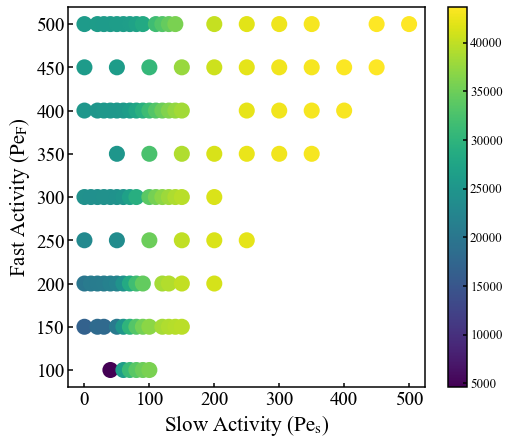

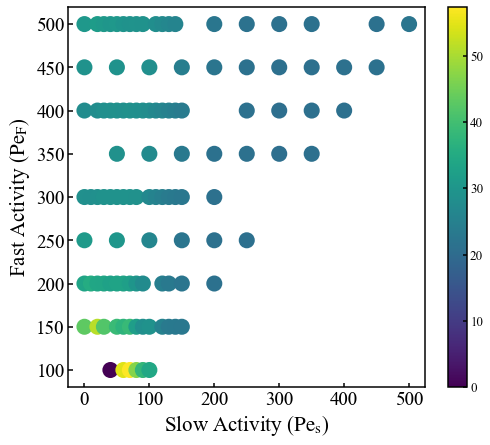

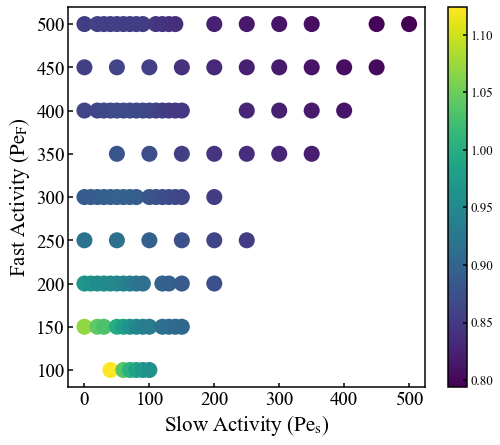

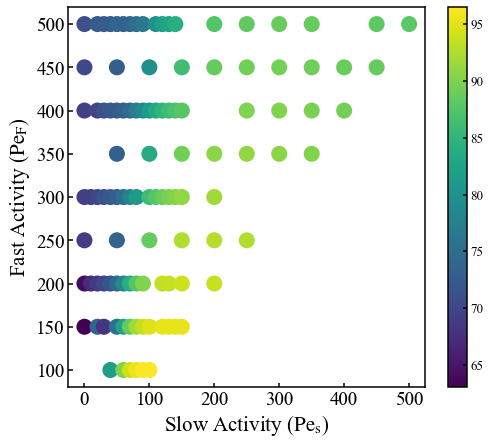

NameError: name 'phi_dense_sim' is not defined

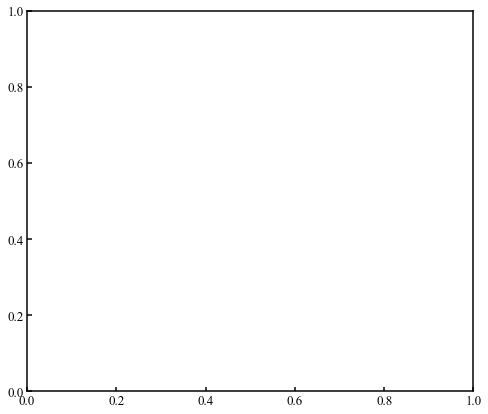

In [54]:
from scipy.stats import kde

nowhere = np.where(interpart_peA>=0)[0]
s_theory=20

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=5
from scipy.optimize import curve_fit

nonzero = np.where(interpart_peA>=0)[0]

fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=avg_clust[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=avg_width[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=all_lat_time_mean[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=avg_rad[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=phi_dense_sim[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()
fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=phi_gas_sim2[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=align_press_arr[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))

sc = plt.scatter(interpart_peA[nonzero], interpart_peB[nonzero], c=interpart_press[nonzero], linewidth = 1.8*1.2, s=msz*55*0.7)
plt.colorbar(sc)

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{s}$)', fontsize=fsize*2.1)



plt.show()

In [37]:
import matplotlib.patches as mpatches
from matplotlib import cm
import matplotlib.patches as patches

lat_theory_mean_int = np.zeros(len(interpart_peNet))
lat_theory_mean_bulk = np.zeros(len(interpart_peNet))

lat_theory_mean_dense = np.zeros(len(interpart_peNet))

gas_pe_net = np.zeros(len(interpart_peNet))

dense_pe_net = np.zeros(len(interpart_peNet))
bulk_pe_net = np.zeros(len(interpart_peNet))
int_pe_net = np.zeros(len(interpart_peNet))
pe_dif_arr = np.zeros(len(interpart_peNet))
pe_rat_arr = np.zeros(len(interpart_peNet))

beta_theory = np.zeros(len(interpart_peNet))
beta_theory2 = np.zeros(len(interpart_peNet))

beta_theory3 = np.zeros(len(interpart_peNet))
beta_theory4 = np.zeros(len(interpart_peNet))

phi_gas_sim = np.zeros(len(interpart_peNet))



avg_area2 = np.zeros(len(interpart_peNet))

div = (1.0/bulk_lat_mean)
dU = (24.) * ((2*(div**13)) - (div)**7)
phi_cp = np.pi / (2*np.sqrt(3))
area_box = (50000 * (np.pi/4))/0.6


int_pe_net_theory = np.linspace(45, 500, num=451)
pe_rat_arr = np.linspace(0, 1, num=451)

phi_gas_theory2 = np.zeros(len(int_pe_net_theory))
phi_dense_theory2 = np.zeros(len(int_pe_net_theory))
clust_theory2 = np.zeros(len(int_pe_net_theory))
rad_theory2 = np.zeros(len(int_pe_net_theory))
press_theory2 = np.zeros(len(int_pe_net_theory))
width_theory2 = np.zeros(len(int_pe_net_theory))

lat_theory_mean_int_theory = np.zeros(len(int_pe_net_theory))


phi_gas_theory3 = np.zeros(len(interpart_peNet))
phi_gas_theory4 = np.zeros(len(interpart_peNet))
phi_gas_theory5 = np.zeros(len(interpart_peNet))

phi_gas_theory = np.zeros(len(interpart_peNet))
phi_dense_theory = np.zeros(len(interpart_peNet))
clust_theory = np.zeros(len(interpart_peNet))
rad_theory = np.zeros(len(interpart_peNet))
press_theory = np.zeros(len(interpart_peNet))
width_theory = np.zeros(len(interpart_peNet))
#lat_theory_mean_int_theory = np.zeros(len(interpart_peNet))
slow_frac_dense = np.zeros(len(interpart_peNet))
fast_frac_dense = np.zeros(len(interpart_peNet))
slow_frac_int = np.zeros(len(interpart_peNet))
fast_frac_int = np.zeros(len(interpart_peNet))
slow_frac_bulk = np.zeros(len(interpart_peNet))
fast_frac_bulk = np.zeros(len(interpart_peNet))
slow_frac_gas = np.zeros(len(interpart_peNet))
fast_frac_gas = np.zeros(len(interpart_peNet))
phi_dense_sim = np.zeros(len(interpart_peNet))
phi_gas_sim2 = np.zeros(len(interpart_peNet))


for p in range(0, len(interpart_peNet)):

    gas_pe_net[p]=(((avg_gas_nA[p]/avg_gas_n[p]) * interpart_peA[p] + (avg_gas_nB[p]/avg_gas_n[p]) * interpart_peB[p]))
    dense_pe_net[p]=(((avg_dense_nA[p]/avg_dense_n[p]) * interpart_peA[p] + (avg_dense_nB[p]/avg_dense_n[p]) * interpart_peB[p]))
    bulk_pe_net[p]=((avg_bulk_nA[p]/avg_bulk_n[p]) * interpart_peA[p] + (avg_bulk_nB[p]/avg_bulk_n[p]) * interpart_peB[p])
    int_pe_net[p]=(((avg_int_nA[p]/avg_int_n[p]) * interpart_peA[p] + (avg_int_nB[p]/avg_int_n[p]) * interpart_peB[p]))
    pe_dif_arr[p] = np.abs(interpart_peB[p] - interpart_peA[p])
    pe_rat_arr[p] = np.abs(interpart_peA[p] / interpart_peB[p])
    
    beta_theory[p] = dU[p]/interpart_peB[p]
    #print(beta_theory[p])
    beta_theory2[p] = dU[p]/bulk_pe_net[p]
    beta_theory3[p] = dU[p]/dense_pe_net[p]
    beta_theory4[p] = dU[p]/interpart_peNet[p]
    lat_theory_mean_int[p] = conForRClust(int_pe_net[p]-50, 1.0)
    lat_theory_mean_bulk[p] = conForRClust(bulk_pe_net[p]-50, 1.0)
    lat_theory_mean_dense[p] = conForRClust(dense_pe_net[p]-50, 1.0)
    fast_frac_dense[p] = avg_dense_nB[p]/avg_dense_n[p]
    slow_frac_dense[p] = avg_dense_nA[p]/avg_dense_n[p]
    
    fast_frac_int[p] = avg_int_nB[p]/avg_int_n[p]
    slow_frac_int[p] = avg_int_nA[p]/avg_int_n[p]
    
    fast_frac_bulk[p] = avg_bulk_nB[p]/avg_bulk_n[p]
    slow_frac_bulk[p] = avg_bulk_nA[p]/avg_bulk_n[p]
    
    fast_frac_gas[p] = avg_gas_nB[p]/avg_gas_n[p]
    slow_frac_gas[p] = avg_gas_nA[p]/avg_gas_n[p]
    
    phi_dense_sim[p] = avg_dense_n[p] * (np.pi/4)
    phi_gas_sim[p] = ((50000-avg_clust[p]) * (np.pi/4)) /(area_box - np.pi * avg_rad[p]**2)
    phi_gas_sim2[p] = avg_gas_n[p] * (np.pi/4)
    phi_dense_theory[p] = phi_cp / lat_theory_mean_int[p]**2 
    phi_gas_theory4[p] = (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int[p] * int_pe_net[p]) ** (-1))
    phi_gas_theory3[p] = (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int[p] * dense_pe_net[p]) ** (-1))
    phi_gas_theory[p] = (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int[p] * gas_pe_net[p]) ** (-1))

    phi_gas_theory5[p] = (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int[p] * bulk_pe_net[p]) ** (-1))
    
    clust_theory[p] = 50000* (((phi_gas_theory[p]-0.6)*phi_dense_theory[p])/(0.6*(phi_gas_theory[p]-phi_dense_theory[p])))
    avg_area2[p] = avg_clust[p] / (np.pi * avg_rad[p]**2)
    press_theory[p] = (int_pe_net[p]-50) * 2 * np.sqrt(3) * 1.874 /lat_theory_mean_int[p]
    rad_theory[p] =  ((avg_clust[p] / (4*phi_cp))**0.5) * lat_theory_mean_int[p]
    width_theory[p] = (np.sqrt(3)/(2*0.5)) * (press_theory[p]/int_pe_net[p]) * lat_theory_mean_int[p]**2 * 3.0
pe_crit=np.min(int_pe_net_theory)

slow_act_temp = np.array([])
fast_act_temp = np.array([])
act_rat_temp = np.array([])
pe_net_int_arr = np.array([])
pe_net_gas_arr = np.array([])
lat_theory_mean_int_theory_temp = np.array([])
phi_dense_theory_temp = np.array([])
phi_gas_theory_temp = np.array([])
net_act_temp = np.array([])
clust_theory_temp = np.array([])
press_theory_temp = np.array([])
rad_theory_temp = np.array([])
width_theory_temp = np.array([])

int_pe_net_theory = np.linspace(50, 500, num=501)

def densProbability(r, activity_net, activity_fast, phi_dense_val, phi_gas_val):
    "Using similar triangles to find sides"
    gas_dense_dif_phi = phi_dense_val - phi_gas_val
    rate_decay = -8.77 * np.log10(activity_fast-45) - 42.188
    mid_point = 0.028 * np.log10(activity_net-45) + 0.882
    gas_phi = phi_gas_val

    num_dens_r = ((gas_dense_dif_phi / (1+np.exp(-rate_decay * (r-mid_point)))) + phi_gas_val)

    return num_dens_r

def alignProbability(r, activity_net, activity_slow):
    "Using similar triangles to find sides"
    max_align = 0.175 * np.log10(activity_net - 45) - 0.15
    mid_point = 0.077 * np.log10(activity_slow - 45) + 0.76
    std_dev = 0.115
    align_r = max_align * np.exp(-(r-mid_point)**2/(2*std_dev**2))

    return align_r

radius_arr_temp = np.linspace(0, 1.6, num=60)

press_theory_val_arr = np.array([])
for a in range(0, len(int_pe_net_theory)):
    print(a)
    for b in range(0, len(int_pe_net_theory)):
        if int_pe_net_theory[a]<=int_pe_net_theory[b]:
            slow_act_temp_val = int_pe_net_theory[a]
            fast_act_temp_val = int_pe_net_theory[b]
            act_rat_temp_val = slow_act_temp_val/fast_act_temp_val
            
            net_act_temp_val = 0.5*int_pe_net_theory[a] + 0.5*int_pe_net_theory[b]
            if act_rat_temp_val * net_act_temp_val >= 0.:
                slow_act_temp = np.append(slow_act_temp, slow_act_temp_val)
                fast_act_temp = np.append(fast_act_temp, fast_act_temp_val)
                net_act_temp = np.append(net_act_temp, net_act_temp_val)
                act_rat_temp = np.append(act_rat_temp, act_rat_temp_val)

                act_int_rat_temp = int_pe_net_theory[a]/int_pe_net_theory[b]
                chi_f_int = 0.17/(1+np.exp(11.082*(act_int_rat_temp-0.261)))+0.5
                chi_f_gas = -0.246 / (1+np.exp(6.621 * (x-0.545) ) ) + 0.5
                if int_pe_net_theory[a]<50:
                    act_int_rat_temp = int_pe_net_theory[b]
                    chi_f_int = 0.448 + 0.088 * np.log10(int_pe_net_theory[b]-95.844)
                                        
                else:
                    act_int_rat_temp = int_pe_net_theory[a]/int_pe_net_theory[b]
                    chi_f_int = 0.17/(1+np.exp(11.082*(act_int_rat_temp-0.261)))+0.5
                
                pe_net_int_temp = chi_f_int * int_pe_net_theory[b] + (1.0-chi_f_int)*int_pe_net_theory[a]
                pe_net_int_arr = np.append(pe_net_int_arr, pe_net_int_temp)
                pe_net_gas_temp = chi_f_gas * int_pe_net_theory[b] + (1.0-chi_f_gas) * int_pe_net_theory[a]
                pe_net_gas_arr = np.append(pe_net_gas_arr, pe_net_gas_temp)
                
                lat_theory_mean_int_theory_temp = np.append(lat_theory_mean_int_theory_temp, conForRClust(pe_net_int_arr[-1]-pe_crit, 1.0))
                phi_dense_theory_temp = np.append(phi_dense_theory_temp, phi_cp / lat_theory_mean_int_theory_temp[-1]**2 )
                #if ((act_rat_temp[-1] * net_act_temp[-1]) >=50) | (slow_act_temp[-1]>=0):
                phi_gas_theory_temp = np.append(phi_gas_theory_temp, (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int_theory_temp[-1] * (act_rat_temp[-1]*(net_act_temp[-1])+pe_crit)) ** (-1)))
                #else:
                #    phi_gas_theory_temp = np.append(phi_gas_theory_temp, 0.5)
                clust_theory_temp = np.append(clust_theory_temp, 50000* (((phi_gas_theory_temp[-1]-0.6)*phi_dense_theory_temp[-1])/(0.6*(phi_gas_theory_temp[-1]-phi_dense_theory_temp[-1]))))
                
                press_theory_temp = np.append(press_theory_temp, (pe_net_int_arr[-1]-pe_crit) * 2 * np.sqrt(3) * 1.874 /lat_theory_mean_int_theory_temp[-1])
                rad_theory_temp =  np.append(rad_theory_temp, ((clust_theory_temp[-1] / (4*phi_cp))**0.5) * lat_theory_mean_int_theory_temp[-1])
                width_theory_temp = np.append(width_theory_temp, (np.sqrt(3)/(2*0.5)) * (press_theory_temp[-1]/pe_net_int_arr[-1]) * lat_theory_mean_int_theory_temp[-1]**2 * 3.0)
                #width_theory_temp = np.append(width_theory_temp, (np.sqrt(3)/(2*0.5)) * (press_theory_temp[-1]/(act_rat_temp[-1]*)) * lat_theory_mean_int_theory_temp[-1]**2 * 3.0)
                '''
                dens_temp = densProbability(radius_arr_temp, pe_net_int_arr[-1], int_pe_net_theory[b], phi_dense_theory_temp[-1], phi_gas_theory_temp[-1])
                align_temp = alignProbability(radius_arr_temp, pe_net_int_arr[-1], int_pe_net_theory[a])
                press = dens_temp * align_temp * pe_net_int_arr[-1]
                press_int = 0
                for m in range(1, len(press)):
                    press_int += ((press[m-1]+press[m])/2)*(radius_arr_temp[m]-radius_arr_temp[m-1]) * rad_theory_temp[-1]
                press_theory_val_arr = np.append(press_theory_val_arr, press_int)
                '''

act_range = np.linspace(0, 500, num=101)

weight_rat_net_2 = act_rat_temp * net_act_temp
weight_rat_net_4 = (act_rat_temp**2) * net_act_temp

clust_theory_max = np.array([])
clust_theory_min = np.array([])
act_range_rat2 = np.array([])
lat_theory_line = np.array([])
dense_theory_line = np.array([])
press_theory_line = np.array([])
avg_rad_theory_max = np.array([])
avg_rad_theory_min = np.array([])

phi_gas_theory_max = np.array([])
phi_gas_theory_min = np.array([])

for p in range(1, len(act_range)):
    temp_loc = np.where((weight_rat_net_2<act_range[p]) & (act_range[p-1]<=weight_rat_net_2))[0]
    if len(temp_loc)>0:
        act_range_rat2 = np.append(act_range_rat2, act_range[p-1])
        clust_theory_max = np.append(clust_theory_max, np.max(clust_theory_temp[temp_loc]))
        clust_theory_min = np.append(clust_theory_min, np.min(clust_theory_temp[temp_loc]))
        phi_gas_theory_max = np.append(phi_gas_theory_max, np.max(phi_gas_theory_temp[temp_loc]))
        phi_gas_theory_min = np.append(phi_gas_theory_min, np.min(phi_gas_theory_temp[temp_loc]))

act_range_rat4 = np.array([])        
for p in range(1, len(act_range)):
    temp_loc = np.where((weight_rat_net_4<act_range[p]) & (act_range[p-1]<=weight_rat_net_4))[0]
    if len(temp_loc)>0:
        act_range_rat4 = np.append(act_range_rat4, act_range[p-1])
        avg_rad_theory_max = np.append(avg_rad_theory_max, np.max(rad_theory_temp[temp_loc]))
        avg_rad_theory_min = np.append(avg_rad_theory_min, np.min(rad_theory_temp[temp_loc]))

act_range_net_int = np.array([])        
for p in range(1, len(act_range)):
    temp_loc = np.where((pe_net_int_arr<act_range[p]) & (act_range[p-1]<=pe_net_int_arr))[0]
    if len(temp_loc)>0:
        act_range_net_int = np.append(act_range_net_int, act_range[p-1])        
        lat_theory_line = np.append(lat_theory_line, np.mean(lat_theory_mean_int_theory_temp[temp_loc]))
        dense_theory_line = np.append(dense_theory_line, np.mean(phi_dense_theory_temp[temp_loc]))
        press_theory_line = np.append(press_theory_line, np.mean(press_theory_temp[temp_loc]))
        
int_pe_net_theory = np.linspace(45, 500, num=451)

for p in range(0, len(int_pe_net_theory)):
        lat_theory_mean_int_theory[p] = conForRClust(int_pe_net_theory[p]-pe_crit, 1.0)
        phi_dense_theory2[p] = phi_cp / lat_theory_mean_int_theory[p]**2 
        phi_gas_theory2[p] = (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int_theory[p] * (int_pe_net_theory[p])) ** (-1))
        clust_theory2[p] = 50000* (((phi_gas_theory2[p]-0.6)*phi_dense_theory2[p])/(0.6*(phi_gas_theory2[p]-phi_dense_theory2[p])))
        press_theory2[p] = (int_pe_net_theory[p]-pe_crit) * 2 * np.sqrt(3) * 1.874 /lat_theory_mean_int_theory[p]
        rad_theory2[p] =  ((clust_theory2[p] / (4*phi_cp))**0.5) * lat_theory_mean_int_theory[p]
        width_theory2[p] = (np.sqrt(3)/(2*0.5)) * (press_theory2[p]/int_pe_net_theory[p]) * lat_theory_mean_int_theory[p]**2 * 3.0


print(phi_gas_theory)

phi_gas_test = np.zeros(len(interpart_peNet))
phi_dense_test = np.zeros(len(interpart_peNet))
clust_test = np.zeros(len(interpart_peNet))
rad_test = np.zeros(len(interpart_peNet))
press_test = np.zeros(len(interpart_peNet))
width_test = np.zeros(len(interpart_peNet))
avg_area_test = np.zeros(len(interpart_peNet))
lat_theory_test = np.zeros(len(interpart_peNet))
pe_rat_arr_test = np.zeros(len(interpart_peNet))
int_pe_net_test = np.zeros(len(interpart_peNet))

for p in range(0, len(interpart_peNet)):

    int_pe_net_test[p]=(((avg_int_nA[p]/avg_int_n[p]) * interpart_peA[p] + (avg_int_nB[p]/avg_int_n[p]) * interpart_peB[p]))
    pe_rat_arr_test[p] = np.abs(interpart_peA[p] / interpart_peB[p])

    lat_theory_test[p] = conForRClust(int_pe_net[p]-50, 1.0)
    phi_gas_test[p] = (3 * np.pi**2 * 4.5/4) * ((lat_theory_test[p] * (pe_rat_arr_test[p]*(int_pe_net_test[p])+pe_crit)) ** (-1))
    phi_dense_test[p] = phi_cp / lat_theory_test[p]**2     
    clust_test[p] = 50000* (((phi_gas_test[p]-0.6)*phi_dense_test[p])/(0.6*(phi_gas_test[p]-phi_dense_test[p])))
    rad_test[p] =  ((clust_test[p] / (4*phi_cp))**0.5) * lat_theory_test[p]
    avg_area_test[p] = clust_test[p] / (np.pi * rad_test[p]**2)
    press_test[p] = (int_pe_net_test[p]-50) * 2 * np.sqrt(3) * 1.874 /lat_theory_test[p]
    width_test[p] = (np.sqrt(3)/(2*0.5)) * (press_test[p]/int_pe_net_test[p]) * lat_theory_test[p]**2 * 3.0
    
percent_error_lat = ((all_lat_time_mean - lat_theory_test)/lat_theory_test)*100
percent_error_gas = ((phi_gas_sim2 - phi_gas_test)/phi_gas_test)*100
percent_error_dense = ((phi_dense_sim - phi_dense_test)/phi_dense_test)*100
percent_error_clust = ((avg_clust - clust_test)/clust_test)*100
percent_error_rad = ((avg_rad - rad_test)/rad_test)*100
percent_error_press = ((interpart_press - press_test)/press_test)*100
percent_error_width = ((avg_width - width_test)/width_test)*100




/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_90241/1813069967.py:76: RuntimeWarning: invalid value encountered in double_scalars
  bulk_pe_net[p]=((avg_bulk_nA[p]/avg_bulk_n[p]) * interpart_peA[p] + (avg_bulk_nB[p]/avg_bulk_n[p]) * interpart_peB[p])
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_90241/1813069967.py:95: RuntimeWarning: invalid value encountered in double_scalars
  fast_frac_bulk[p] = avg_bulk_nB[p]/avg_bulk_n[p]
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_90241/1813069967.py:96: RuntimeWarning: invalid value encountered in double_scalars
  slow_frac_bulk[p] = avg_bulk_nA[p]/avg_bulk_n[p]


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_90241/1813069967.py:261: RuntimeWarning: invalid value encountered in double_scalars
  rad_theory2[p] =  ((clust_theory2[p] / (4*phi_cp))**0.5) * lat_theory_mean_int_theory[p]
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_90241/1813069967.py:287: RuntimeWarning: invalid value encountered in double_scalars
  rad_test[p] =  ((clust_test[p] / (4*phi_cp))**0.5) * lat_theory_test[p]


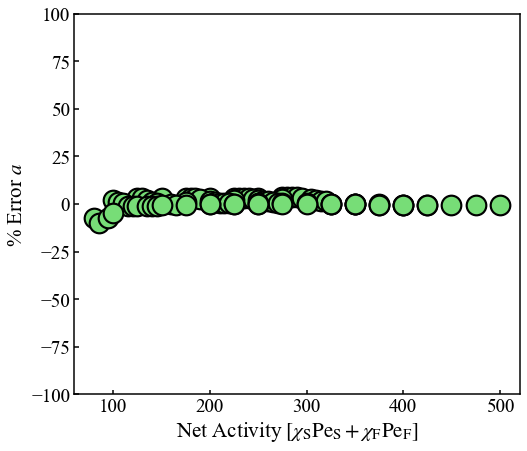

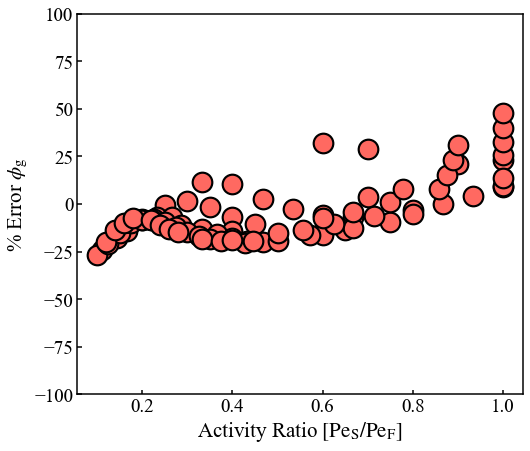

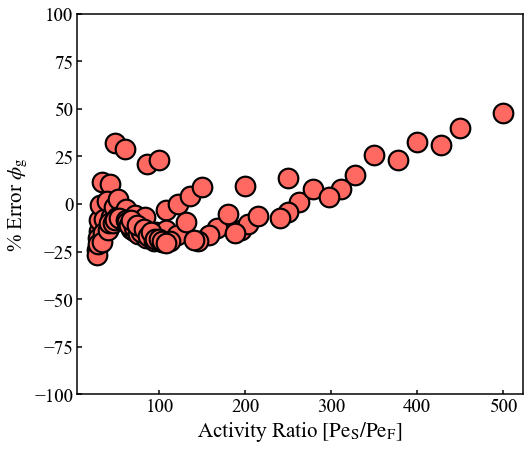

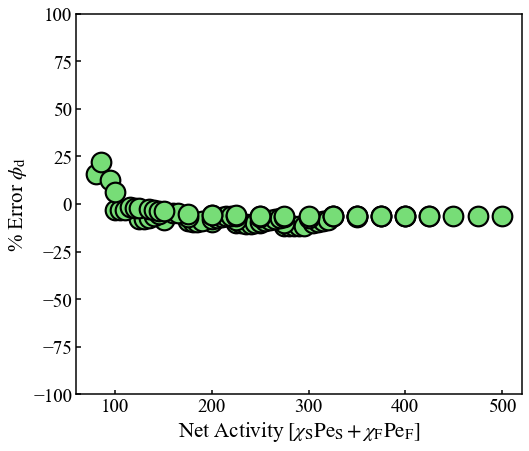

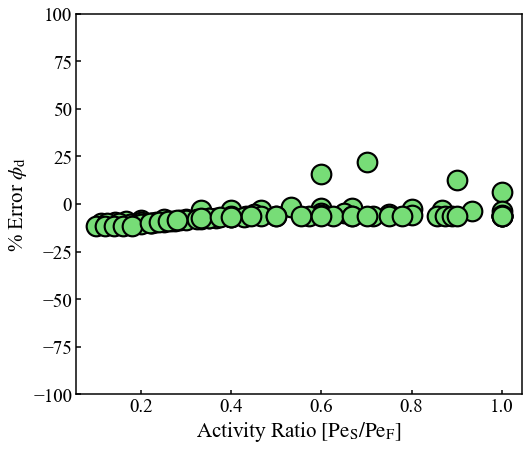

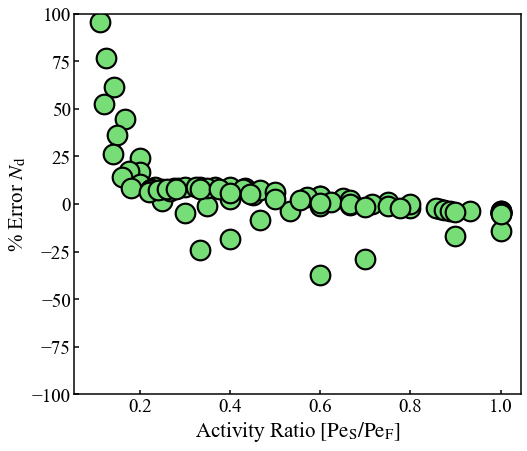

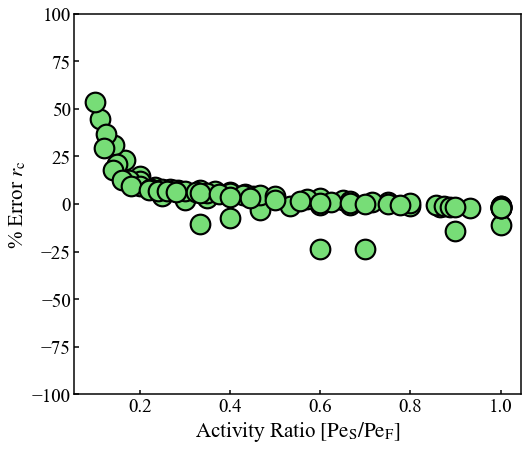

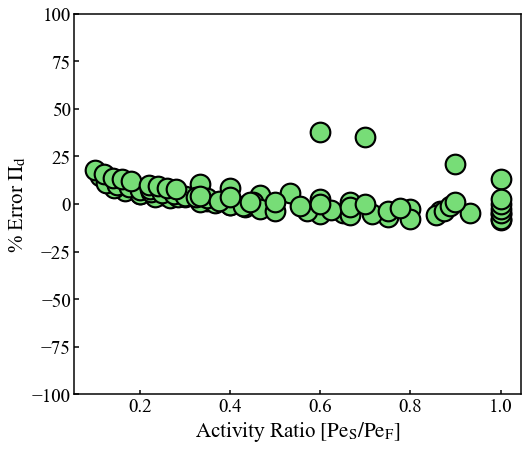

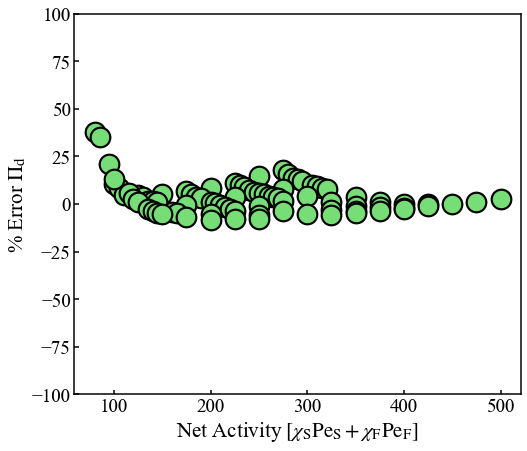

In [54]:
test_ind = np.where(percent_error_clust<=100)[0]
test_ind = np.where(interpart_peA>=50)[0]
mkSz = [0.8, 0.8]
msz=10
fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind] * 0.5 + 0.5 * interpart_peB[test_ind], percent_error_lat[test_ind], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $a$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Net Activity $[\chi_\mathrm{S} \mathrm{Pe}_\mathrm{S} + \chi_\mathrm{F} \mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind]/interpart_peB[test_ind], percent_error_gas[test_ind], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $\phi_\mathrm{g}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio $[\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter((interpart_peA[test_ind]/interpart_peB[test_ind]) * (interpart_peA[test_ind] * 0.5 + 0.5* interpart_peB[test_ind]), percent_error_gas[test_ind], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $\phi_\mathrm{g}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio $[\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind] * 0.5 + 0.5* interpart_peB[test_ind], percent_error_dense[test_ind], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $\phi_\mathrm{d}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Net Activity $[\chi_\mathrm{S} \mathrm{Pe}_\mathrm{S} + \chi_\mathrm{F} \mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind]/interpart_peB[test_ind], percent_error_dense[test_ind], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $\phi_\mathrm{d}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio $[\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind]/interpart_peB[test_ind], percent_error_clust[test_ind], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $N_\mathrm{d}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio $[\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind]/interpart_peB[test_ind], percent_error_rad[test_ind], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $r_\mathrm{c}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio $[\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind]/interpart_peB[test_ind], percent_error_press[test_ind], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $\Pi_\mathrm{d}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio $[\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(interpart_peA[test_ind] * 0.5 + 0.5 * interpart_peB[test_ind], percent_error_press[test_ind], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error $\Pi_\mathrm{d}$', fontsize=fsize*2.1)
ax1.set_xlabel(r'Net Activity $[\chi_\mathrm{S} \mathrm{Pe}_\mathrm{S} + \chi_\mathrm{F} \mathrm{Pe}_\mathrm{F}]$', fontsize=fsize*2.1)
ax1.set_ylim([-100,100])
plt.show()


In [52]:
from scipy.stats import kde
test_arr = np.where(rad_theory_temp>=100)[0]
print(slow_act_temp[test_arr])
print(fast_act_temp[test_arr])
print(net_act_temp[test_arr])
nowhere = np.where(interpart_peA>=0)[0]
s_theory=20
weighted_rat_theory = (0.5*(slow_act_temp/fast_act_temp)**0.5+0.5*(fast_act_temp/fast_act_temp)**0.5) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat2_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)#pe_net_int_arr #pretty much the same as weighted_rat3
weighted_rat3_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat4_theory = ((slow_act_temp/fast_act_temp)**(2)) * (0.5*slow_act_temp + 0.5*fast_act_temp)

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
print(len(int_pe_net))
print(len(avg_clust))
from scipy.optimize import curve_fit

nonzero = np.where(phi_dense_sim>=0.7)[0]
nonzero = np.where(interpart_peA>=0)[0]

fig, ax1 = plt.subplots(figsize=(8,7))
fast_leg=[]
mkSz = [0.8, 0.8]
msz=5
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=slowCol,
                      markerfacecolor='None', 
                      label='Slow Interface', markersize=(2.4*msz * mkSz[0])))

weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB) #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)


#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_clust[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_clust[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat2_theory, clust_theory_temp, color='black', s=s_theory)
#ax1.fill_between(act_range_final, clust_theory_min, clust_theory_max, color='black', alpha=0.2)

#data = np.array([weighted_rat2_theory, clust_theory_temp])
#print(np.shape(data))

#k = kde.gaussian_kde(data)
#nbins= 100
#xi, yi = np.mgrid[weighted_rat2_theory.min():weighted_rat2_theory.max():nbins*1j, clust_theory_temp.min():clust_theory_temp.max():nbins*1j]
#zi = k(np.vstack([xi.flatten(), yi.flatten()]))

#ax1.pcolormesh(xi, yi, zi.reshape(xi.shape), shading='auto', cmap=plt.cm.Blues)
#ax1.contourf(xi, yi, zi.reshape(xi.shape))
plt.scatter(weighted_rat2_theory, clust_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, clust_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, clust_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)
plt.scatter(weighted_rat2[nonzero], avg_clust[nonzero], facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()




weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)





fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(pe_net_int_arr, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/lat_theory_mean_int_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Lattice Spacing ($h/a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Cluster Radius ($h/r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10
ax1.set_ylim([0, 1])


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr, lat_theory_mean_int_theory_temp, color='black', s=s_theory)


plt.plot(act_range_net_int, lat_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([50.0,520.0])
ax1.set_ylim([0, 1.2])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Lattice Spacing ($a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

msz = 5
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

plt.scatter(weighted_rat4_theory, rad_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat4, avg_rad_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat4, avg_rad_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat4[nonzero], avg_rad[nonzero], facecolor='none',edgecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat4_theory, rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 140])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})^2\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz = 10

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)


plt.show()


msz=5

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Gas Area Fraction ($\phi_\mathrm{g}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))



leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Gas Area Fraction ($\phi_\mathrm{g}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))



leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)




plt.show()
msz = 5.0
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim2[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Gas Area Fraction ($\phi_\mathrm{g}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)




plt.show()


msz=10


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')



#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], phi_dense_sim[nonzero], facecolor=green,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, phi_dense_theory_temp, color='black',s=s_theory)
plt.plot(act_range_net_int, dense_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Dense Area Fraction ($\phi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

error = 100*(phi_gas_sim-phi_gas_theory)/phi_gas_theory
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory3)/phi_gas_theory3
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory4)/phi_gas_theory4
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory5)/phi_gas_theory5
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, facecolor=green,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, press_theory_temp, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()
print(len(pe_net_int_arr))
print(len(press_theory_val_arr))

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr,press_theory_val_arr, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)


ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter((interpart_peB-interpart_peA), align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr,press_theory_val_arr, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)


ax1.set_xlim([0.0, 500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net, align_press_arr, edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interparticle Pressure ($\Pi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)


plt.show()




NameError: name 'rad_theory_temp' is not defined

[ 50.   50.   50.  ... 117.5 117.5 118.4]
[ 50.   50.9  51.8 ... 117.5 118.4 118.4]
[ 50.    50.45  50.9  ... 117.5  117.95 118.4 ]
109
109


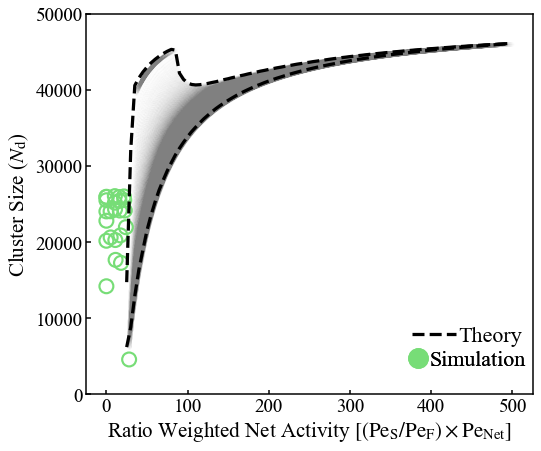

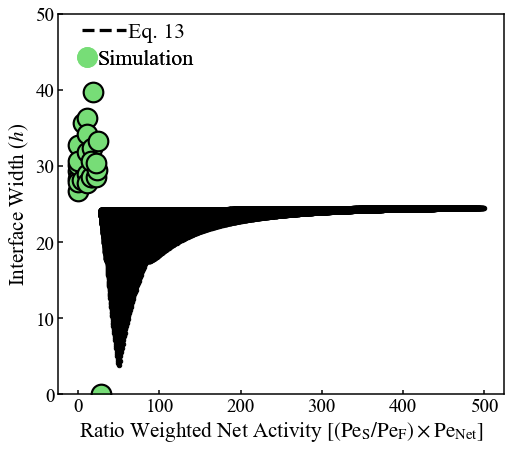

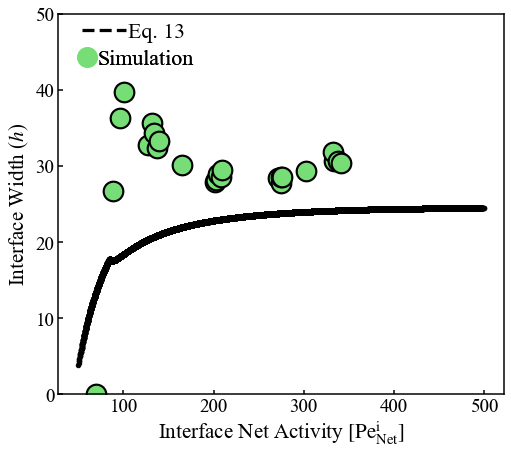

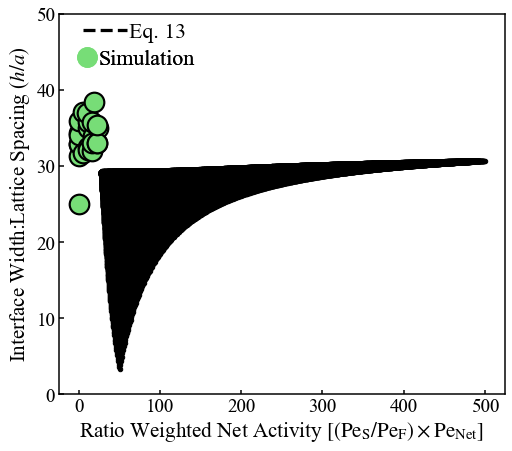

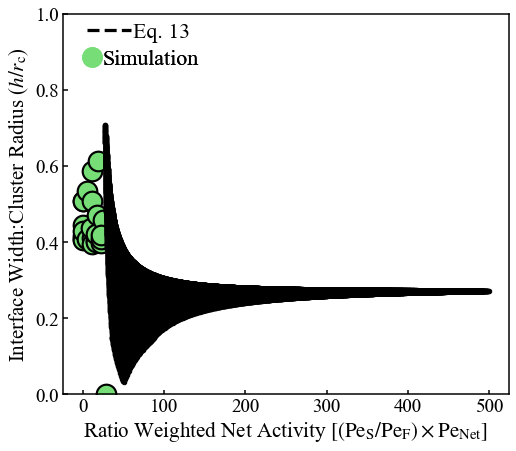

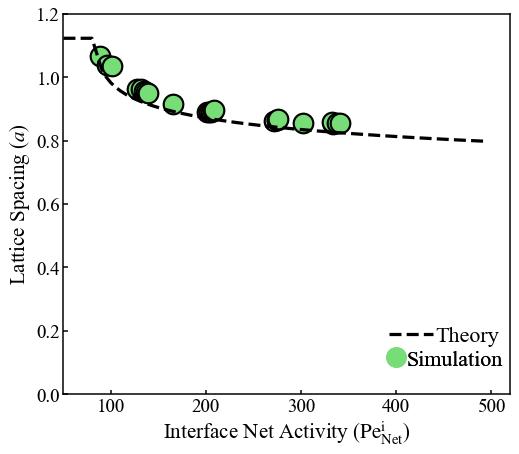

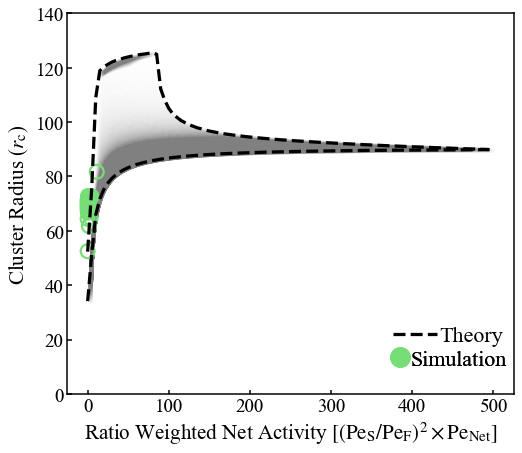

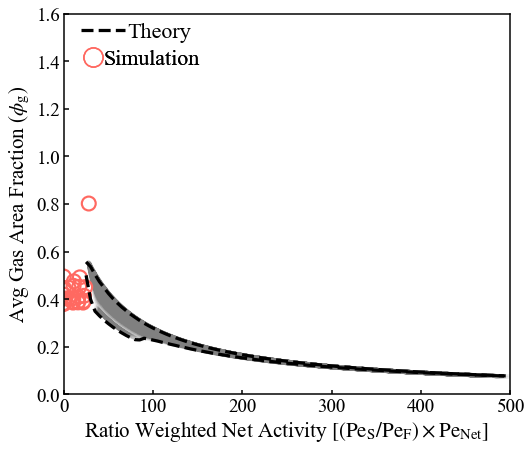

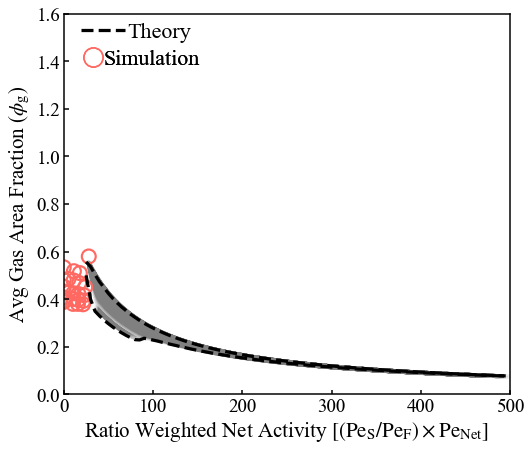

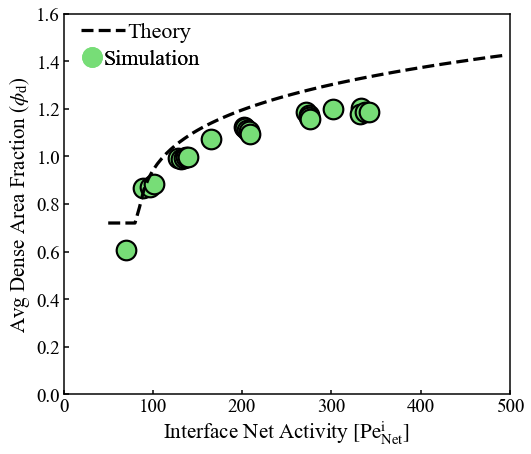

31.117593228305267
23.767828189455486
83.87559769868237
71.94079522945229
80.58956087073985
69.4685331555435
nan
nan


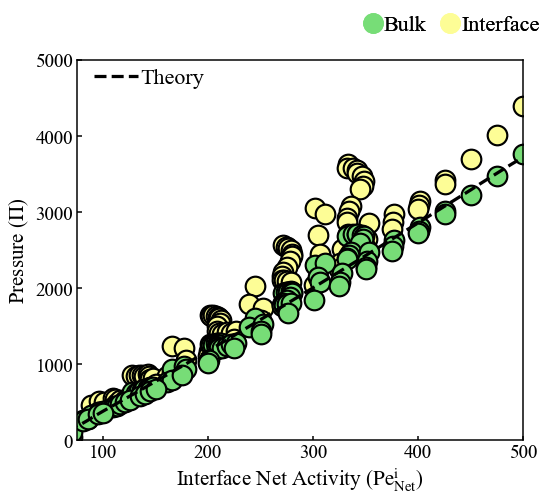

125751
0


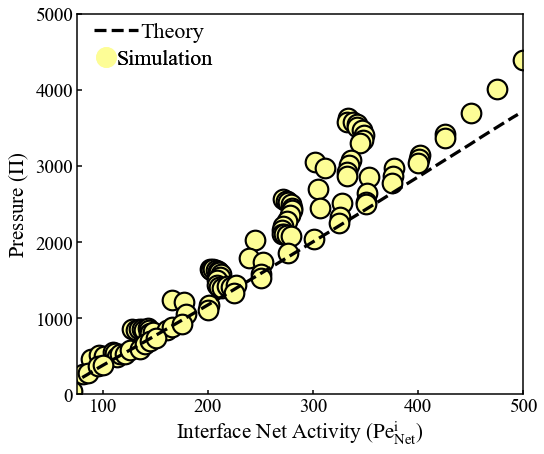

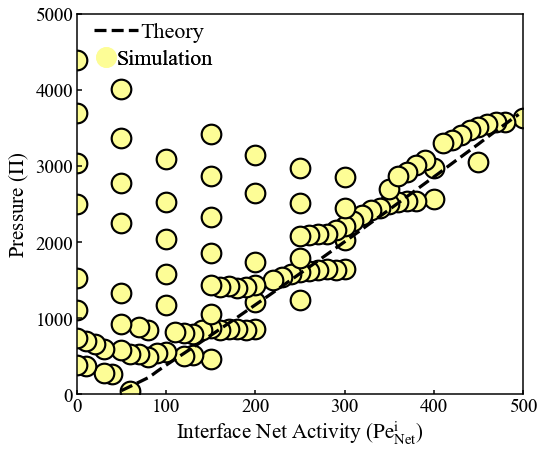

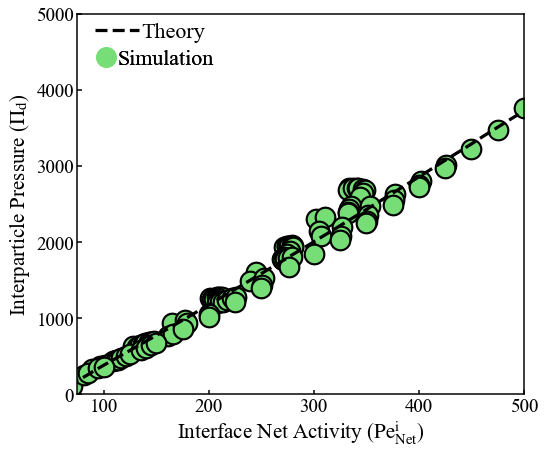

In [34]:
from scipy.stats import kde
test_arr = np.where(rad_theory_temp>=100)[0]
print(slow_act_temp[test_arr])
print(fast_act_temp[test_arr])
print(net_act_temp[test_arr])
nowhere = np.where(interpart_peA<50)[0]
s_theory=20
weighted_rat_theory = (0.5*(slow_act_temp/fast_act_temp)**0.5+0.5*(fast_act_temp/fast_act_temp)**0.5) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat2_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)#pe_net_int_arr #pretty much the same as weighted_rat3
weighted_rat3_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat4_theory = ((slow_act_temp/fast_act_temp)**(2)) * (0.5*slow_act_temp + 0.5*fast_act_temp)

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
print(len(int_pe_net))
print(len(avg_clust))
from scipy.optimize import curve_fit

nonzero = np.where(phi_dense_sim>=0.7)[0]
nonzero = nowhere = np.where(interpart_peA<50)[0]

fig, ax1 = plt.subplots(figsize=(8,7))
fast_leg=[]
mkSz = [0.8, 0.8]
msz=5
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=slowCol,
                      markerfacecolor='None', 
                      label='Slow Interface', markersize=(2.4*msz * mkSz[0])))

weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB) #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)


#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_clust[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_clust[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat2_theory, clust_theory_temp, color='black', s=s_theory)
#ax1.fill_between(act_range_final, clust_theory_min, clust_theory_max, color='black', alpha=0.2)

#data = np.array([weighted_rat2_theory, clust_theory_temp])
#print(np.shape(data))

#k = kde.gaussian_kde(data)
#nbins= 100
#xi, yi = np.mgrid[weighted_rat2_theory.min():weighted_rat2_theory.max():nbins*1j, clust_theory_temp.min():clust_theory_temp.max():nbins*1j]
#zi = k(np.vstack([xi.flatten(), yi.flatten()]))

#ax1.pcolormesh(xi, yi, zi.reshape(xi.shape), shading='auto', cmap=plt.cm.Blues)
#ax1.contourf(xi, yi, zi.reshape(xi.shape))
plt.scatter(weighted_rat2_theory, clust_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, clust_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, clust_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)
plt.scatter(weighted_rat2[nonzero], avg_clust[nonzero], facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()




weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)





fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(pe_net_int_arr, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/lat_theory_mean_int_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Lattice Spacing ($h/a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Cluster Radius ($h/r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10
ax1.set_ylim([0, 1])


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr, lat_theory_mean_int_theory_temp, color='black', s=s_theory)


plt.plot(act_range_net_int, lat_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([50.0,520.0])
ax1.set_ylim([0, 1.2])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Lattice Spacing ($a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

msz = 5
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

plt.scatter(weighted_rat4_theory, rad_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat4, avg_rad_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat4, avg_rad_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat4[nonzero], avg_rad[nonzero], facecolor='none',edgecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat4_theory, rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 140])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})^2\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz = 10

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)


plt.show()


msz=5


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Gas Area Fraction ($\phi_\mathrm{g}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))



leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)




plt.show()
msz = 5.0
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim2[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Gas Area Fraction ($\phi_\mathrm{g}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)




plt.show()


msz=10


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')



#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], phi_dense_sim[nonzero], facecolor=green,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, phi_dense_theory_temp, color='black',s=s_theory)
plt.plot(act_range_net_int, dense_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Dense Area Fraction ($\phi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

error = 100*(phi_gas_sim-phi_gas_theory)/phi_gas_theory
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory3)/phi_gas_theory3
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory4)/phi_gas_theory4
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory5)/phi_gas_theory5
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, facecolor=green,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, press_theory_temp, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()
print(len(pe_net_int_arr))
print(len(press_theory_val_arr))

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr,press_theory_val_arr, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)


ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter((interpart_peB-interpart_peA), align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr,press_theory_val_arr, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)


ax1.set_xlim([0.0, 500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net, align_press_arr, edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interparticle Pressure ($\Pi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)


plt.show()




[ 16.  17.  17. ... 117. 117. 118.]
[ 16.  17.  18. ... 117. 118. 118.]
[ 16.   17.   17.5 ... 117.  117.5 118. ]
109
109


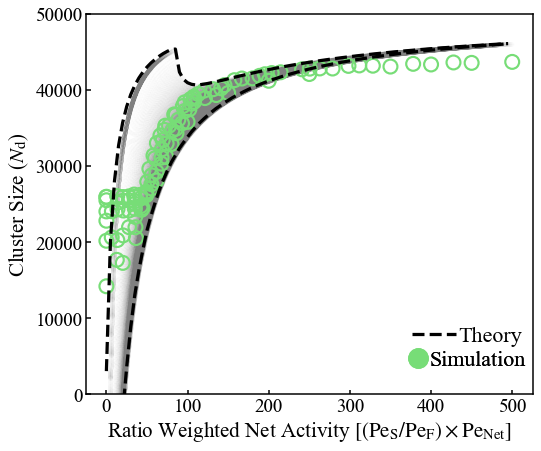

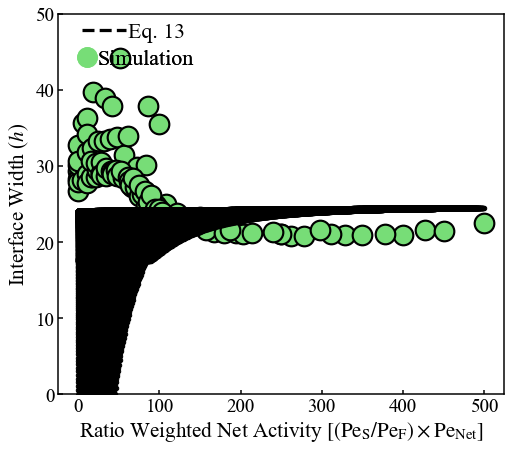

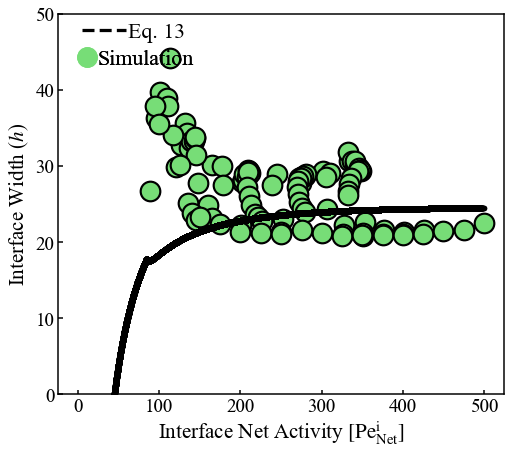

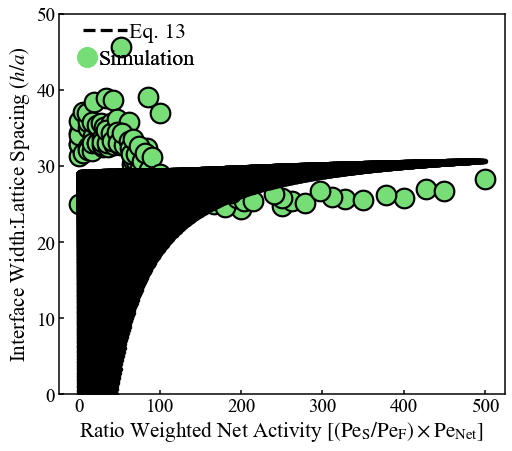

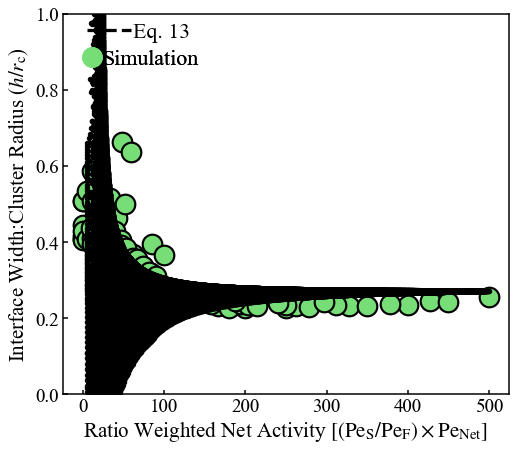

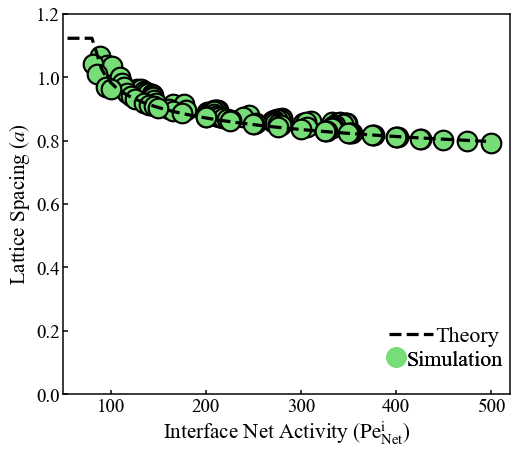

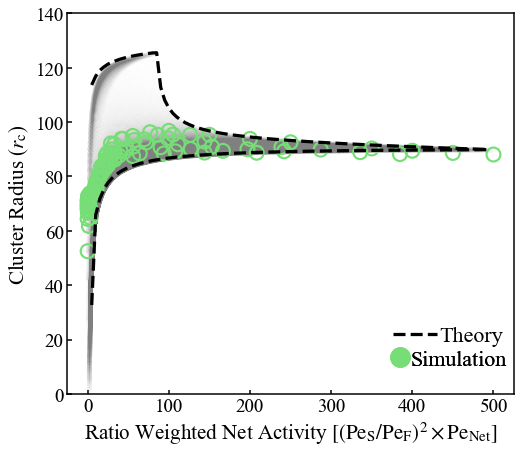

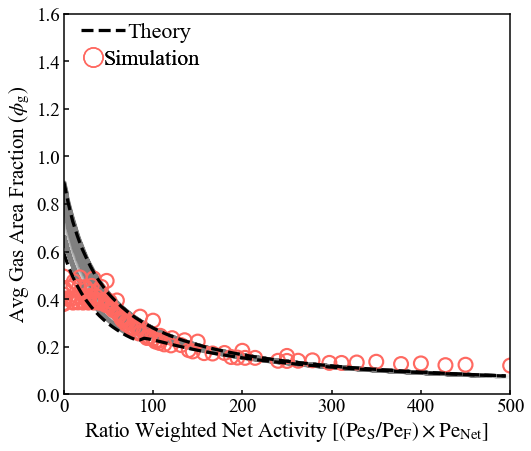

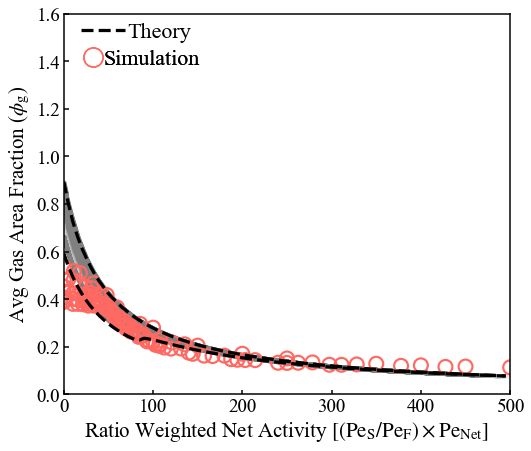

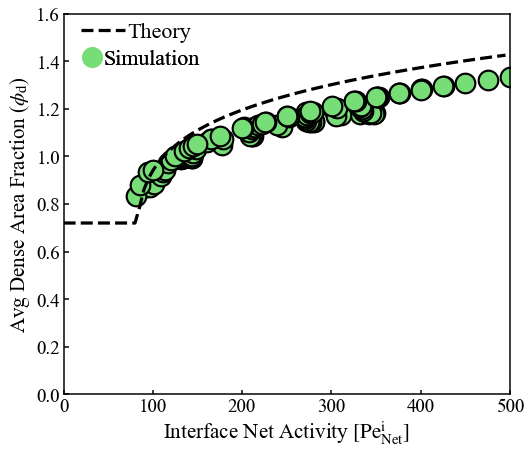

31.117593228305267
23.767828189455486
83.87559769868237
71.94079522945229
80.58956087073985
69.4685331555435
nan
nan


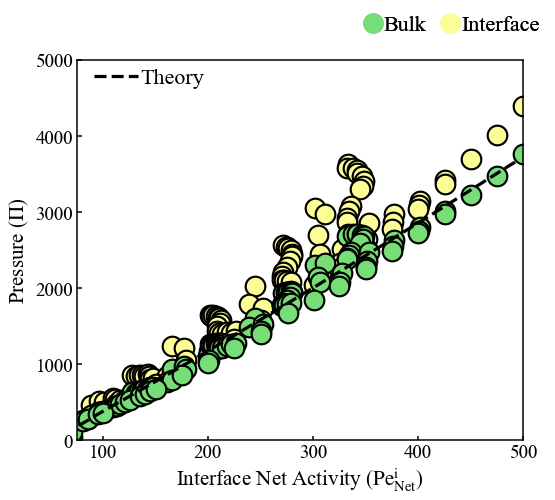

125750
0


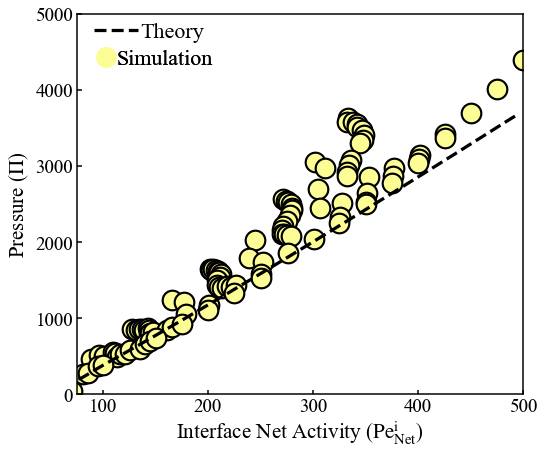

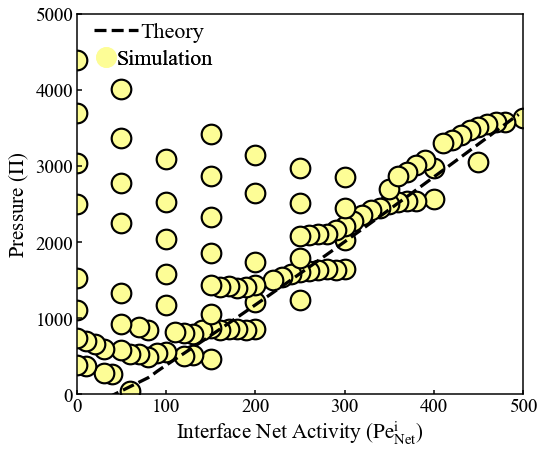

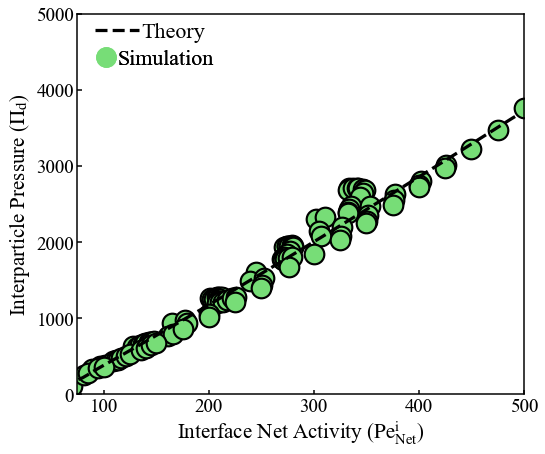

In [120]:
from scipy.stats import kde
test_arr = np.where(rad_theory_temp>=100)[0]
print(slow_act_temp[test_arr])
print(fast_act_temp[test_arr])
print(net_act_temp[test_arr])

s_theory=20
weighted_rat_theory = (0.5*(slow_act_temp/fast_act_temp)**0.5+0.5*(fast_act_temp/fast_act_temp)**0.5) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat2_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)#pe_net_int_arr #pretty much the same as weighted_rat3
weighted_rat3_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat4_theory = ((slow_act_temp/fast_act_temp)**(2)) * (0.5*slow_act_temp + 0.5*fast_act_temp)

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
print(len(int_pe_net))
print(len(avg_clust))
from scipy.optimize import curve_fit

nonzero = np.where(phi_dense_sim>=0.7)[0]

fig, ax1 = plt.subplots(figsize=(8,7))
fast_leg=[]
mkSz = [0.8, 0.8]
msz=5
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=slowCol,
                      markerfacecolor='None', 
                      label='Slow Interface', markersize=(2.4*msz * mkSz[0])))

weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)


#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_clust[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_clust[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat2_theory, clust_theory_temp, color='black', s=s_theory)
#ax1.fill_between(act_range_final, clust_theory_min, clust_theory_max, color='black', alpha=0.2)

#data = np.array([weighted_rat2_theory, clust_theory_temp])
#print(np.shape(data))

#k = kde.gaussian_kde(data)
#nbins= 100
#xi, yi = np.mgrid[weighted_rat2_theory.min():weighted_rat2_theory.max():nbins*1j, clust_theory_temp.min():clust_theory_temp.max():nbins*1j]
#zi = k(np.vstack([xi.flatten(), yi.flatten()]))

#ax1.pcolormesh(xi, yi, zi.reshape(xi.shape), shading='auto', cmap=plt.cm.Blues)
#ax1.contourf(xi, yi, zi.reshape(xi.shape))
plt.scatter(weighted_rat2_theory, clust_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, clust_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, clust_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)
plt.scatter(weighted_rat2[nonzero], avg_clust[nonzero], facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()




weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)





fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(pe_net_int_arr, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)
plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/lat_theory_mean_int_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Lattice Spacing ($h/a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Cluster Radius ($h/r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10
ax1.set_ylim([0, 1])


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr, lat_theory_mean_int_theory_temp, color='black', s=s_theory)


plt.plot(act_range_net_int, lat_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([50.0,520.0])
ax1.set_ylim([0, 1.2])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Lattice Spacing ($a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()

msz = 5
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

plt.scatter(weighted_rat4_theory, rad_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat4, avg_rad_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat4, avg_rad_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat4[nonzero], avg_rad[nonzero], facecolor='none',edgecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat4_theory, rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 140])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})^2\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz = 10

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[1.02, 0.23],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg = []
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.84, 0.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)


plt.show()


msz=5


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Gas Area Fraction ($\phi_\mathrm{g}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))



leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)




plt.show()
msz = 5.0
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim2[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Gas Area Fraction ($\phi_\mathrm{g}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)




plt.show()
msz=10


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')



#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], phi_dense_sim[nonzero], facecolor=green,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, phi_dense_theory_temp, color='black',s=s_theory)
plt.plot(act_range_net_int, dense_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Dense Area Fraction ($\phi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

error = 100*(phi_gas_sim-phi_gas_theory)/phi_gas_theory
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory3)/phi_gas_theory3
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory4)/phi_gas_theory4
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory5)/phi_gas_theory5
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, facecolor=green,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, press_theory_temp, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()
print(len(pe_net_int_arr))
print(len(press_theory_val_arr))

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr,press_theory_val_arr, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)


ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter((interpart_peB-interpart_peA), align_press_arr, facecolor=yellow,edgecolor='black',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr,press_theory_val_arr, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)


ax1.set_xlim([0.0, 500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net, align_press_arr, edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interparticle Pressure ($\Pi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.33, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.16, 0.88],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)


plt.show()




[ 16.  17.  17. ... 117. 117. 118.]
[ 16.  17.  18. ... 117. 118. 118.]
[ 16.   17.   17.5 ... 117.  117.5 118. ]
109
109


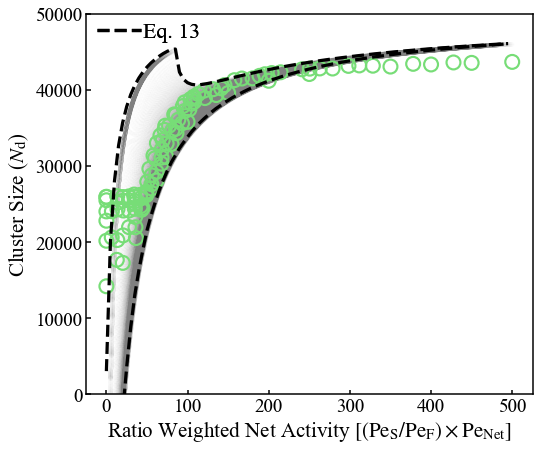

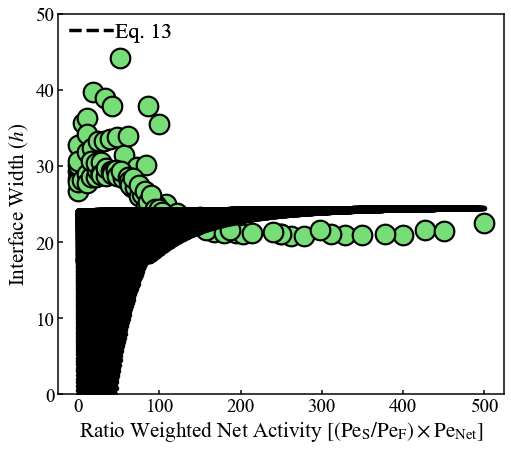

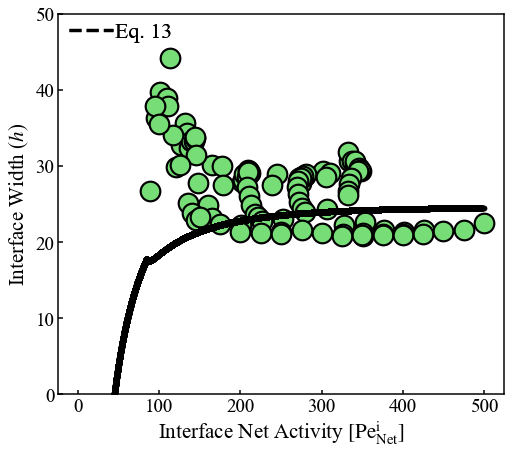

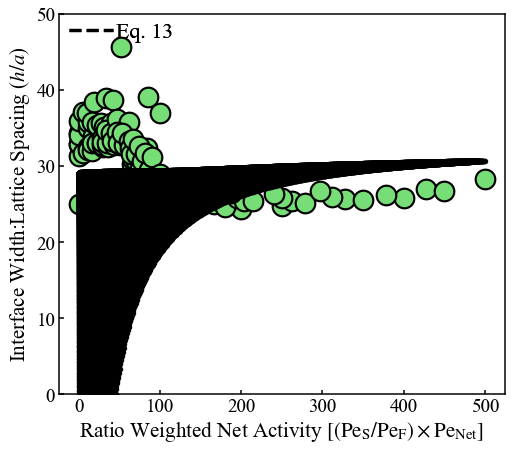

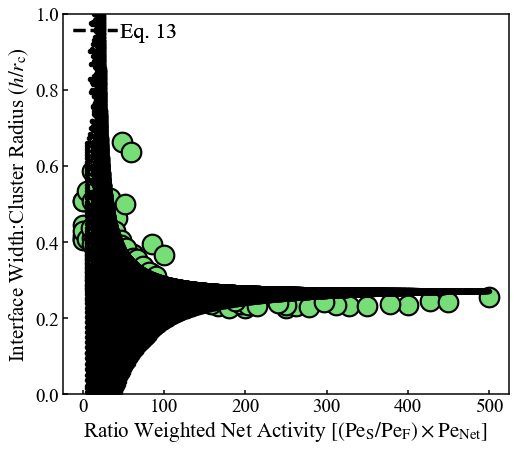

...

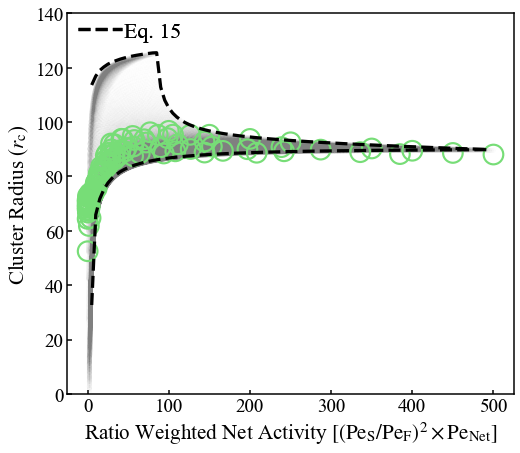

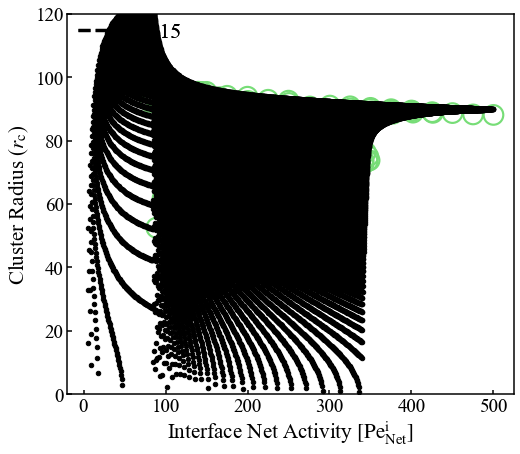

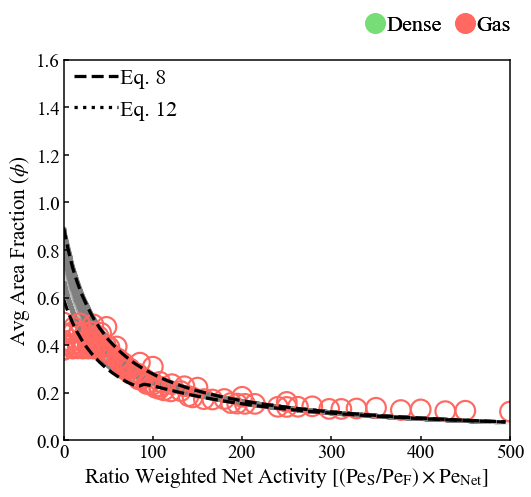

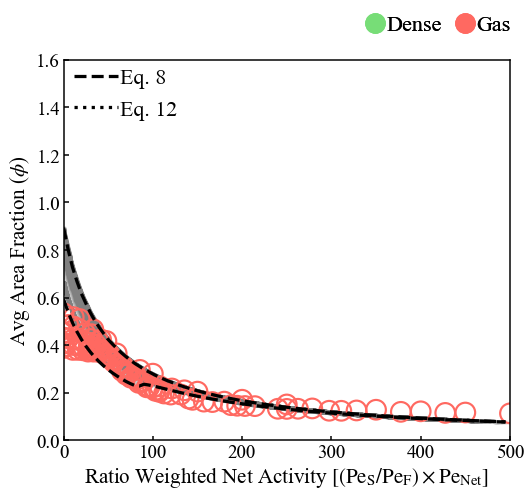

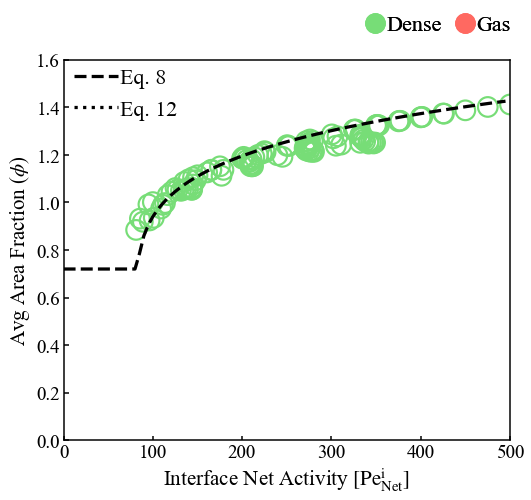

31.117593228305267
23.767828189455486
83.87559769868237
71.94079522945229
80.58956087073985
69.4685331555435
nan
nan


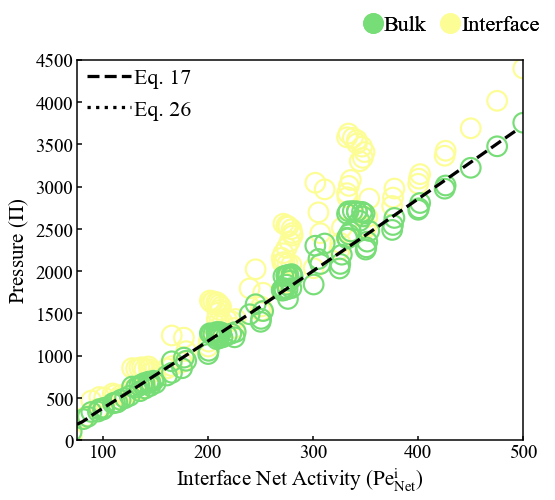

125750
0


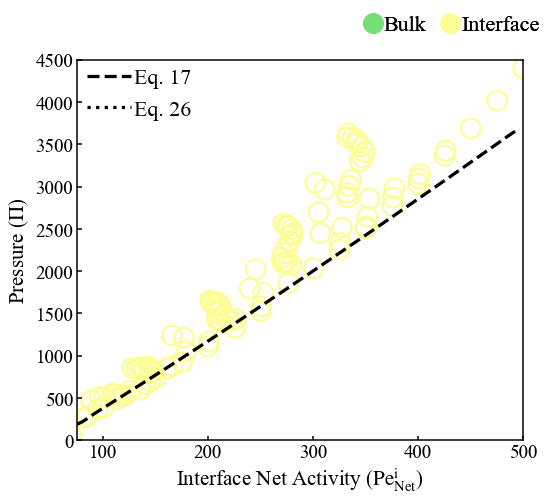

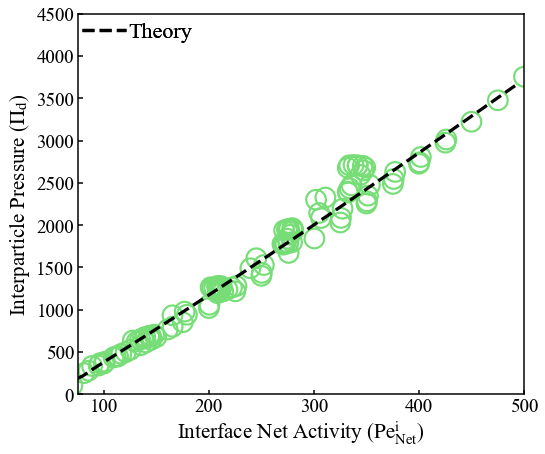

In [33]:

from scipy.stats import kde
test_arr = np.where(rad_theory_temp>=100)[0]
print(slow_act_temp[test_arr])
print(fast_act_temp[test_arr])
print(net_act_temp[test_arr])

s_theory=20
weighted_rat_theory = (0.5*(slow_act_temp/fast_act_temp)**0.5+0.5*(fast_act_temp/fast_act_temp)**0.5) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat2_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)#pe_net_int_arr #pretty much the same as weighted_rat3
weighted_rat3_theory = ((slow_act_temp/fast_act_temp)**(1)) * (0.5*slow_act_temp + 0.5*fast_act_temp)
weighted_rat4_theory = ((slow_act_temp/fast_act_temp)**(2)) * (0.5*slow_act_temp + 0.5*fast_act_temp)

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
print(len(int_pe_net))
print(len(avg_clust))
from scipy.optimize import curve_fit

nonzero = np.where(phi_dense_sim>=0.7)[0]

fig, ax1 = plt.subplots(figsize=(8,7))
fast_leg=[]
mkSz = [0.8, 0.8]
msz=5
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=slowCol,
                      markerfacecolor='None', 
                      label='Slow Interface', markersize=(2.4*msz * mkSz[0])))

weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)


#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_clust[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_clust[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat2_theory, clust_theory_temp, color='black', s=s_theory)
#ax1.fill_between(act_range_final, clust_theory_min, clust_theory_max, color='black', alpha=0.2)

#data = np.array([weighted_rat2_theory, clust_theory_temp])
#print(np.shape(data))

#k = kde.gaussian_kde(data)
#nbins= 100
#xi, yi = np.mgrid[weighted_rat2_theory.min():weighted_rat2_theory.max():nbins*1j, clust_theory_temp.min():clust_theory_temp.max():nbins*1j]
#zi = k(np.vstack([xi.flatten(), yi.flatten()]))

#ax1.pcolormesh(xi, yi, zi.reshape(xi.shape), shading='auto', cmap=plt.cm.Blues)
#ax1.contourf(xi, yi, zi.reshape(xi.shape))
plt.scatter(weighted_rat2_theory, clust_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, clust_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, clust_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)
plt.scatter(weighted_rat2[nonzero], avg_clust[nonzero], facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()




weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)





fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(pe_net_int_arr, width_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/lat_theory_mean_int_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Lattice Spacing ($h/a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3_theory, width_theory_temp/rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Cluster Radius ($h/r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10
ax1.set_ylim([0, 1])


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], all_lat_time_mean[nonzero], facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr, lat_theory_mean_int_theory_temp, color='black', s=s_theory)


plt.plot(act_range_net_int, lat_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([50.0,520.0])
ax1.set_ylim([0, 1.2])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Lattice Spacing ($a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

plt.scatter(weighted_rat4_theory, rad_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat4, avg_rad_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat4, avg_rad_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat4[nonzero], avg_rad[nonzero], facecolor='none',edgecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(weighted_rat4_theory, rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 140])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})^2\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 15', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_rad[nonzero], facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(pe_net_int_arr, rad_theory_temp, color='black', s=s_theory)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 120])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 15', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Area Fraction ($\phi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat2_theory, phi_gas_theory_temp, color='gray', alpha=0.002, s=s_theory)

plt.plot(act_range_rat2, phi_gas_theory_min, color='black', linestyle='--', linewidth=1.8*1.8)
plt.plot(act_range_rat2, phi_gas_theory_max, color='black', linestyle='--', linewidth=1.8*1.8)

plt.scatter(weighted_rat3[nonzero], phi_gas_sim2[nonzero], facecolor='none',edgecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Area Fraction ($\phi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')



#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], phi_dense_sim[nonzero]*1.06, facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, phi_dense_theory_temp, color='black',s=s_theory)
plt.plot(act_range_net_int, dense_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Area Fraction ($\phi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]


two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

error = 100*(phi_gas_sim-phi_gas_theory)/phi_gas_theory
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory3)/phi_gas_theory3
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory4)/phi_gas_theory4
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory5)/phi_gas_theory5
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor='none',edgecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(pe_net_int_arr, press_theory_temp, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 17', markerfacecolor='dashed', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 26', markerfacecolor='dotted', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()
print(len(pe_net_int_arr))
print(len(press_theory_val_arr))

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, facecolor='none',edgecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(pe_net_int_arr,press_theory_val_arr, color='black', s=s_theory)
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)


ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 17', markerfacecolor='dashed', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 26', markerfacecolor='dotted', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net, align_press_arr, edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, facecolor='none',edgecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.plot(act_range_net_int, press_theory_line, color='black', linestyle='--', linewidth=1.8*1.8)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interparticle Pressure ($\Pi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()




/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_65578/2866493417.py:11: UserWarning: You passed a edgecolor/edgecolors ('purple') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(int_pe_net[nonzero], avg_int_theory_arr[nonzero], marker='+', edgecolor='purple',facecolor='purple',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_65578/2866493417.py:13: UserWarning: You passed a edgecolor/edgecolors ('#77dd77') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(int_pe_net[nonzero], avg_bulk_theory_arr[nonzero], marker='+', edgecolor=green,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')


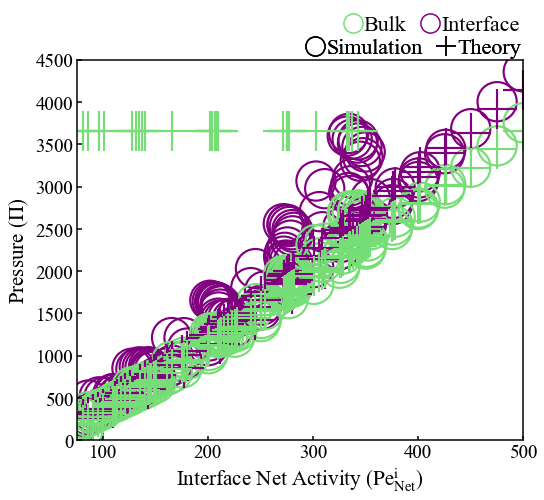

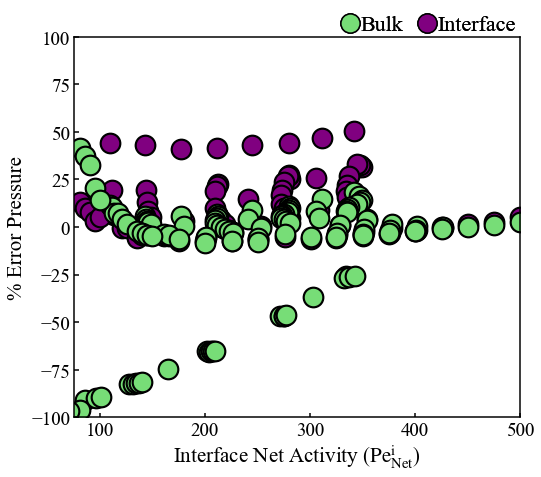

In [31]:
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
nonzero = np.where(int_pe_net>=0)
#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], align_press_arr[nonzero], edgecolor='purple',facecolor='none',  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], interpart_press[nonzero], edgecolor=green,facecolor='none',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_int_theory_arr[nonzero], marker='+', edgecolor='purple',facecolor='purple',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

plt.scatter(int_pe_net[nonzero], avg_bulk_theory_arr[nonzero], marker='+', edgecolor=green,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor='none',
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='purple',
                      markerfacecolor='none',
                      label='Interface', markersize=(2.4*msz * mkSz[0])))


one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.78, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)


eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='black',
                      markerfacecolor='none',
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='+', markeredgewidth=med,
                      markeredgecolor='black',
                      markerfacecolor='none',
                      label='Theory', markersize=(2.4*msz * mkSz[0])))


one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.74, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], ((align_press_arr[nonzero]-avg_int_theory_arr[nonzero])/avg_int_theory_arr[nonzero])*100, edgecolor='black',facecolor='purple',  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], ((interpart_press[nonzero]-avg_bulk_theory_arr[nonzero])/avg_bulk_theory_arr[nonzero])*100, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([-100, 100])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'% Error Pressure', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='black',
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='black',
                      markerfacecolor='purple',
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.78, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

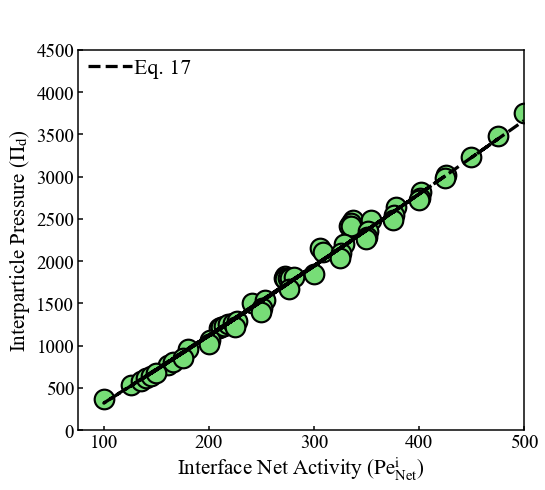

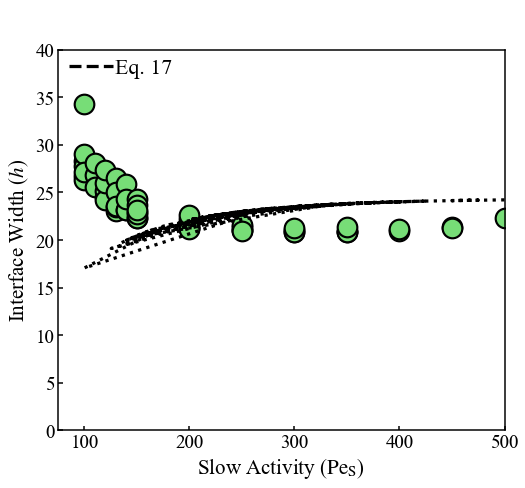

In [181]:
radius_arr_temp = np.linspace(0, 1.6, num=60)
int_pe_net_theory_min_arr = np.array([])
int_pe_net_theory_max_arr = np.array([])

press_theory_val_min = np.array([])
press_theory_val_max = np.array([])

int_pe_net_theory2 = np.linspace(50, 500, num=91)
press_theory_val_arr = np.array([])

int_pe_net_theory_arr = np.array([])
fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)


#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net, press_theory, color='black', linestyle='--', linewidth=1.8*1.8)
plt.scatter(int_pe_net, interpart_press, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interparticle Pressure ($\Pi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 17', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net, width_theory, color='black', linestyle='dotted', linewidth=1.8*1.8)


#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, press_theory2, color='black', linestyle='--', linewidth=1.8*1.8)
plt.scatter(interpart_peA, avg_width, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{S}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 17', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()


In [182]:


def fast_gas_frac(pe_rat_tmp):
    fast_gas = 0.771/(1+np.exp(-2.519*(pe_rat_tmp-0.145)))-0.192
    return fast_gas
int_pe_net_theory2 = np.linspace(51, 500, num=41, dtype=int)
int_pe_net_theory_arr = np.array([])
press_theory_val_arr = np.array([])
for x in range(0, len(int_pe_net_theory2)):
    print(x)
    for y in range(0, len(int_pe_net_theory2)):
        if int_pe_net_theory2[x]<= int_pe_net_theory2[y]:
            int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])+1), dtype=int)
            pe_rat_val = int_pe_net_theory2[x]/int_pe_net_theory2[y]
            fast_gas_val = fast_gas_frac(pe_rat_val)
            pe_gas_net = fast_gas_val * int_pe_net_theory2[y] + (1-fast_gas_val) * int_pe_net_theory2[x]
            for z in range(0, len(int_pe_net_theory_temp)):
                
                lat_theory_mean_int_val = conForRClust(int_pe_net_theory_temp[z]-45, 1.0)
                phi_dense_val = phi_cp / lat_theory_mean_int_val**2 
                phi_gas_val = (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int_val * pe_gas_net) ** (-1))
                def densProbability(r, activity_net, activity_fast):
                    "Using similar triangles to find sides"
                    gas_dense_dif_phi = phi_dense_val - phi_gas_val
                    rate_decay = -8.77 * np.log10(activity_fast-45) - 42.188
                    mid_point = 0.028 * np.log10(activity_net-45) + 0.882
                    gas_phi = phi_gas_val

                    num_dens_r = ((gas_dense_dif_phi / (1+np.exp(-rate_decay * (r-mid_point)))) + gas_phi)

                    return num_dens_r

                def alignProbability(r, activity_net, activity_slow):
                    "Using similar triangles to find sides"
                    max_align = 0.175 * np.log10(activity_net - 45) - 0.15
                    mid_point = 0.077 * np.log10(activity_slow - 45) + 0.76
                    std_dev = 0.115
                    align_r = max_align * np.exp(-(r-mid_point)**2/(2*std_dev**2))

                    return align_r


                clust_val = 50000* (((phi_gas_val-0.6)*phi_dense_val)/(0.6*(phi_gas_val-phi_dense_val)))
                press_val = (int_pe_net_theory_temp[z]-50) * 2 * np.sqrt(3) * 1.92 /lat_theory_mean_int_val
                rad_val =  ((clust_val / (4*phi_cp))**0.5) * lat_theory_mean_int_val
                width_val = (np.sqrt(3)/(2*0.5)) * (press_val/int_pe_net_theory_temp[z]) * lat_theory_mean_int_val**2 * 3.0
                peNet = 0.5 * float(int_pe_net_theory2[x]) + 0.5 * float(int_pe_net_theory2[y])
                #int_pe_net_val = 

                dens_temp = densProbability(radius_arr_temp, int_pe_net_theory_temp[z], int_pe_net_theory2[y])
                align_temp = alignProbability(radius_arr_temp, int_pe_net_theory_temp[z], int_pe_net_theory2[x])
                

                press = dens_temp * align_temp * int_pe_net_theory_temp[z]
                press_int = 0
                for m in range(1, len(press)):
                    press_int += ((press[m-1]+press[m])/2)*(radius_arr_temp[m]-radius_arr_temp[m-1]) * rad_val
                press_theory_val_arr = np.append(press_theory_val_arr, press_int)
                int_pe_net_theory_arr = np.append(int_pe_net_theory_arr, int_pe_net_theory_temp[z])

int_pe_net_final_arr = np.array([])
press_theory_max_arr = np.array([])
press_theory_min_arr = np.array([])
for z in range(0, len(int_pe_net_theory_arr)):
    if int_pe_net_theory_arr[z] not in int_pe_net_final_arr:
        loc = np.where(int_pe_net_theory_arr==int_pe_net_theory_arr[z])[0]
        press_theory_max_arr = np.append(press_theory_max_arr, np.max(press_theory_val_arr[loc]))
        press_theory_min_arr = np.append(press_theory_min_arr, np.min(press_theory_val_arr[loc]))
        int_pe_net_final_arr = np.append(int_pe_net_final_arr, int_pe_net_theory_arr[z])




0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40


In [183]:


def fast_gas_frac(pe_rat_tmp):
    fast_gas = 0.771/(1+np.exp(-2.519*(pe_rat_tmp-0.145)))-0.192
    return fast_gas
int_pe_net_theory2 = np.linspace(51, 501, num=19, dtype=int)
print(int_pe_net_theory2)
#stop
int_pe_net_theory_arr = np.array([])
press_theory_val_arr = np.array([])
pe_gas_arr = np.array([])
pe_rat_arr = np.array([])
radius_arr_temp = np.linspace(0, 1.6, num=55)
#int((int_pe_net_theory2[y]-int_pe_net_theory2[x])+1)
for x in range(0, len(int_pe_net_theory2)):
    print(int_pe_net_theory2[x])
    for y in range(0, len(int_pe_net_theory2)):
        if int_pe_net_theory2[x]<=int_pe_net_theory2[y]:
            #if int_pe_net_theory2[y]-int_pe_net_theory2[x]>=18:
            if int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%19==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/19)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/19)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%18==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/18)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/18)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%17==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/17)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/17)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%16==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/16)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/16)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%15==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/15)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/15)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%14==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/14)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/14)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%13==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/13)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/13)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%12==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/12)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/12)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%11==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/11)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/11)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%10==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/10)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/10)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%9==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/9)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/9)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%8==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/8)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/8)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%7==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/7)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/7)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%6==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/6)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/6)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%5==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/5)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/5)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%4==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/4)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/4)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%3==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/3)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/3)+1, dtype=int)
            elif int(int_pe_net_theory2[y]-int_pe_net_theory2[x])%2==0:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/2)+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int((int_pe_net_theory2[y]-int_pe_net_theory2[x])/2)+1, dtype=int)
            else:
                int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int(int_pe_net_theory2[y]-int_pe_net_theory2[x])+1, dtype=int)
                gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int(int_pe_net_theory2[y]-int_pe_net_theory2[x])+1, dtype=int)
            int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int(int_pe_net_theory2[y]-int_pe_net_theory2[x])+1, dtype=int)

            #gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int(int_pe_net_theory2[y]-int_pe_net_theory2[x])+1, dtype=int)
            #else:
            #    int_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num = int(int_pe_net_theory2[y]-int_pe_net_theory2[x])+1, dtype=int)
            #    gas_pe_net_theory_temp = np.linspace(int(int_pe_net_theory2[x]), int(int_pe_net_theory2[y]), num=int(int_pe_net_theory2[y]-int_pe_net_theory2[x])+1, dtype=int)

            #pe_rat_val = int_pe_net_theory2[x]/int_pe_net_theory2[y]
            #fast_gas_val = fast_gas_frac(pe_rat_val)
            #pe_gas_net = fast_gas_val * int_pe_net_theory2[y] + (1-fast_gas_val) * int_pe_net_theory2[x]
            #pe_gas_arr = np.append(pe_gas_arr, fast_gas_val)
            #pe_rat_arr = np.append(pe_rat_arr, pe_rat_val)

            for z in range(0, len(int_pe_net_theory_temp)):
                for w in range(0, len(gas_pe_net_theory_temp)):

                    lat_theory_mean_int_val = conForRClust(int_pe_net_theory_temp[z]-45, 1.0)
                    phi_dense_val = phi_cp / lat_theory_mean_int_val**2 

                    phi_gas_val = (3 * np.pi**2 * 4.5/4) * ((lat_theory_mean_int_val * gas_pe_net_theory_temp[w]) ** (-1))
                    def densProbability(r, activity_net, activity_fast):
                        "Using similar triangles to find sides"
                        gas_dense_dif_phi = phi_dense_val - phi_gas_val
                        rate_decay = -8.77 * np.log10(activity_fast-45) + 42.188
                        mid_point = 0.028 * np.log10(activity_net-45) + 0.882
                        gas_phi = phi_gas_val

                        num_dens_r = ((gas_dense_dif_phi / (1+np.exp(rate_decay * (r-mid_point)))) + gas_phi)

                        return num_dens_r

                    def alignProbability(r, activity_net, activity_slow):
                        "Using similar triangles to find sides"
                        max_align = 0.175 * np.log10(activity_net - 45) - 0.15
                        mid_point = 0.077 * np.log10(activity_slow - 45) + 0.76
                        std_dev = 0.115
                        align_r = max_align * np.exp(-(r-mid_point)**2/(2*std_dev**2))

                        return align_r


                    clust_val = 50000* (((phi_gas_val-0.6)*phi_dense_val)/(0.6*(phi_gas_val-phi_dense_val)))
                    press_val = (int_pe_net_theory_temp[z]-45) * 2 * np.sqrt(3) * 1.92 /lat_theory_mean_int_val
                    rad_val =  ((clust_val / (4*phi_cp))**0.5) * lat_theory_mean_int_val
                    width_val = (np.sqrt(3)/(2*0.5)) * (press_val/int_pe_net_theory_temp[z]) * lat_theory_mean_int_val**2 * 3.0
                    peNet = 0.5 * float(int_pe_net_theory2[x]) + 0.5 * float(int_pe_net_theory2[y])
                    #int_pe_net_val = 

                    dens_temp = densProbability(radius_arr_temp, int_pe_net_theory_temp[z], int_pe_net_theory2[y])
                    align_temp = alignProbability(radius_arr_temp, int_pe_net_theory_temp[z], int_pe_net_theory2[x])


                    press = dens_temp * align_temp * int_pe_net_theory_temp[z]
                    press_int = 0
                    for m in range(1, len(press)):
                        press_int += ((press[m-1]+press[m])/2)*(radius_arr_temp[m]-radius_arr_temp[m-1]) * rad_val
                    press_theory_val_arr = np.append(press_theory_val_arr, press_int)
                    int_pe_net_theory_arr = np.append(int_pe_net_theory_arr, int_pe_net_theory_temp[z])

int_pe_net_final_arr = np.array([])
press_theory_max_arr = np.array([])
press_theory_min_arr = np.array([])
for z in range(0, len(int_pe_net_theory_arr)):
    if int_pe_net_theory_arr[z] not in int_pe_net_final_arr:
        loc = np.where(int_pe_net_theory_arr==int_pe_net_theory_arr[z])[0]
        test_press = press_theory_val_arr[loc]
        loc2 = np.isnan(test_press)
        loc3 = np.where(loc2==True)[0]
        test_press = np.delete(test_press, loc3)
        press_theory_max_arr = np.append(press_theory_max_arr, np.max(test_press))
        press_theory_min_arr = np.append(press_theory_min_arr, np.min(test_press))
        int_pe_net_final_arr = np.append(int_pe_net_final_arr, int_pe_net_theory_arr[z])


[ 51  76 101 126 151 176 201 226 251 276 301 326 351 376 401 426 451 476
 501]
51


/var/folders/_q/jm4kbp7160d72j4c2l1hpjtc0000gn/T/ipykernel_62660/554743423.py:118: RuntimeWarning: invalid value encountered in double_scalars
  rad_val =  ((clust_val / (4*phi_cp))**0.5) * lat_theory_mean_int_val


76
101
126
151
176
201
226
251
276
301
326
351
376
401
426
451
476
501


451
451
[-7.23640234e+00 -1.12603625e+00  9.18975472e+00  1.98346390e+01
  2.97853101e+01  3.91888065e+01  4.81527712e+01  5.67581987e+01
  6.50674332e+01  7.31293892e+01  8.09830757e+01  8.86600427e+01
  9.61861222e+01  1.03582694e+02  1.10867622e+02  1.18055959e+02
  1.25160489e+02  1.32192139e+02  1.39160310e+02  1.46073137e+02
  1.52937690e+02  1.59760149e+02  1.66548830e+02  1.73320329e+02
  1.80064835e+02  1.86786057e+02  1.93487298e+02  2.00171502e+02
  2.06841305e+02  2.13499070e+02  2.20146921e+02  2.26786773e+02
  2.33420351e+02  2.40049218e+02  2.46674787e+02  2.55409409e+02
  2.64232717e+02  2.72844350e+02  2.81379699e+02  2.89840959e+02
  2.98252267e+02  3.06595201e+02  3.14947039e+02  3.23246155e+02
  3.31531053e+02  3.39824645e+02  3.48095437e+02  3.56349803e+02
  3.64635892e+02  3.72915292e+02  3.81190690e+02  3.89465040e+02
  3.97768558e+02  4.06079390e+02  4.14395529e+02  4.22718553e+02
  4.31049829e+02  4.39412947e+02  4.47787812e+02  4.56174135e+02
  4.64572735e+02 

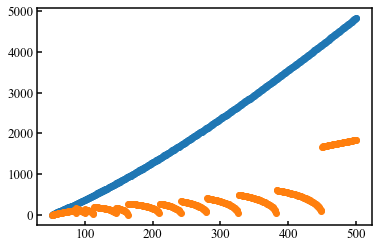

In [184]:
print(len(int_pe_net_final_arr))
print(len(press_theory_max_arr))
print(press_theory_max_arr)
plt.scatter(int_pe_net_final_arr, press_theory_max_arr)
plt.scatter(int_pe_net_final_arr, press_theory_min_arr)
plt.show()

111
111


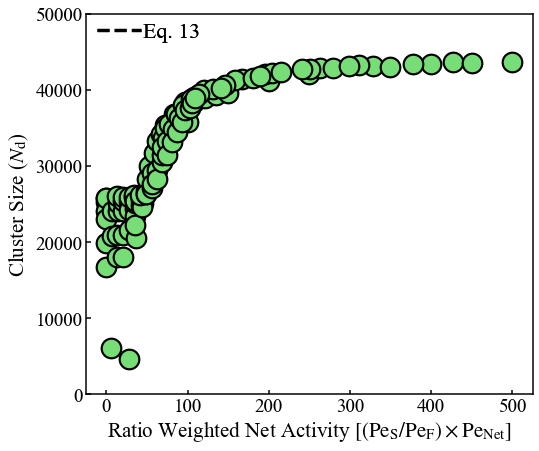

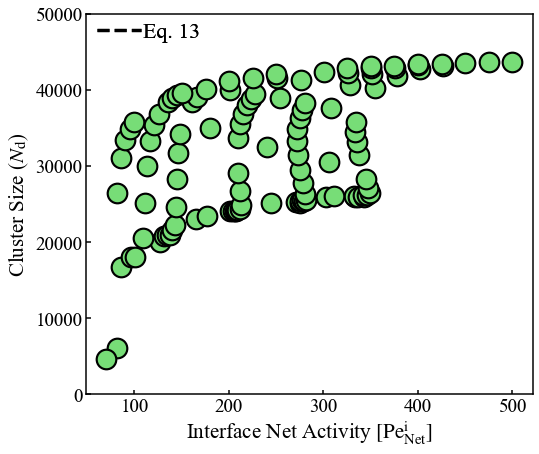

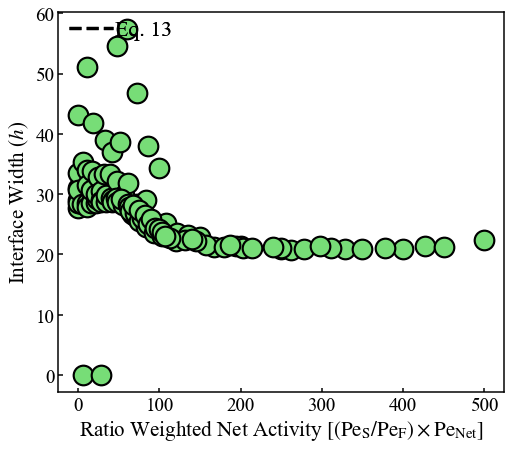

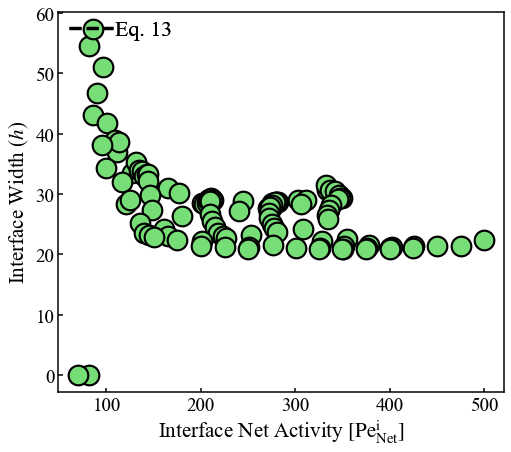

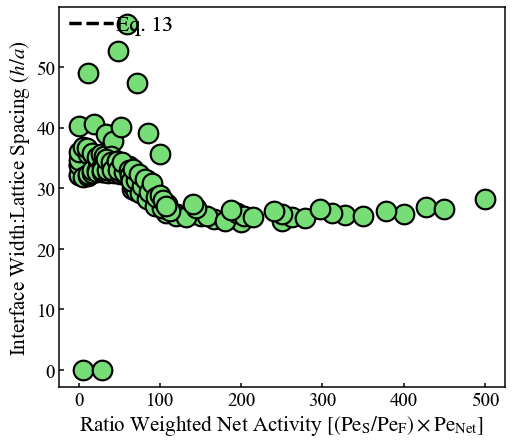

...

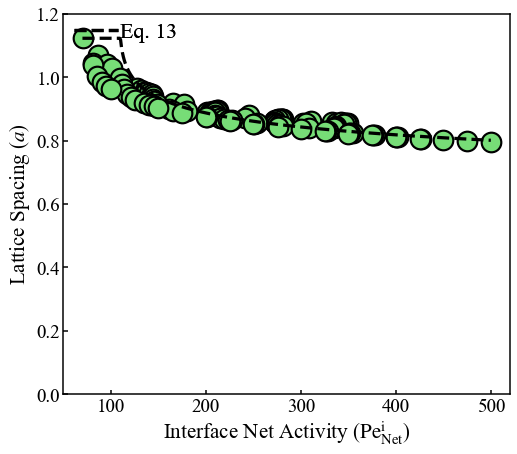

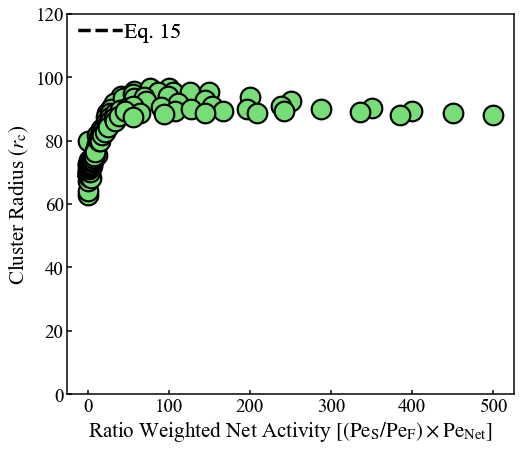

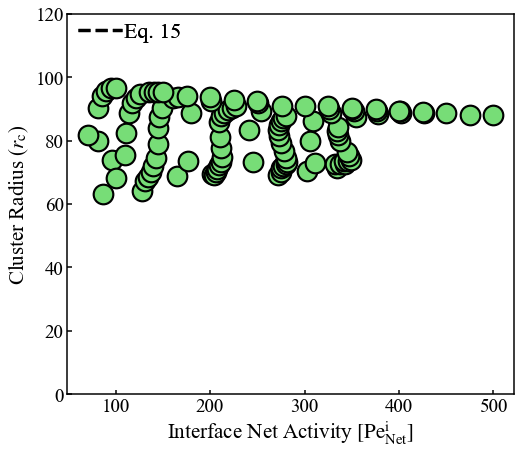

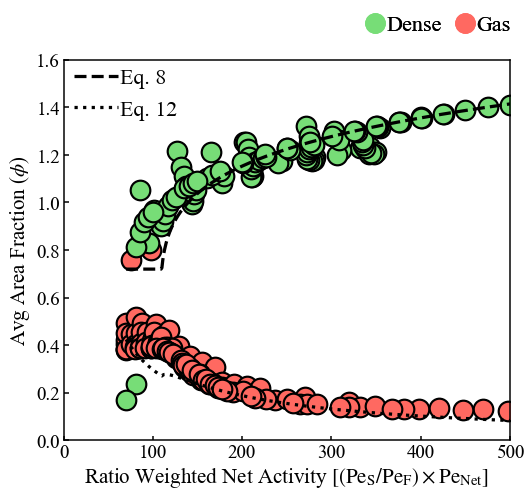

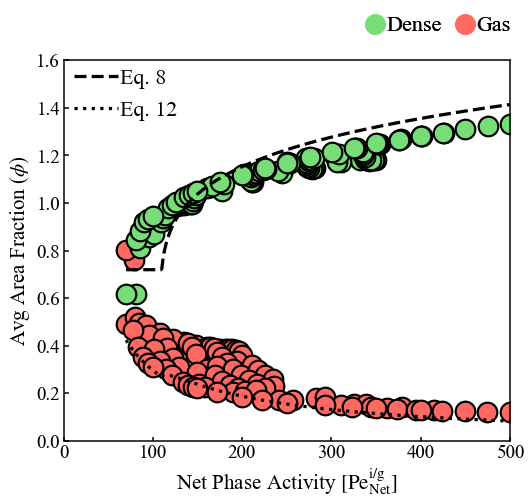

31.441661062634086
24.647582402619076
82.33658062670206
71.37672472559815
79.88996910413744
69.35766852348645
nan
nan


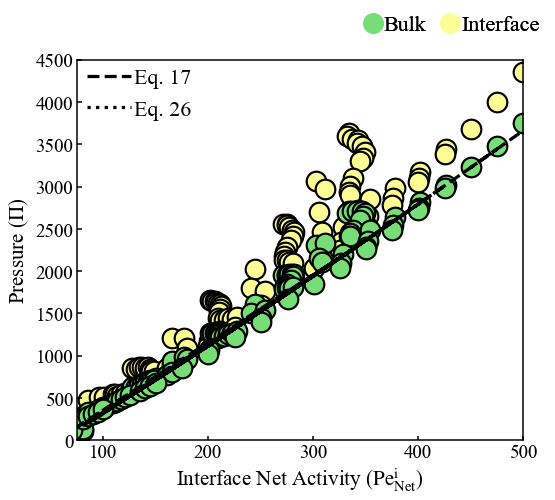

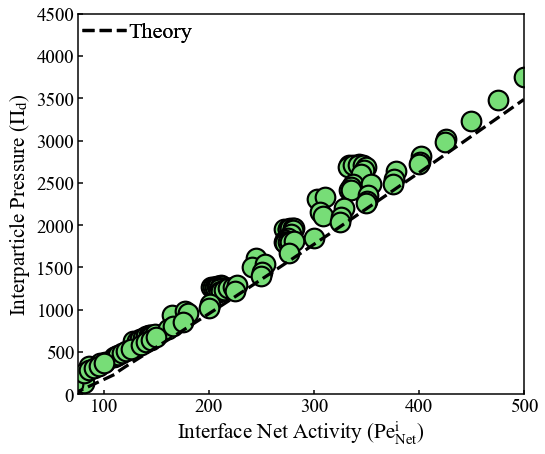

In [166]:
yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
print(len(int_pe_net))
print(len(avg_clust))
from scipy.optimize import curve_fit

nonzero = np.where(interpart_peA>=0)[0]
fig, ax1 = plt.subplots(figsize=(8,7))
fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=slowCol,
                      markerfacecolor='None', 
                      label='Slow Interface', markersize=(2.4*msz * mkSz[0])))

weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)


#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, clust_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_clust[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat2[nonzero], avg_clust[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_clust[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=slowCol,
                      markerfacecolor='None', 
                      label='Slow Interface', markersize=(2.4*msz * mkSz[0])))

weighted_rat = (0.5*(interpart_peA/interpart_peB)**0.5+0.5*(interpart_peB/interpart_peB)**0.5) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat2 = ((interpart_peA/interpart_peB)**(1)) * int_pe_net #pretty much the same as weighted_rat3
weighted_rat3 = ((interpart_peA/interpart_peB)**(1)) * (0.5*interpart_peA + 0.5*interpart_peB)
weighted_rat4 = ((interpart_peA/interpart_peB)**(2)) * (0.5*interpart_peA + 0.5*interpart_peB)


#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, clust_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_clust[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_clust[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_clust[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()



fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, width_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 35])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, width_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)



#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 35])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, width_theory2/lat_theory_mean_int_theory, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Lattice Spacing ($h/a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, width_theory2/rad_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat3[nonzero], avg_width[nonzero]/avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
#ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Cluster Radius ($h/r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, lat_theory_mean_int_theory, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([50.0,520.0])
ax1.set_ylim([0, 1.2])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Lattice Spacing ($a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, rad_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(weighted_rat4[nonzero], avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 120])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 15', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net_theory, rad_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

#ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 120])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 15', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(weighted_rat3[nonzero]+pe_crit, phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Area Fraction ($\phi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Ratio Weighted Net Activity $[(\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F})\times\mathrm{Pe}_\mathrm{Net}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')




#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], phi_dense_sim[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

#plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Area Fraction ($\phi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Net Phase Activity $[\mathrm{Pe}_\mathrm{Net}^\mathrm{i/g}]$', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()


error = 100*(phi_gas_sim-phi_gas_theory)/phi_gas_theory
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory3)/phi_gas_theory3
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory4)/phi_gas_theory4
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory5)/phi_gas_theory5
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net, align_press_arr, edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net, press_theory, color='black', linestyle='--', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 17', markerfacecolor='dashed', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 26', markerfacecolor='dotted', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
#ax1.fill_between(int_pe_net_final_arr, press_theory_min_arr, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net, align_press_arr, edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net_theory, press_theory2, color='black', linestyle='--', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net, interpart_press, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interparticle Pressure ($\Pi_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Theory', markerfacecolor='dashed', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()



38
38


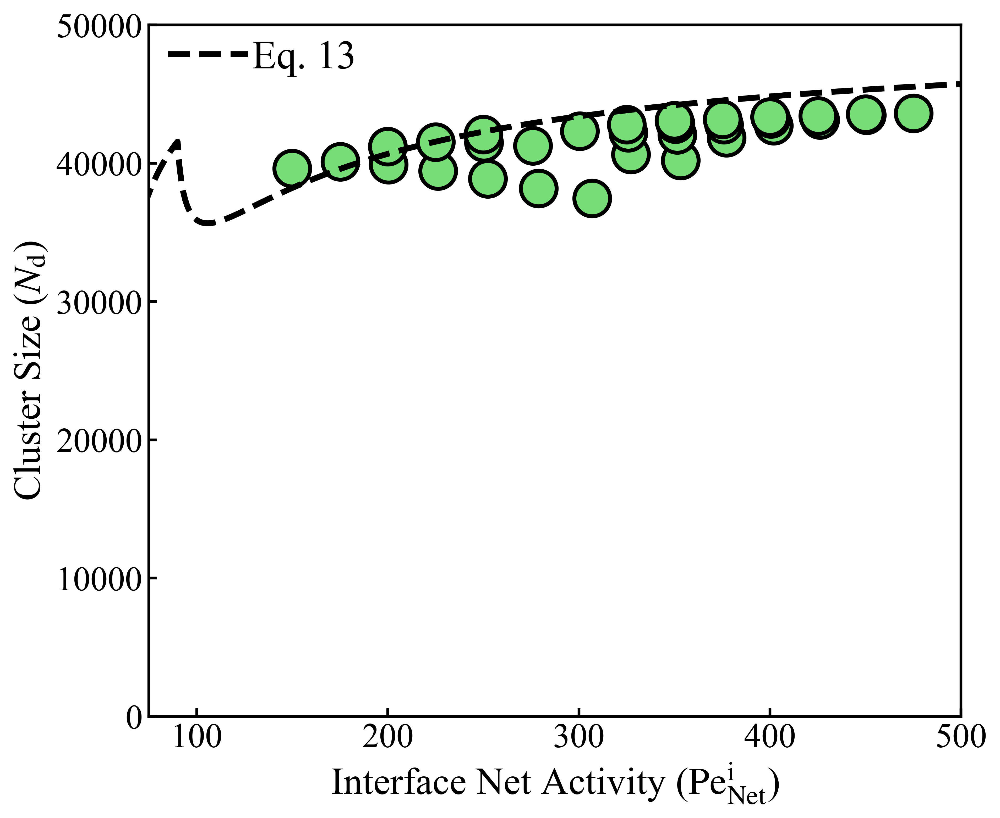

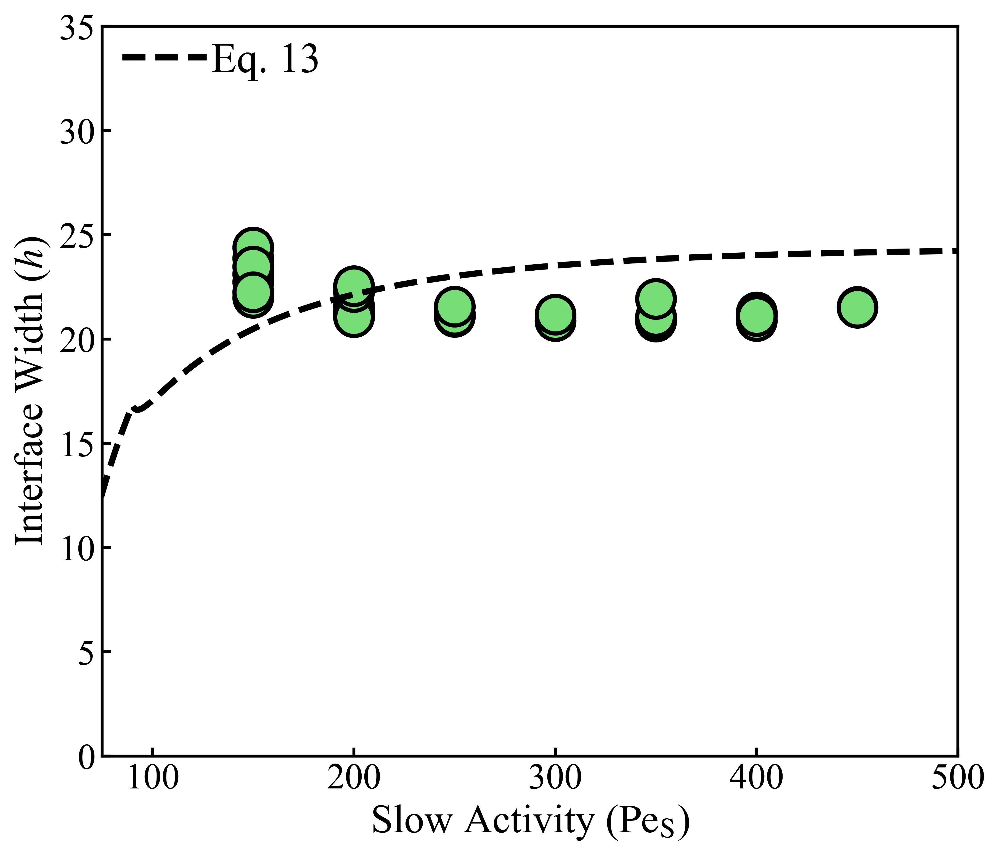

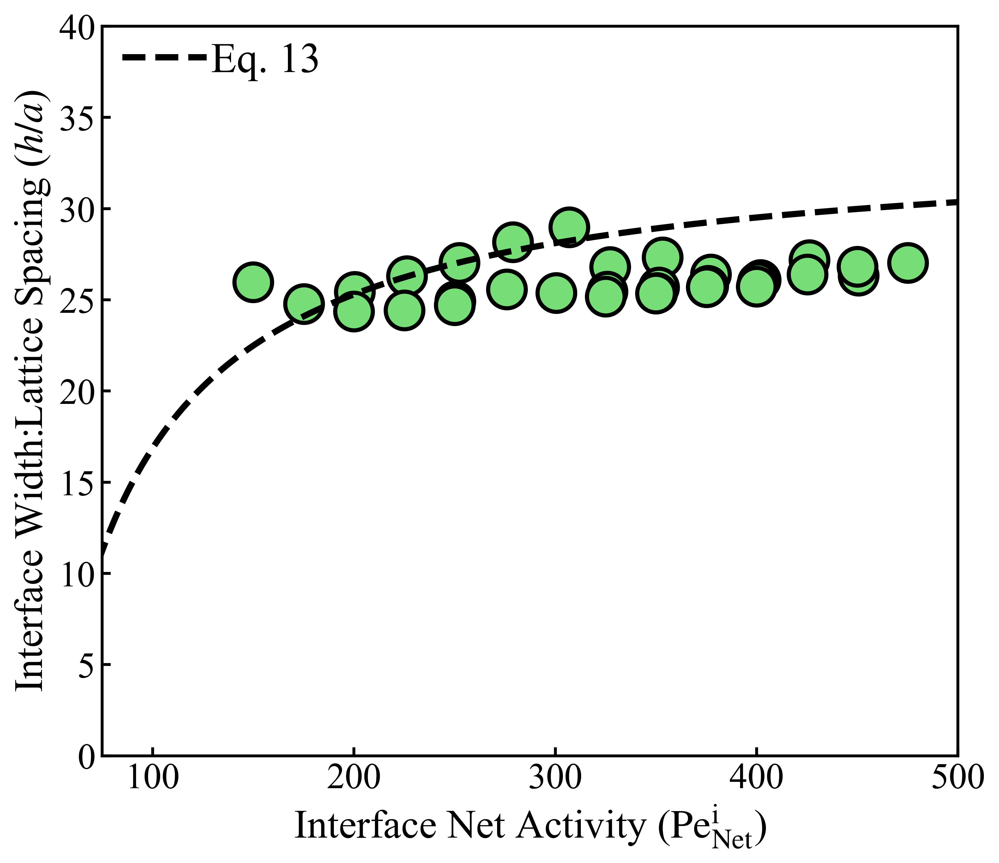

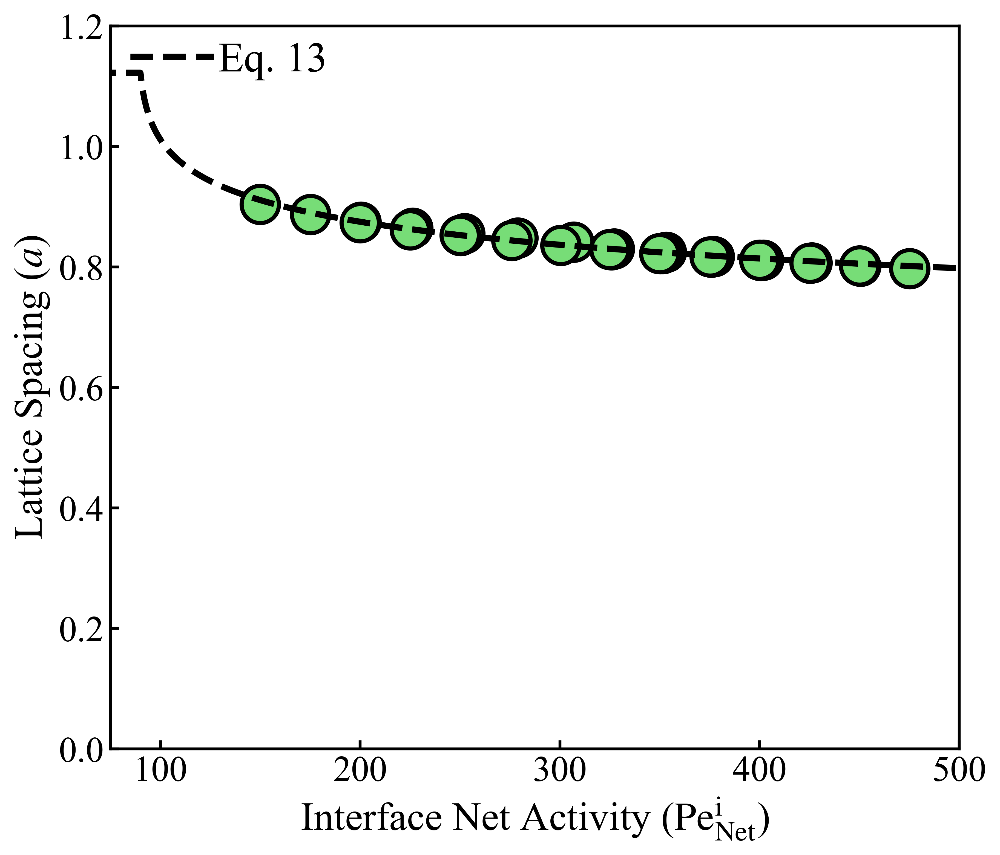

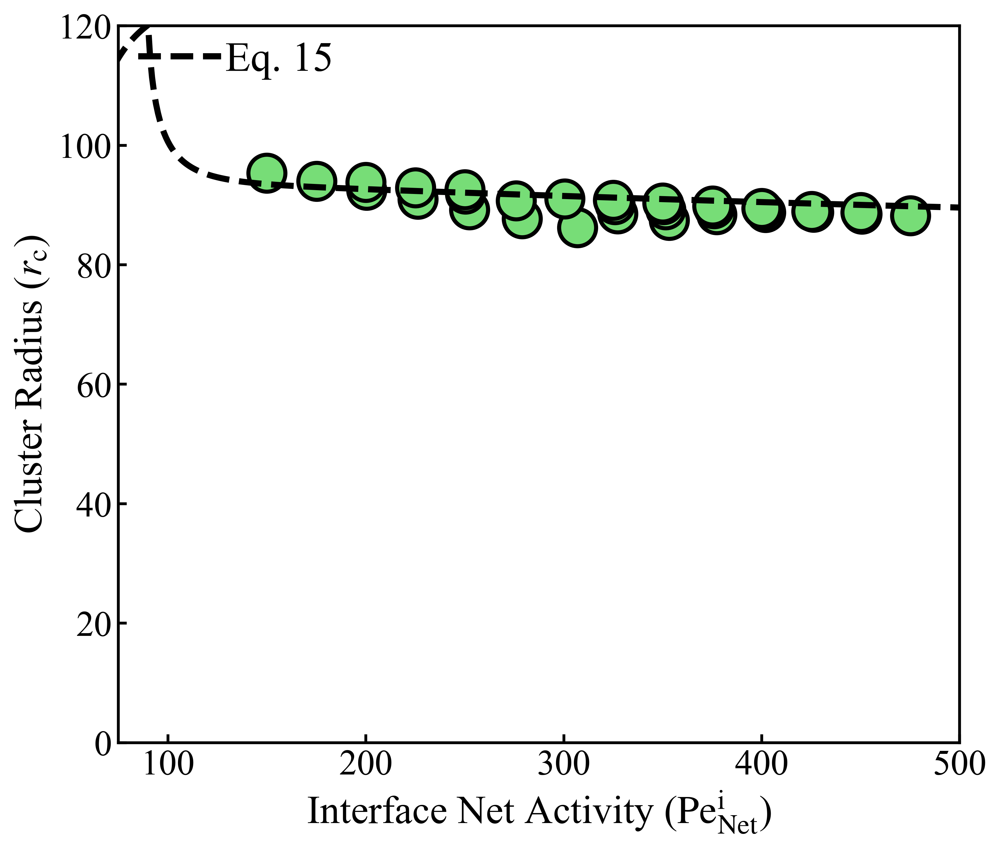

...

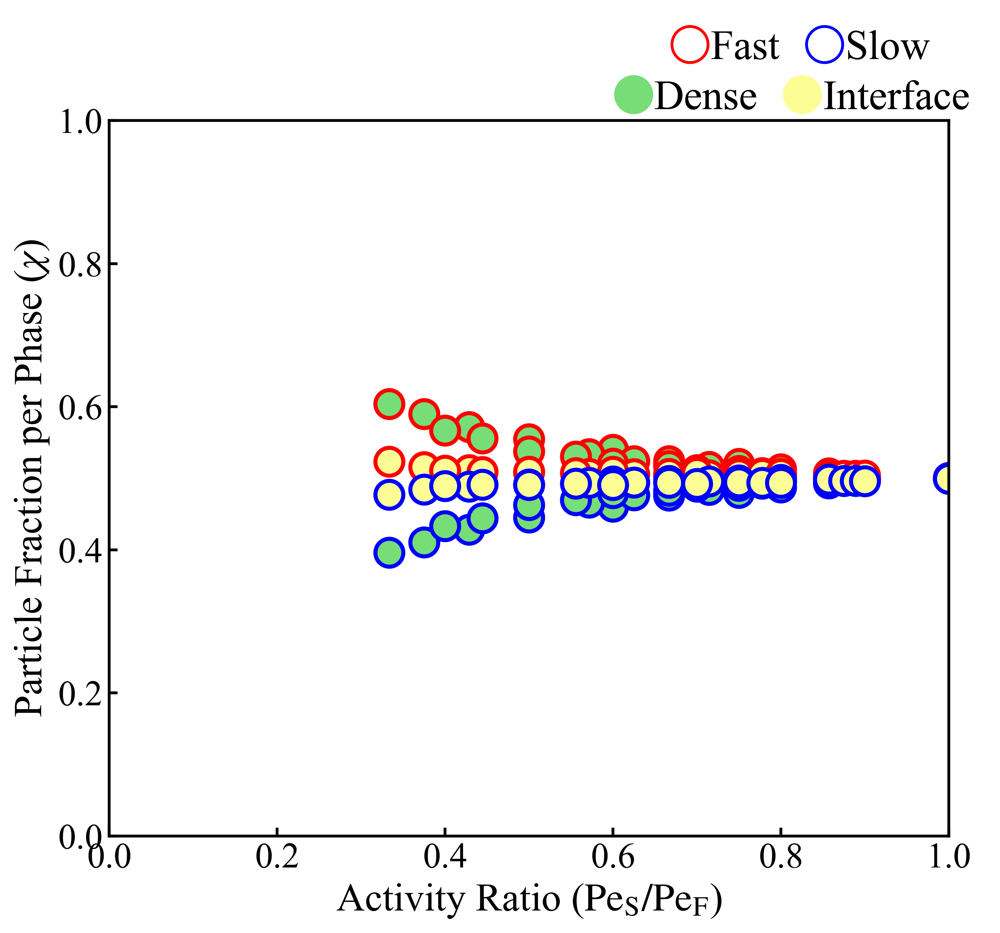

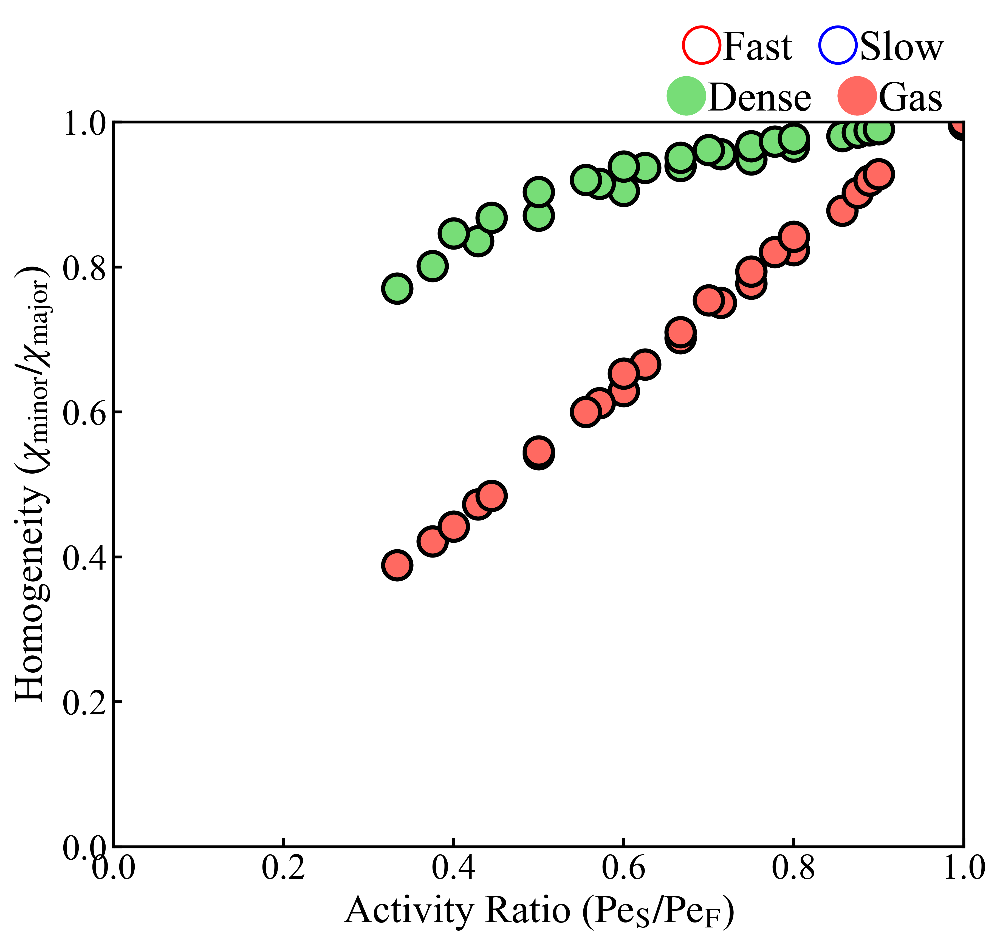

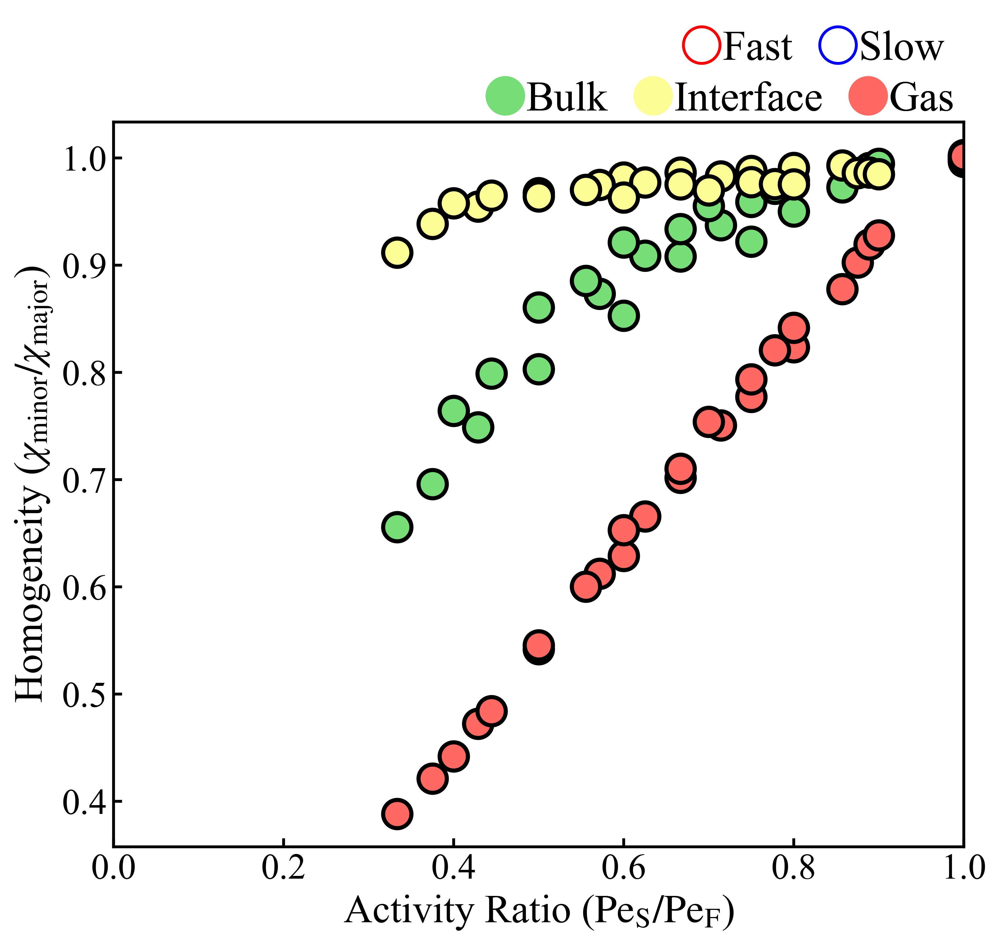

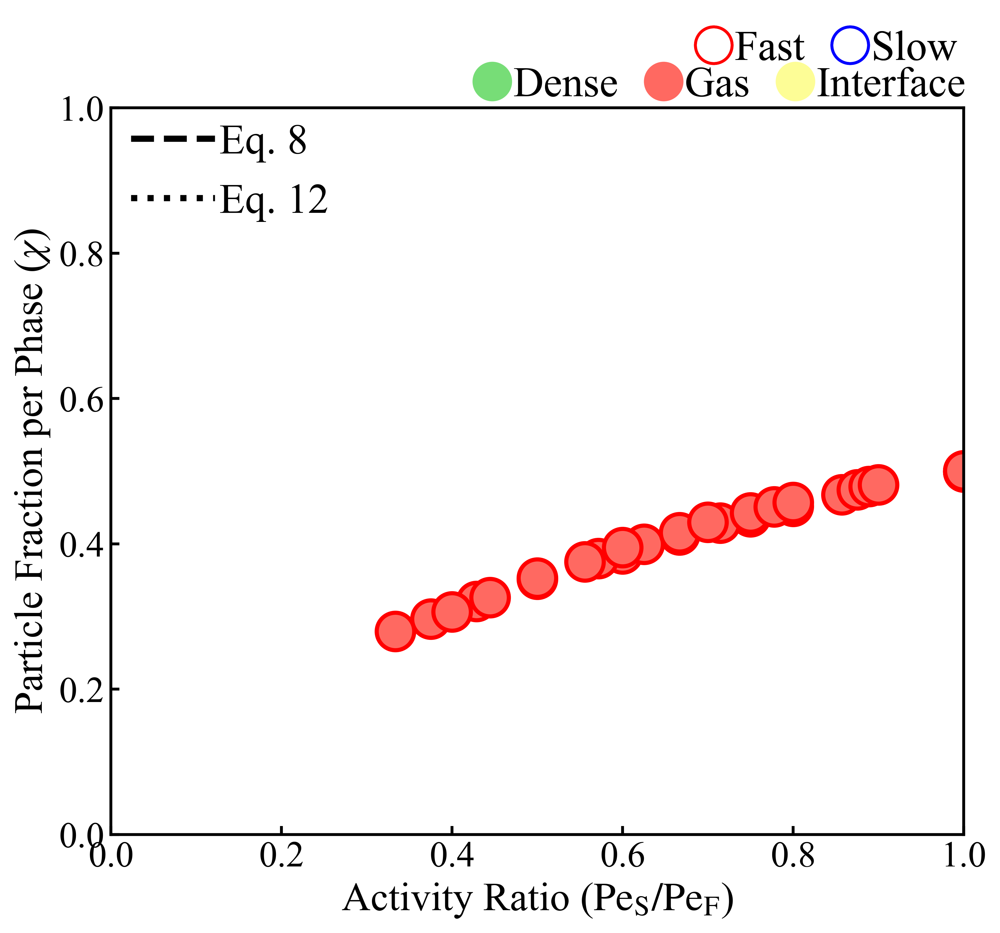

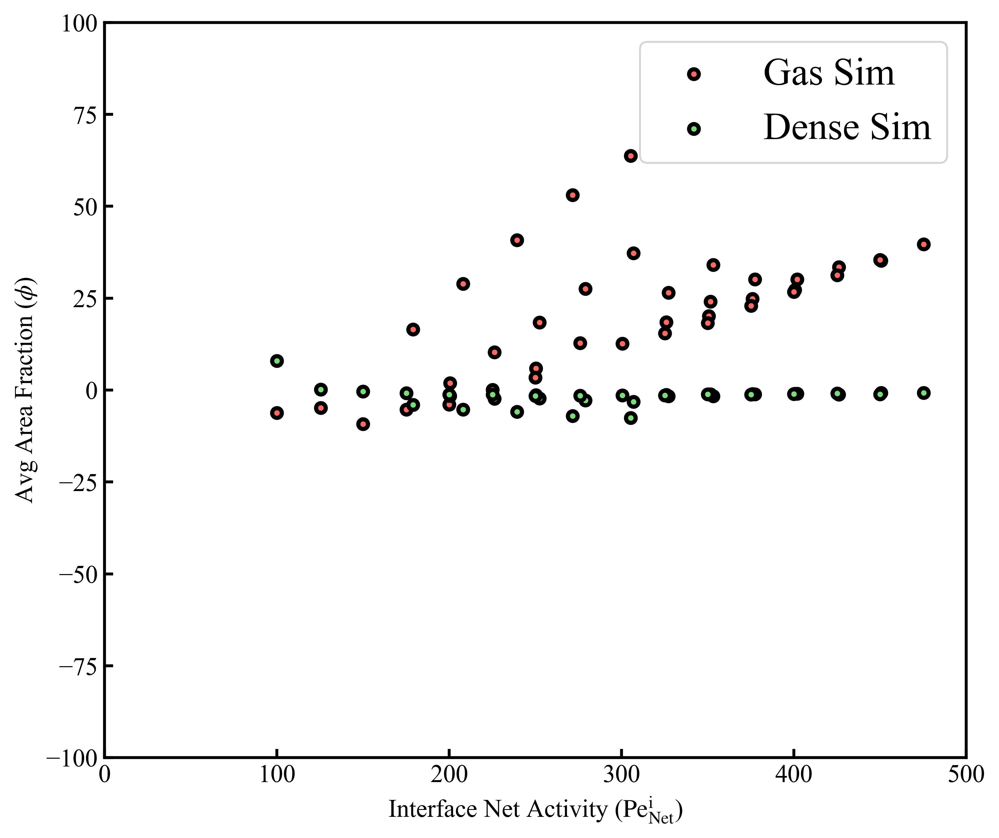

20.980962199723027
16.54166688978065
37.077428064605954
38.06551945535157
34.910621041254146
34.81553603500051
39.45571058122461
42.36411046899902


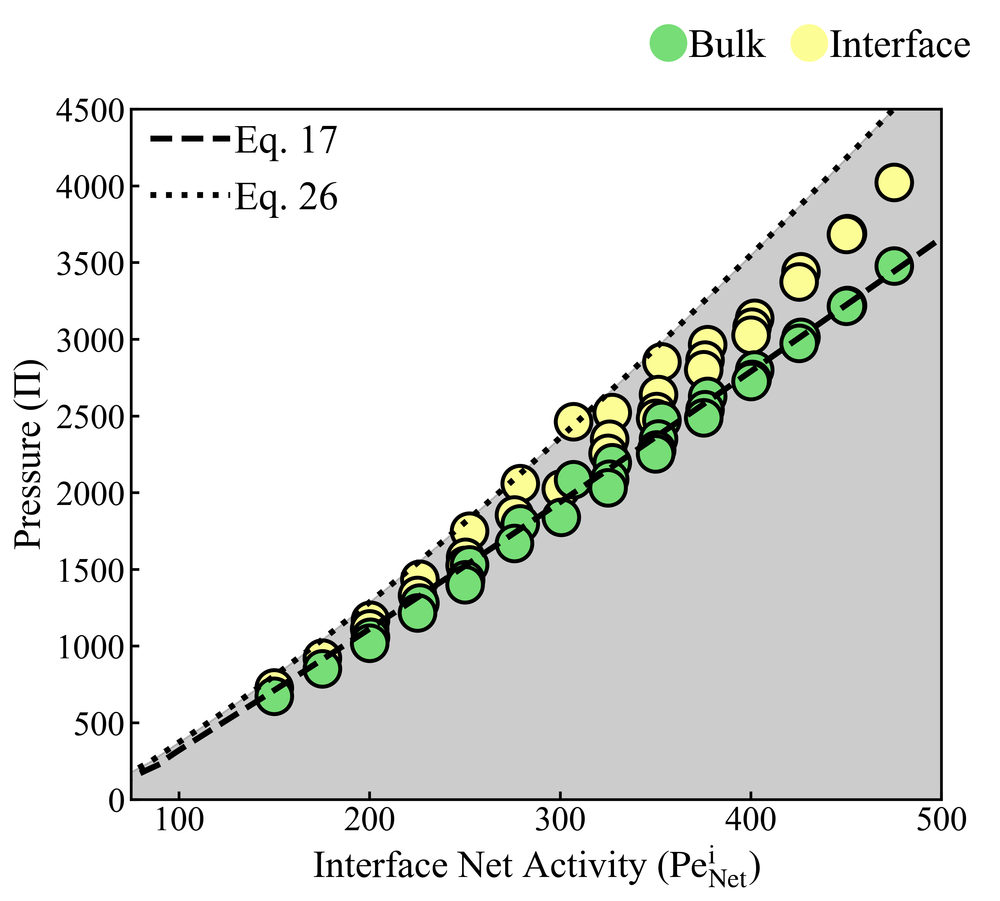

In [89]:
yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
print(len(int_pe_net))
print(len(avg_clust))
nonzero=np.where(interpart_peA>100)[0]


fig, ax1 = plt.subplots(figsize=(8,7))
fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=fastCol,
                      markerfacecolor='None', 
                      label='Fast Interface', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='purple',
                      markerfacecolor='None', 
                      label='Homogeneous', markersize=(2.4*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor=slowCol,
                      markerfacecolor='None', 
                      label='Slow Interface', markersize=(2.4*msz * mkSz[0])))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, clust_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_clust[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_clust[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_clust[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 50000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()




fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, width_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], avg_width[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
plt.scatter(interpart_peA[nonzero], avg_width[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2,s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 35])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width ($h$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Slow Activity ($\mathrm{Pe}_\mathrm{S}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, width_theory2/lat_theory_mean_int_theory, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_width[fast]/all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_width[nonzero]/all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_width[slow]/all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 40])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Interface Width:Lattice Spacing ($h/a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, lat_theory_mean_int_theory, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], all_lat_time_mean[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], all_lat_time_mean[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], all_lat_time_mean[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 1.2])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Lattice Spacing ($a$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 13', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, rad_theory2, color='black', linestyle='dashed', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_rad[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], avg_rad[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], avg_rad[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net, avg_area2 * (np.pi/4), edgecolor=green, facecolor=green, s=msz*55*0.7)

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 120])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Cluster Radius ($r_\mathrm{c}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
mkSz = [0.8, 0.8]
msz=10


leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 15', markerfacecolor='none', markersize=msz, ls='dashed')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)


plt.show()
    
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(int_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Area Fraction ($\phi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
plt.scatter(gas_pe_net[nonzero], phi_gas_sim[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(gas_pe_net[nonzero], avg_area2[nonzero] * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 1.6])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Avg Area Fraction ($\phi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Phase Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i/g}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#####plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(gas_pe_net, fast_frac_gas, edgecolor='red',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Fast')
plt.scatter(gas_pe_net, slow_frac_gas, edgecolor='blue',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Slow')
'''
#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(int_pe_net, fast_frac_int, edgecolor='red',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Fast')
plt.scatter(int_pe_net, slow_frac_int, edgecolor='blue',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Slow')
'''
'''
plt.scatter(int_pe_net, fast_frac_bulk, edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Fast')
plt.scatter(int_pe_net, slow_frac_bulk, edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Slow')
'''
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_dense[nonzero], edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_dense[nonzero], edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Slow')

plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_gas[nonzero], edgecolor='red',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_gas[nonzero], edgecolor='blue',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Slow')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#####plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(gas_pe_net, avg_area2 * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.,1.0])
ax1.set_ylim([0, 1.0])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Particle Fraction per Phase ($\chi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

msz=20
# With fill
mk='s'
med = 1.5
slow_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='red',
                      markerfacecolor='none',
                      label='Fast', markersize=(2.4*msz * mkSz[0])))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='blue',
                      markerfacecolor='none',
                      label='Slow', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]




one_leg = ax1.legend(handles=slow_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.81, 1.1],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.8, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#####plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(gas_pe_net, fast_frac_gas, edgecolor='red',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Fast')
plt.scatter(gas_pe_net, slow_frac_gas, edgecolor='blue',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Slow')
'''
#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(int_pe_net, fast_frac_int, edgecolor='red',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Fast')
plt.scatter(int_pe_net, slow_frac_int, edgecolor='blue',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Slow')
'''
'''
plt.scatter(int_pe_net, fast_frac_bulk, edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Fast')
plt.scatter(int_pe_net, slow_frac_bulk, edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Slow')
'''
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_bulk[nonzero], edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_bulk[nonzero], edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Slow')

plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_int[nonzero], edgecolor='red',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_int[nonzero], edgecolor='blue',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Slow')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#####plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(gas_pe_net, avg_area2 * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.,1.0])
ax1.set_ylim([0, 1.0])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Particle Fraction per Phase ($\chi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

msz=20
# With fill
mk='s'
med = 1.5
slow_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='red',
                      markerfacecolor='none',
                      label='Fast', markersize=(2.4*msz * mkSz[0])))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='blue',
                      markerfacecolor='none',
                      label='Slow', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]



one_leg = ax1.legend(handles=slow_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.81, 1.1],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.8, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#####plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(gas_pe_net, fast_frac_gas, edgecolor='red',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Fast')
plt.scatter(gas_pe_net, slow_frac_gas, edgecolor='blue',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Slow')
'''
#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(int_pe_net, fast_frac_int, edgecolor='red',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Fast')
plt.scatter(int_pe_net, slow_frac_int, edgecolor='blue',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Slow')
'''
'''
plt.scatter(int_pe_net, fast_frac_bulk, edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Fast')
plt.scatter(int_pe_net, slow_frac_bulk, edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Slow')
'''
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_dense[nonzero]/fast_frac_dense[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')

plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_gas[nonzero]/slow_frac_gas[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#####plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(gas_pe_net, avg_area2 * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.,1.0])
ax1.set_ylim([0, 1.0])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Homogeneity ($\chi_\mathrm{minor}/\chi_\mathrm{major}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

msz=20
# With fill
mk='s'
med = 1.5
slow_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='red',
                      markerfacecolor='none',
                      label='Fast', markersize=(2.4*msz * mkSz[0])))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='blue',
                      markerfacecolor='none',
                      label='Slow', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]




one_leg = ax1.legend(handles=slow_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.81, 1.1],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.8, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#####plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(gas_pe_net, fast_frac_gas, edgecolor='red',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Fast')
plt.scatter(gas_pe_net, slow_frac_gas, edgecolor='blue',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Slow')
'''
#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(int_pe_net, fast_frac_int, edgecolor='red',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Fast')
plt.scatter(int_pe_net, slow_frac_int, edgecolor='blue',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Slow')
'''
'''
plt.scatter(int_pe_net, fast_frac_bulk, edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Fast')
plt.scatter(int_pe_net, slow_frac_bulk, edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Slow')
'''
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_bulk[nonzero]/fast_frac_bulk[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_int[nonzero]/fast_frac_int[nonzero], edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')
plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_gas[nonzero]/slow_frac_gas[nonzero], edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.4, label='Fast')

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#####plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(gas_pe_net, avg_area2 * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.,1.0])
#ax1.set_ylim([0, 1.0])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Homogeneity ($\chi_\mathrm{minor}/\chi_\mathrm{major}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))

msz=20
# With fill
mk='s'
med = 1.5
slow_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='red',
                      markerfacecolor='none',
                      label='Fast', markersize=(2.4*msz * mkSz[0])))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='blue',
                      markerfacecolor='none',
                      label='Slow', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]



one_leg = ax1.legend(handles=slow_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.81, 1.1],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.7, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#####plt.plot(int_pe_net_theory, phi_gas_theory2, color='black', linestyle='dotted', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], phi_gas_sim[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(gas_pe_net, fast_frac_gas, edgecolor='red',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Fast')
plt.scatter(gas_pe_net, slow_frac_gas, edgecolor='blue',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Slow')
'''
#plt.scatter(int_pe_net[slow], phi_gas_sim[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Gas Sim')
'''
plt.scatter(int_pe_net, fast_frac_int, edgecolor='red',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Fast')
plt.scatter(int_pe_net, slow_frac_int, edgecolor='blue',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Int Slow')
'''
'''
plt.scatter(int_pe_net, fast_frac_bulk, edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Fast')
plt.scatter(int_pe_net, slow_frac_bulk, edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Bulk Slow')
'''
#plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_int[nonzero], edgecolor='red',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Fast')
#plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_int[nonzero], edgecolor='blue',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Slow')

#plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_bulk[nonzero], edgecolor='red',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Fast')
#plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_bulk[nonzero], edgecolor='blue',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Slow')

plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], fast_frac_gas[nonzero], edgecolor='red',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Fast')
#plt.scatter(interpart_peA[nonzero]/interpart_peB[nonzero], slow_frac_gas[nonzero], edgecolor='blue',facecolor=red,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Slow')
plt.scatter(pe_rat_arr, pe_gas_arr, edgecolor='blue',facecolor='blue',  linewidth = 1.8*1.2, s=msz*55*0.7, label='Theory')
#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
#####plt.plot(int_pe_net_theory, phi_dense_theory2, color='black', linestyle='--', linewidth=1.8*1.8)

#plt.scatter(int_pe_net[fast], avg_area2[fast] * (np.pi/4), edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(gas_pe_net, avg_area2 * (np.pi/4), edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], avg_area2[slow] * (np.pi/4), edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([0.,1.0])
ax1.set_ylim([0, 1.0])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Particle Fraction per Phase ($\chi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Dense', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=red,
                      markerfacecolor=red,
                      label='Gas', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

msz=20
# With fill
mk='s'
med = 1.5
slow_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='red',
                      markerfacecolor='none',
                      label='Fast', markersize=(2.4*msz * mkSz[0])))
slow_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor='blue',
                      markerfacecolor='none',
                      label='Slow', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 8', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 12', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.7, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)

one_leg = ax1.legend(handles=slow_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.08],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')

#plt.scatter(int_pe_net[fast], 100*(phi_gas_sim[fast]-phi_gas_theory[fast])/phi_gas_theory[fast], edgecolor=fastCol,facecolor=red,  linewidth = 1.8*1.2, s=25.0, label='Gas Sim')
plt.scatter(int_pe_net, 100*(phi_gas_sim-phi_gas_theory)/phi_gas_theory,edgecolor='black',facecolor=red,  linewidth = 1.8*1.2, s=25.0, label='Gas Sim')
#plt.scatter(int_pe_net[slow], 100*(phi_gas_sim[slow]-phi_gas_theory[slow])/phi_gas_theory[slow], edgecolor=slowCol,facecolor=red,  linewidth = 1.8*1.2, s=25.0, label='Gas Sim')

#plt.scatter(int_pe_net[fast], 100*(avg_area2[fast] * (np.pi/4) - phi_dense_theory[fast])/phi_dense_theory[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=25.0, label='Dense Sim')
plt.scatter(int_pe_net, 100*(avg_area2 * (np.pi/4) - phi_dense_theory)/phi_dense_theory, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=25.0, label='Dense Sim')
#plt.scatter(int_pe_net[slow], 100*(avg_area2[slow] * (np.pi/4) - phi_dense_theory[slow])/phi_dense_theory[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=25.0, label='Dense Sim')

ax1.set_xlim([0,500.0])
ax1.set_ylim([-100, 100])
plt.ylabel(r'Avg Area Fraction ($\phi$)')
plt.xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)')
plt.legend(loc = 'upper right')

plt.show()

error = 100*(phi_gas_sim-phi_gas_theory)/phi_gas_theory
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory3)/phi_gas_theory3
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory4)/phi_gas_theory4
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

error = 100*(phi_gas_sim-phi_gas_theory5)/phi_gas_theory5
avg_error = np.mean(error)
sumi=0
for i in range(0, len(error)):
    sumi+= (error[i]-avg_error)**2
std = (sumi/len(error))**0.5
print(avg_error)
print(std)

y_arr_test = np.zeros(len(int_pe_net_final_arr))
fig, ax1 = plt.subplots(figsize=(8,7))
#plt.scatter(int_pe_net, phi_gas_theory2, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.scatter(int_pe_net, phi_gas_theory, edgecolor=red, facecolor='none', s=25.0, label='Gas Theory')
#plt.plot(int_pe_net, avg_int_theory_arr, color='black', linestyle='dotted', linewidth=1.8*1.8)
ax1.fill_between(int_pe_net_final_arr, y_arr_test, press_theory_max_arr, color='black', alpha=0.2)

#plt.scatter(int_pe_net[fast], align_press_arr[fast], edgecolor=fastCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
plt.scatter(int_pe_net[nonzero], align_press_arr[nonzero], edgecolor='black',facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)
#plt.scatter(int_pe_net[slow], align_press_arr[slow], edgecolor=slowCol,facecolor=yellow,  linewidth = 1.8*1.2, s=msz*55*0.7)

#plt.scatter(int_pe_net, phi_dense_theory, edgecolor=green, facecolor='none', s=25.0, label='Dense Theory')
plt.plot(int_pe_net_theory, press_theory2, color='black', linestyle='--', linewidth=1.8*1.8)
#plt.plot(int_pe_net_final_arr, press_theory_min_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
plt.plot(int_pe_net_final_arr, press_theory_max_arr, linestyle='dotted', color='black', linewidth=1.8*1.8)
#plt.scatter(int_pe_net[fast], interpart_press[fast], edgecolor=fastCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(int_pe_net[nonzero], interpart_press[nonzero], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
#plt.scatter(int_pe_net[slow], interpart_press[slow], edgecolor=slowCol,facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

ax1.set_xlim([75.0,500.0])
ax1.set_ylim([0, 4500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Pressure ($\Pi$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Interface Net Activity ($\mathrm{Pe}_\mathrm{Net}^\mathrm{i}$)', fontsize=fsize*2.1)

msz=20
# With fill
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
msz=10
#     eps_leg.append(Line2D([0], [0], lw=0., marker=mk, markeredgewidth=med,
#                           markeredgecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           markerfacecolor=plt.cm.jet((np.log10(myEps[i]) + 4)/ (len(myEps)-1) ),
#                           label=r'$10^{{{}}}$'.format(-i), markersize=msz))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Bulk', markersize=(2.4*msz * mkSz[0])))
eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=yellow,
                      markerfacecolor=yellow,
                      label='Interface', markersize=(2.4*msz * mkSz[0])))

leg_three = [Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 17', markerfacecolor='dashed', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=1.8*1.8, c='k', markeredgecolor='none', label=r'Eq. 26', markerfacecolor='dotted', markersize=msz, ls='dotted')]

two_leg = ax1.legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.3, 1.03],
             fontsize=fsize*2.2, frameon=False, ncol=1)
ax1.add_artist(two_leg)

one_leg = ax1.legend(handles=eps_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.5,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.825, 1.09],
             fontsize=fsize*2.2, frameon=False, ncol=5)
ax1.add_artist(one_leg)



plt.show()


ValueError: x and y must be the same size

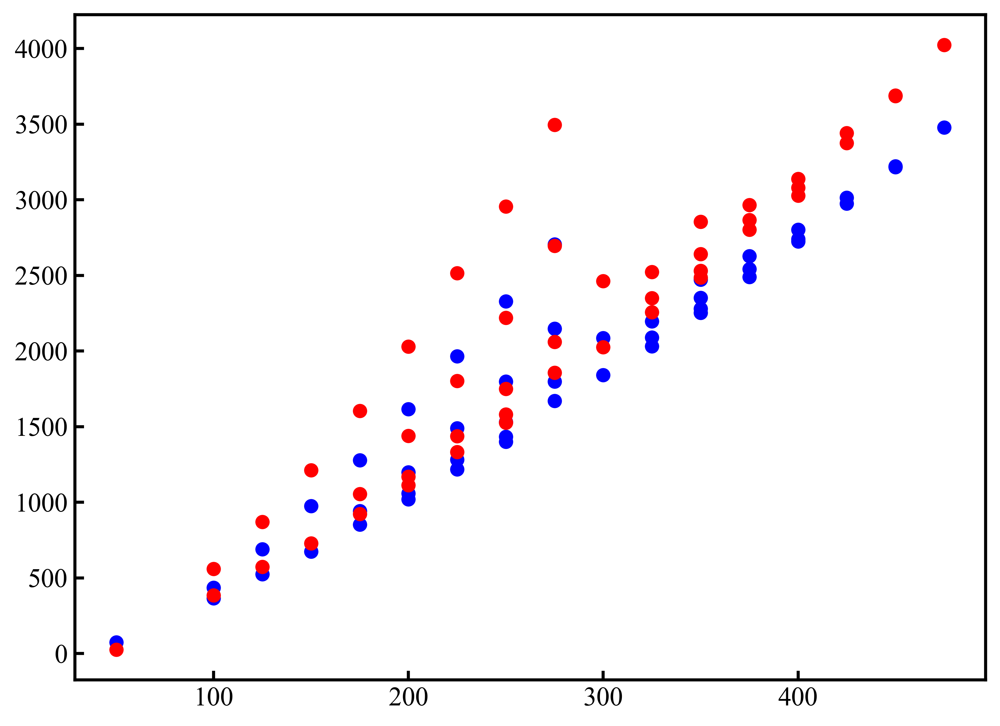

In [89]:
plt.figure(figsize=(8,6))
plt.scatter(interpart_peNet, interpart_press, c='blue', label='bulk interparticle')
plt.scatter(align_peNet, align_press_arr, c='red', label='aligned interface')
plt.scatter(interpart_peNet, avg_int_theory_arr, c='yellow', label='theory int')
plt.scatter(interpart_peNet, avg_bulk_theory_arr, c='green', label='theory bulk')
plt.ylabel(r'Pressure ($\Pi$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Net}$')
plt.legend()
plt.show()

plt.figure(figsize=(8,6))
plt.scatter(int_pe_net, interpart_press, c='blue', label='bulk interparticle')
plt.scatter(int_pe_net, align_press_arr, c='red', label='aligned interface')
plt.scatter(int_pe_net, avg_int_theory_arr, c='yellow', label='theory int')
plt.scatter(int_pe_net, avg_bulk_theory_arr, c='green', label='theory bulk')
plt.ylabel(r'Pressure ($\Pi$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Net}$')
plt.legend()
plt.show()

import matplotlib
fig = plt.figure(figsize=(8,6))
im = plt.scatter(int_pe_net, interpart_press, c=pe_dif_arr, cmap='viridis', vmin=np.min(pe_dif_arr), vmax=np.max(pe_dif_arr))
norm= matplotlib.colors.Normalize(vmin=np.min(pe_dif_arr), vmax=np.max(pe_dif_arr))

sm = plt.cm.ScalarMappable(norm=norm, cmap = im.cmap)
sm.set_array([])
clb = fig.colorbar(sm)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}-\mathrm{Pe}_\mathrm{S}$', fontsize=15)
plt.xlim(0, 500)
plt.ylim(0, 3500)
plt.ylabel(r'Pressure ($\Pi_\mathrm{d}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Net}^\mathrm{int}$')
plt.tight_layout()
plt.show()

fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111)
im = plt.scatter(int_pe_net, align_press_arr, c=pe_dif_arr, cmap='viridis', vmin=np.min(pe_dif_arr), vmax=np.max(pe_dif_arr))
norm= matplotlib.colors.Normalize(vmin=np.min(pe_dif_arr), vmax=np.max(pe_dif_arr))
sm = plt.cm.ScalarMappable(norm=norm, cmap = im.cmap)
sm.set_array([])
clb = fig.colorbar(sm)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}-\mathrm{Pe}_\mathrm{S}$', fontsize=15)
            
plt.xlim(0, 500)
plt.ylim(0, 3500)

#plt.ylim(0, l_box)
#plt.axis('off')
plt.ylabel(r'Pressure ($\Pi_\mathrm{int}$)')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Net}^\mathrm{int}$')
plt.tight_layout()
plt.show()

fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111)
im = plt.scatter(int_pe_net, ((align_press_arr-interpart_press)/interpart_press)*100, c='black')
 
plt.xlim(0, 500)
plt.ylim(-100, 100)

#plt.ylim(0, l_box)
#plt.axis('off')
plt.ylabel(r'$100(\Pi_d - \Pi_i)/\Pi_i$')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Net}^\mathrm{int}$')

# Make a simulation vs theory legend
leg_three = [Line2D([0], [0], lw=med*1.8, c='k', markeredgecolor='none', label=r'Eq. 6', markerfacecolor='none', markersize=msz, ls='dashed'),
             Line2D([0], [0], lw=med*1.8, c='k', markeredgecolor='none', label=r'Eq. 7', markerfacecolor='none', markersize=msz, ls='dotted')]

two_leg = ax[0].legend(handles=leg_three, loc='upper right',
             columnspacing=1., handletextpad=0.1,
             bbox_transform=ax[0].transAxes, bbox_to_anchor=[1.0, 1.03],
             fontsize=fsize*3.2, frameon=False, ncol=1)
ax[0].add_artist(two_leg)

plt.tight_layout()
plt.show()

fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111)
plt.scatter(int_pe_net, ((interpart_press-avg_bulk_theory_arr)/avg_bulk_theory_arr)*100, c=green, label='bulk')
plt.scatter(int_pe_net, ((align_press_arr-avg_int_theory_arr)/avg_int_theory_arr)*100, c=yellow, label='interface')

plt.xlim(0, 500)
plt.ylim(-100, 100)

#plt.ylim(0, l_box)
#plt.axis('off')
plt.ylabel(r'$100(\Pi_\mathrm{sim} - \Pi_\mathrm{theory})/\Pi_\mathrm{theory}$')
plt.xlabel(r'$\mathrm{Pe}_\mathrm{Net}^\mathrm{int}$')
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()